# LightGBM SIMPLE MODELS
This notebook presents the code corresponding to the training of the LightGBM model without covariates from Darts. Two models have been trained, one with MinMax scaling and the other with Standard scaling.

After training, both models are evaluated using their respective test sets, and the MinMax model is also evaluated with the specific test set.

In [ ]:
# We install darts
!pip install u8darts[torch] --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.4/57.4 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.6/200.6 kB 10.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.1/823.1 kB 30.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.4/354.4 kB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 79.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 30.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 44.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 775.9 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Necessary imports
import pandas as pd
import zipfile
import os
import numpy as np
import matplotlib.pyplot as plt
import joblib
from darts import TimeSeries
from darts.models import LightGBMModel
from darts.dataprocessing.transformers import Scaler
from darts import concatenate, metrics

# We can ignore Darts library warnings
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load the saved data
loaded_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_train_standard.pkl')

# We extract the components
scaled_train_series = loaded_data['train']        # dict of TimeSeries objects
scaled_val_series = loaded_data['validation']     # dict of TimeSeries objects
scalers = loaded_data['scalers']                  # dict of Scaler objects

# We sort by meter IDs
meter_ids = sorted(scaled_train_series.keys())

# We build aligned lists
train_series_scaled = [scaled_train_series[meter_id] for meter_id in meter_ids]
val_series_scaled = [scaled_val_series[meter_id] for meter_id in meter_ids]

print(f"Loaded {len(train_series_scaled)} time series for training.")
print(f"Loaded {len(val_series_scaled)} time series for validation.")

Loaded 908 time series for training.
Loaded 908 time series for validation.


In [ ]:
model = LightGBMModel(
    lags=list(range(-1, -61, -1)),    # Uses the last 60 days
    output_chunk_length=7,            # Forecast the next 7 days
    likelihood="quantile",            # Quantile regression
    quantiles=[0.05, 0.5, 0.95],
    random_state=42,
    n_estimators=300,
    num_leaves=31,
    max_depth=7,
    force_col_wise=True,
    verbosity=1,
    n_jobs=-1,
    early_stopping_rounds=30

)

In [ ]:
model.fit(
    train_series_scaled,
    val_series=val_series_scaled
)


[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30
[LightGBM] [Info] Total Bins 15300
[LightGBM] [Info] Number of data points in the train set: 271492, number of used features: 60
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30
[LightGBM] [Info] Start training from score -1.789513
Training until validation scores don't improve for 30 rounds
Early stopping, best iteration is:
[122]	valid_0's quantile: 0.0607719
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30
[LightGBM] [Info] Total Bins 15300
[LightGBM] [Info] Number of data points in the train set: 271492, number of used features: 60
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30
[LightGBM] [Info] St

LightGBMModel(lags=[-1, -2, -3, -4, -5, -6, -7, -8, -9, -10, -11, -12, -13, -14, -15, -16, -17, -18, -19, -20, -21, -22, -23, -24, -25, -26, -27, -28, -29, -30, -31, -32, -33, -34, -35, -36, -37, -38, -39, -40, -41, -42, -43, -44, -45, -46, -47, -48, -49, -50, -51, -52, -53, -54, -55, -56, -57, -58, -59, -60], lags_past_covariates=None, lags_future_covariates=None, output_chunk_length=7, output_chunk_shift=0, add_encoders=None, likelihood=quantile, quantiles=[0.05, 0.5, 0.95], random_state=42, multi_models=True, use_static_covariates=True, categorical_past_covariates=None, categorical_future_covariates=None, categorical_static_covariates=None, n_estimators=300, num_leaves=31, max_depth=7, force_col_wise=True, verbosity=1, n_jobs=-1, early_stopping_rounds=30)

In [ ]:
# Save model
model.save("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/lightGBM/simple/lightgbm_model_standard.pkl")

In [ ]:
###################################### TRAINING DONE, NOW WE WILL TEST THE MODELS #################################

# We start with the Min Max 0-1 Scaling

In [ ]:
# Load model
model = LightGBMModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/lightGBM/simple/lightgbm_model.pkl")

# We load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test.pkl')

# Extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

Loaded 60 time series for testing.


In [ ]:
import pandas as pd

# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])


    # We backtest (evaluate) the generated predictions
    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": bt[1], "Width rescaled": mean_width})

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


historical forecasts: 100%|██████████| 1/1 [00:00<00:00, 27.22it/s]


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()
mean_width_rescaled = combined_results["Width rescaled"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")
print(f"Mean Width rescaled: {mean_width_rescaled:.4f}")

Mean Coverage: 0.8357
Mean Width: 0.2753
Mean Width rescaled: 5.7036


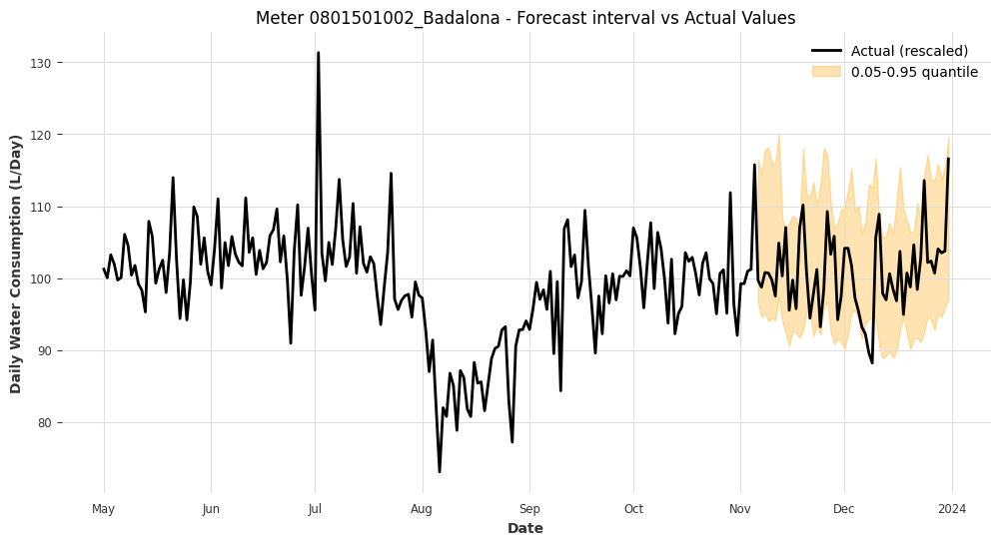

Meter 0801501002_Badalona - Coverage: 0.8750, Width: 18.6726



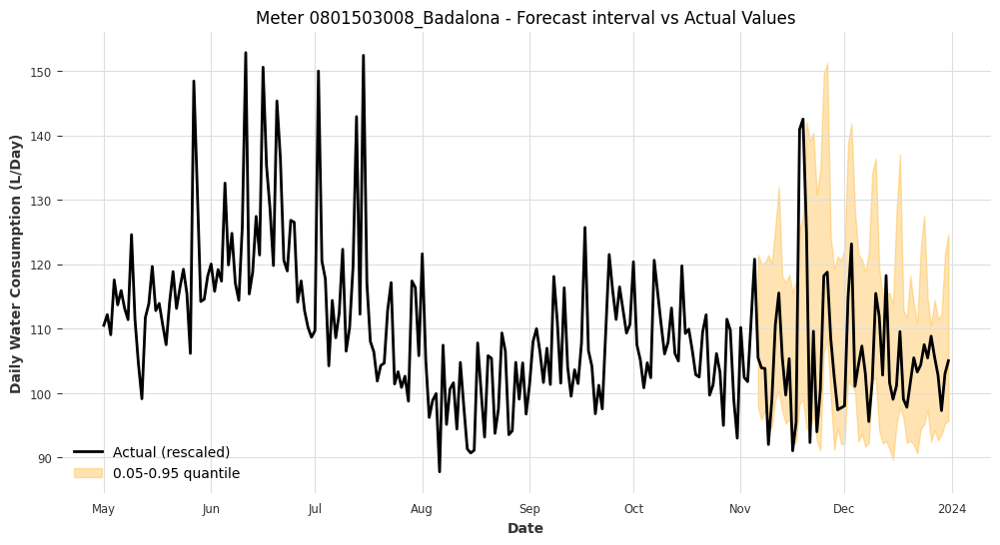

Meter 0801503008_Badalona - Coverage: 0.8750, Width: 28.2400



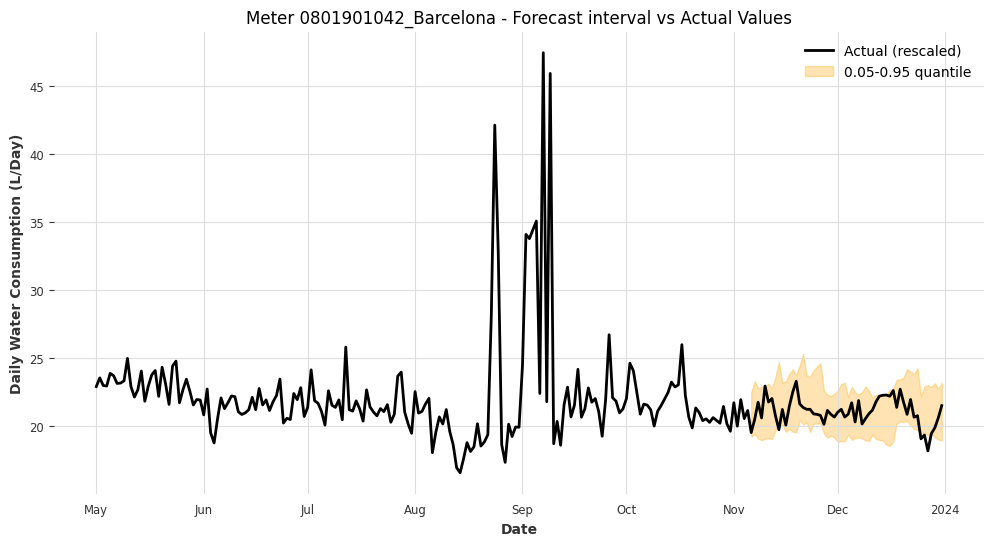

Meter 0801901042_Barcelona - Coverage: 0.9107, Width: 3.7139



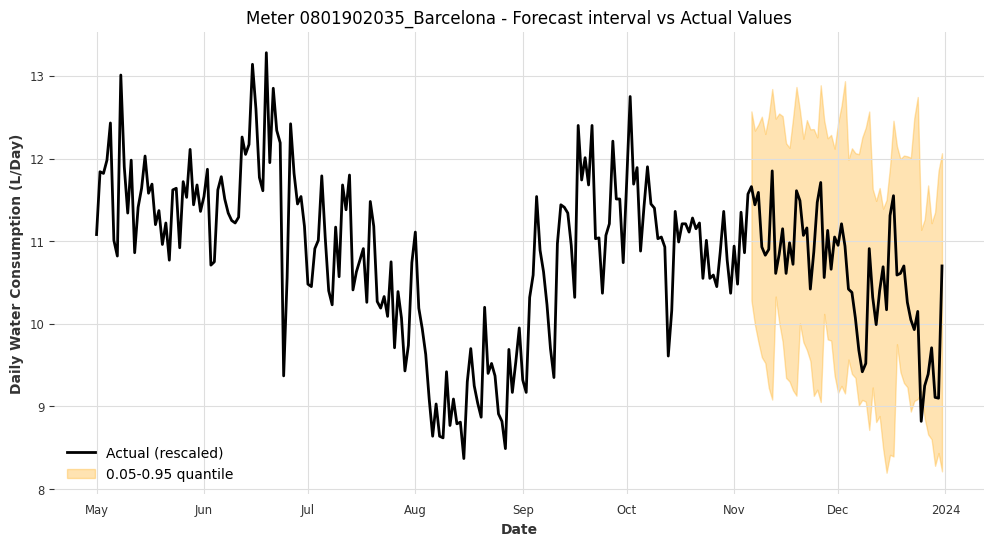

Meter 0801902035_Barcelona - Coverage: 0.9821, Width: 2.9479



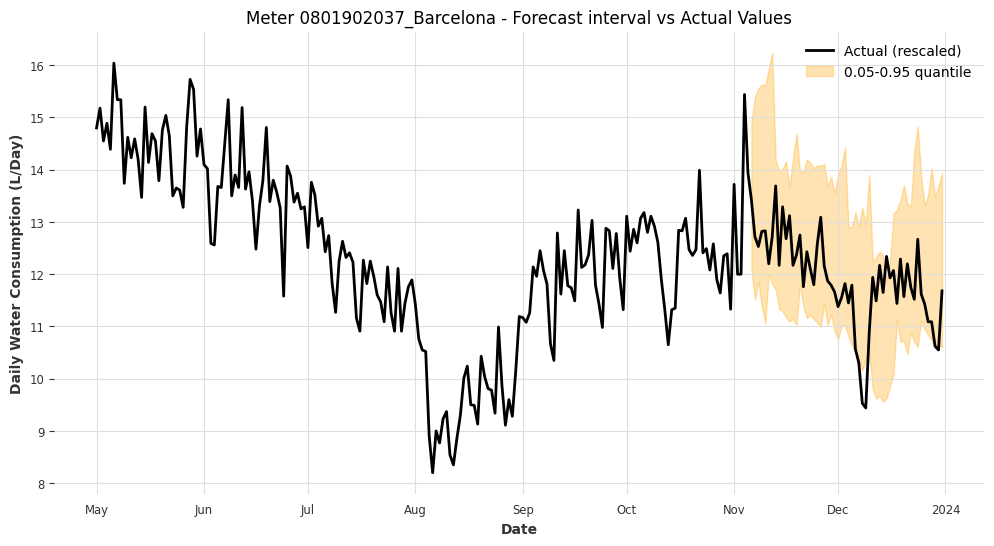

Meter 0801902037_Barcelona - Coverage: 0.9107, Width: 2.9647



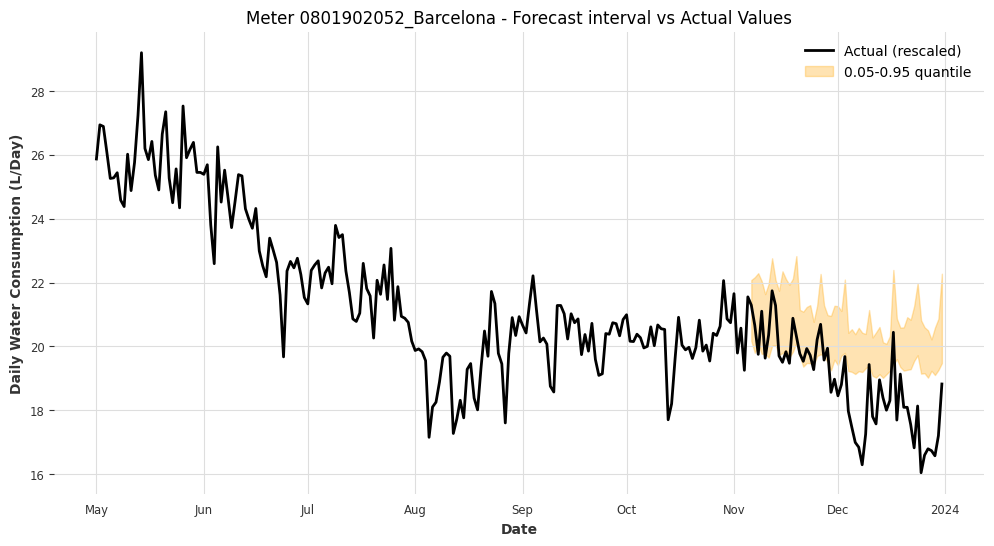

Meter 0801902052_Barcelona - Coverage: 0.3036, Width: 1.7484



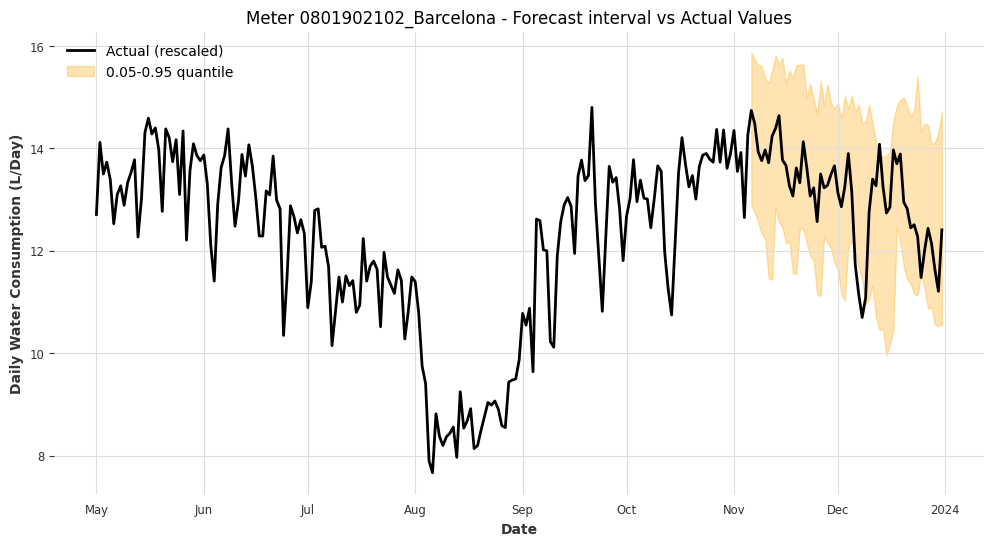

Meter 0801902102_Barcelona - Coverage: 0.9107, Width: 3.3372



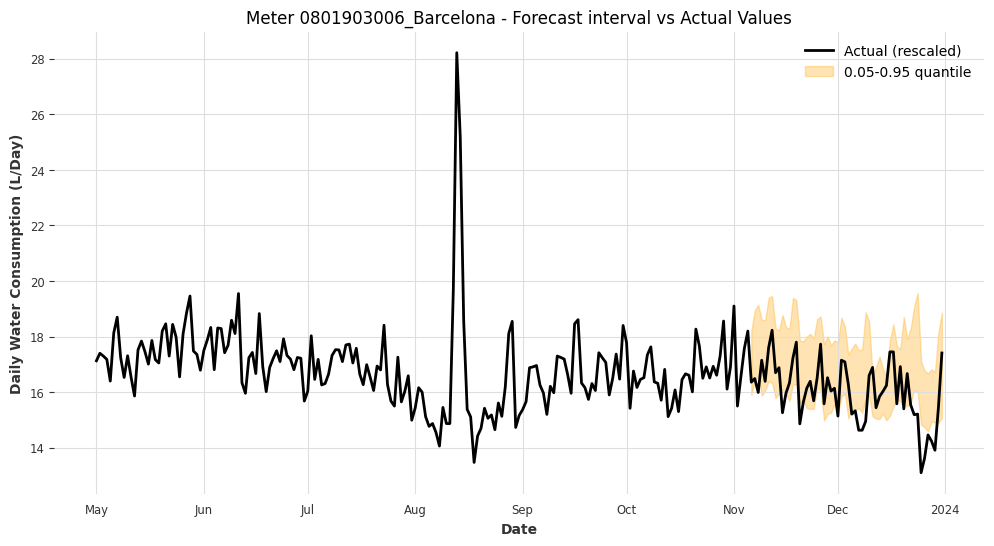

Meter 0801903006_Barcelona - Coverage: 0.6071, Width: 2.5019



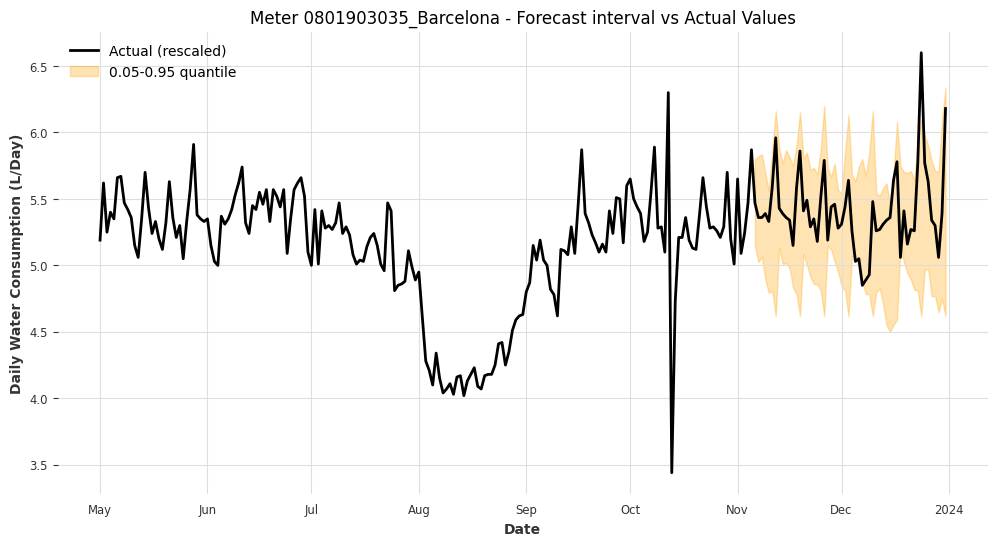

Meter 0801903035_Barcelona - Coverage: 0.9286, Width: 0.9502



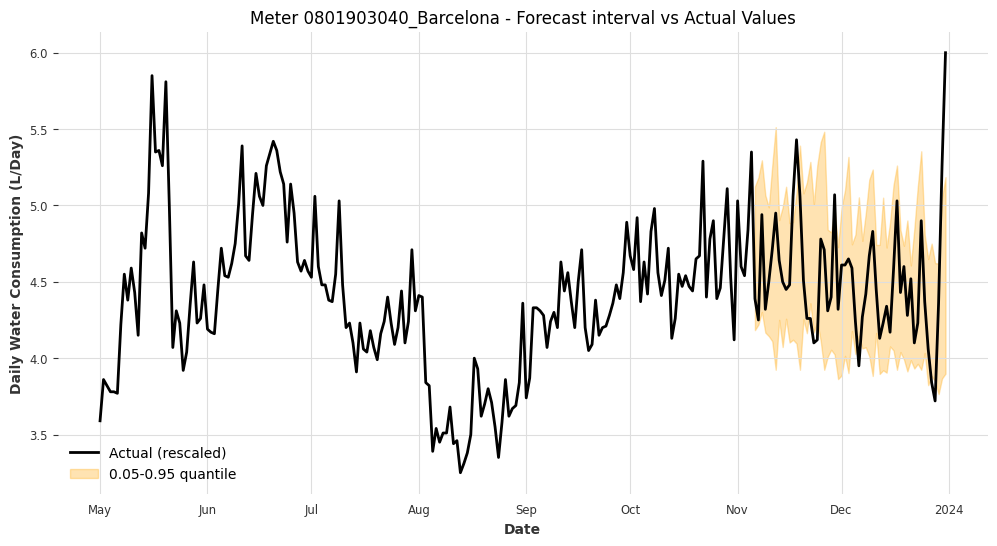

Meter 0801903040_Barcelona - Coverage: 0.8036, Width: 0.9726



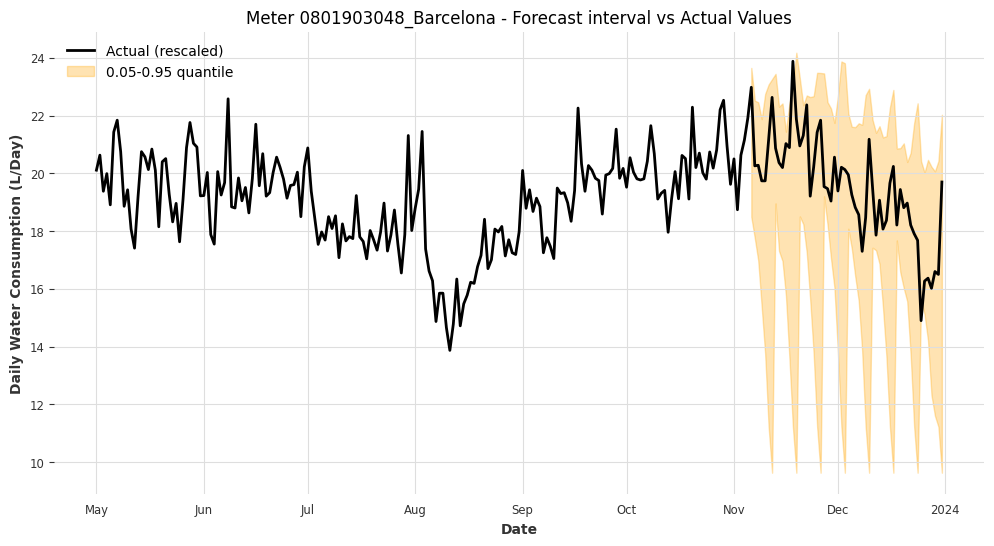

Meter 0801903048_Barcelona - Coverage: 0.9643, Width: 7.6463



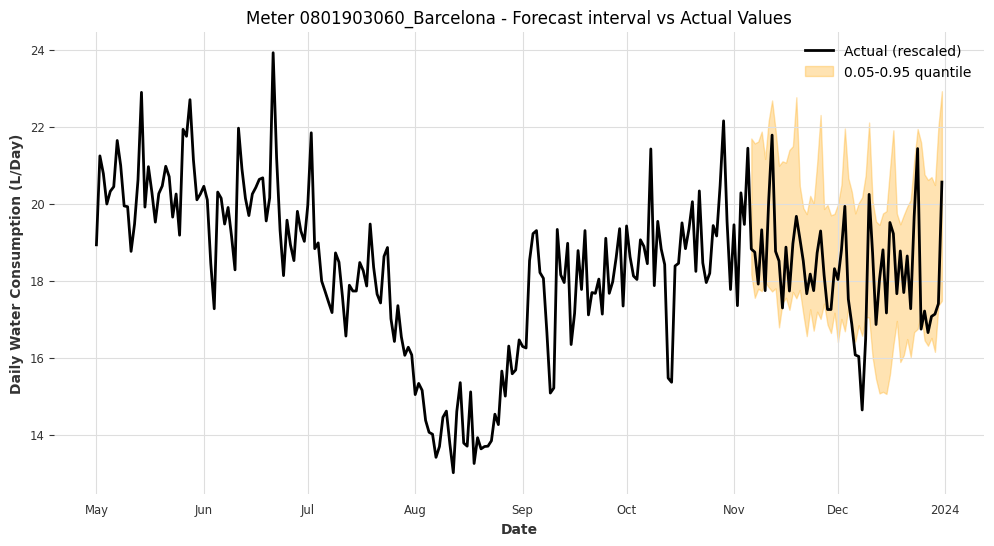

Meter 0801903060_Barcelona - Coverage: 0.8750, Width: 3.9552



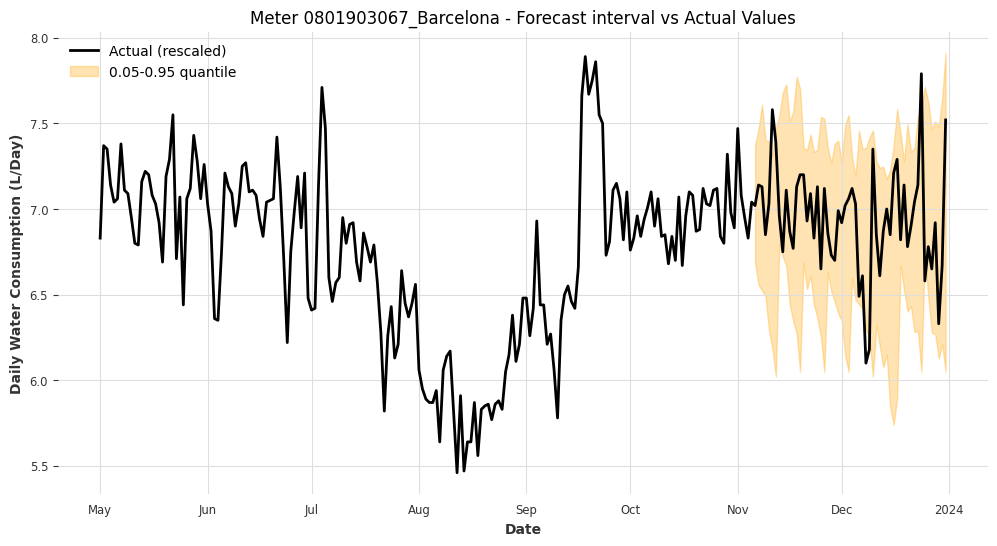

Meter 0801903067_Barcelona - Coverage: 0.9107, Width: 1.1096



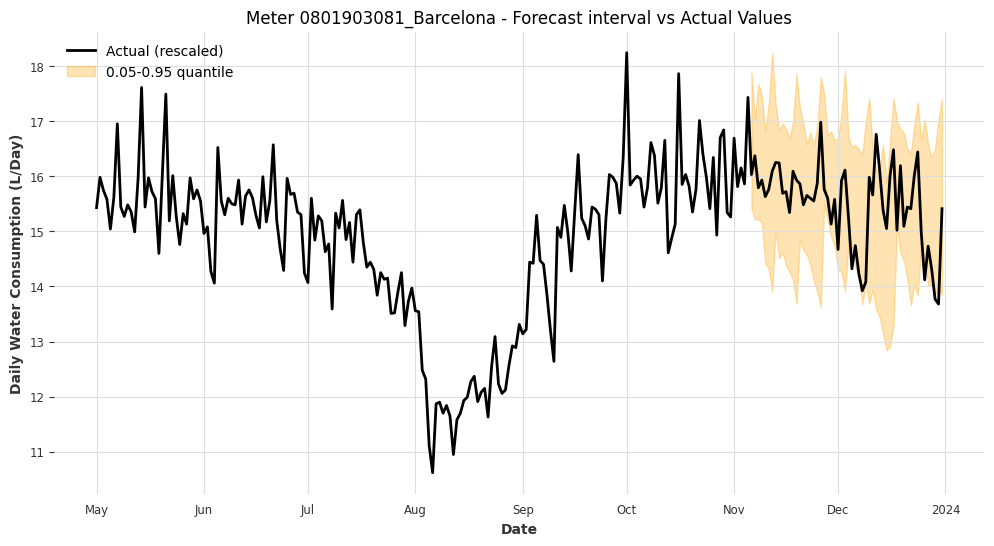

Meter 0801903081_Barcelona - Coverage: 0.8750, Width: 2.6648



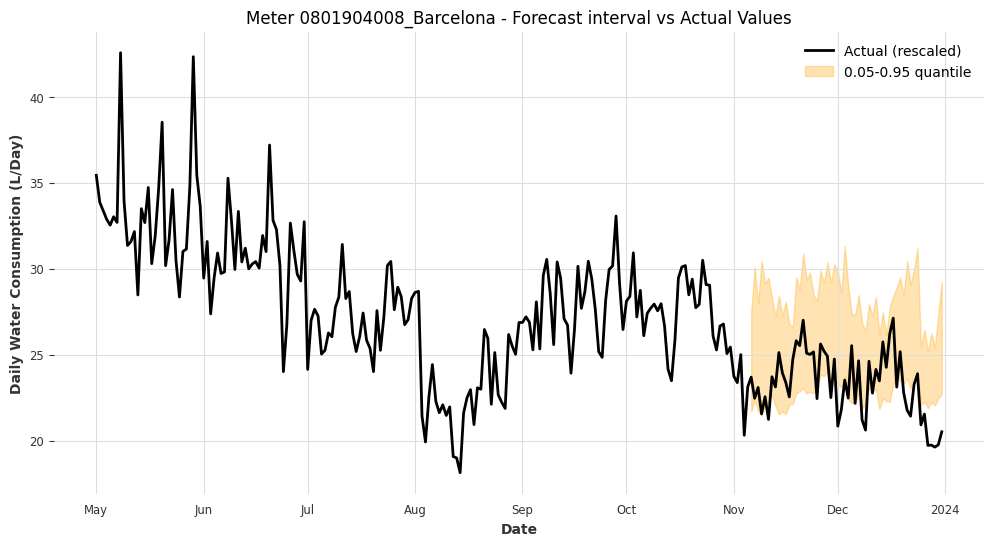

Meter 0801904008_Barcelona - Coverage: 0.6071, Width: 5.7032



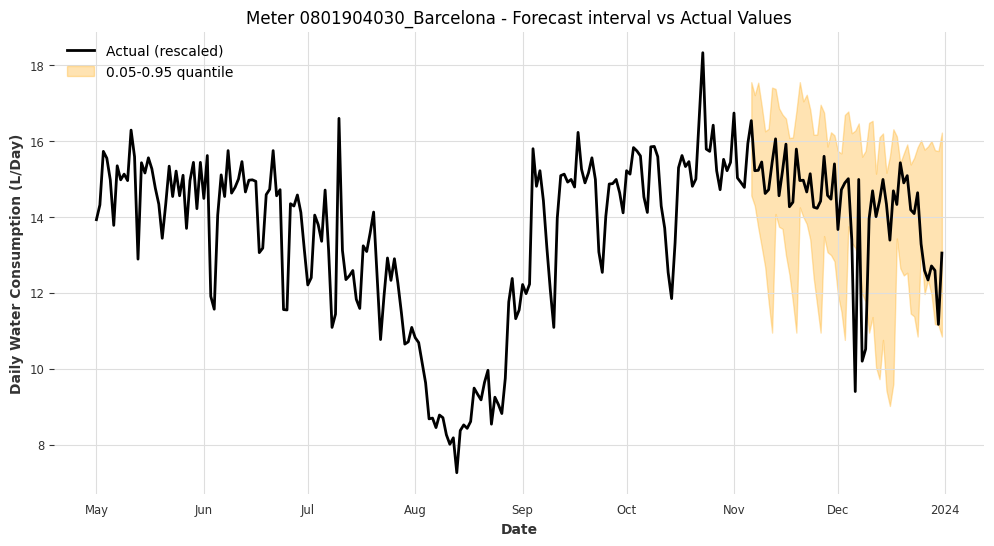

Meter 0801904030_Barcelona - Coverage: 0.9107, Width: 4.0967



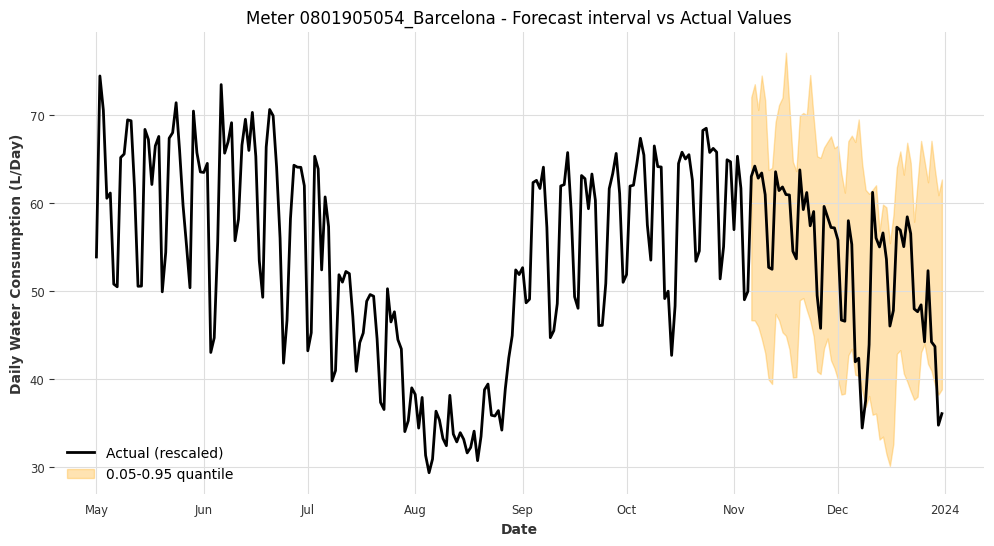

Meter 0801905054_Barcelona - Coverage: 0.9464, Width: 24.7288



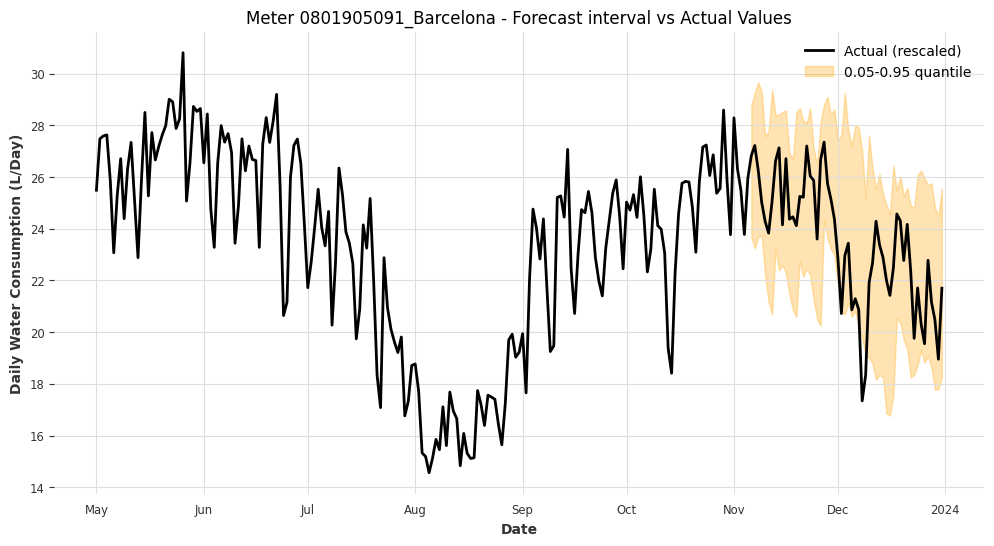

Meter 0801905091_Barcelona - Coverage: 0.9464, Width: 6.5724



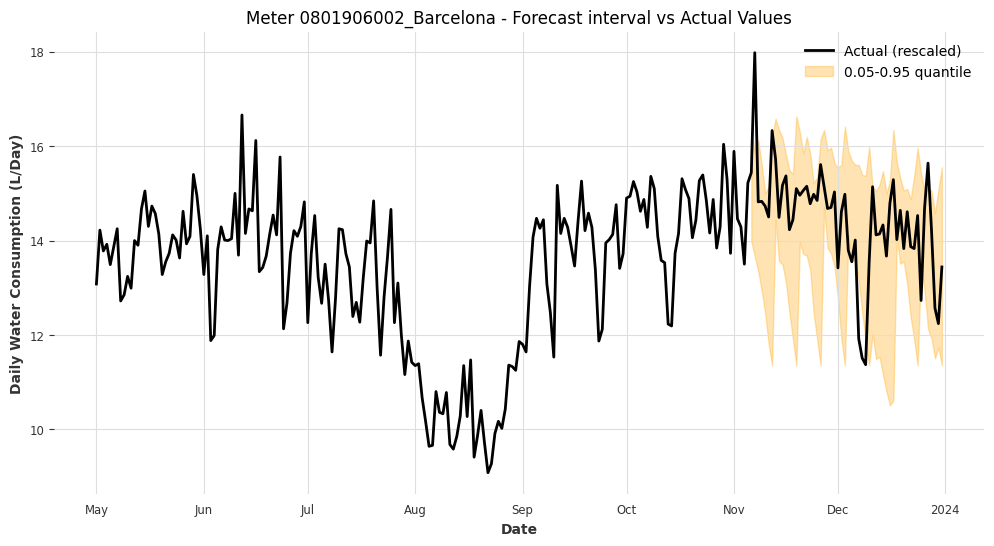

Meter 0801906002_Barcelona - Coverage: 0.8214, Width: 3.0338



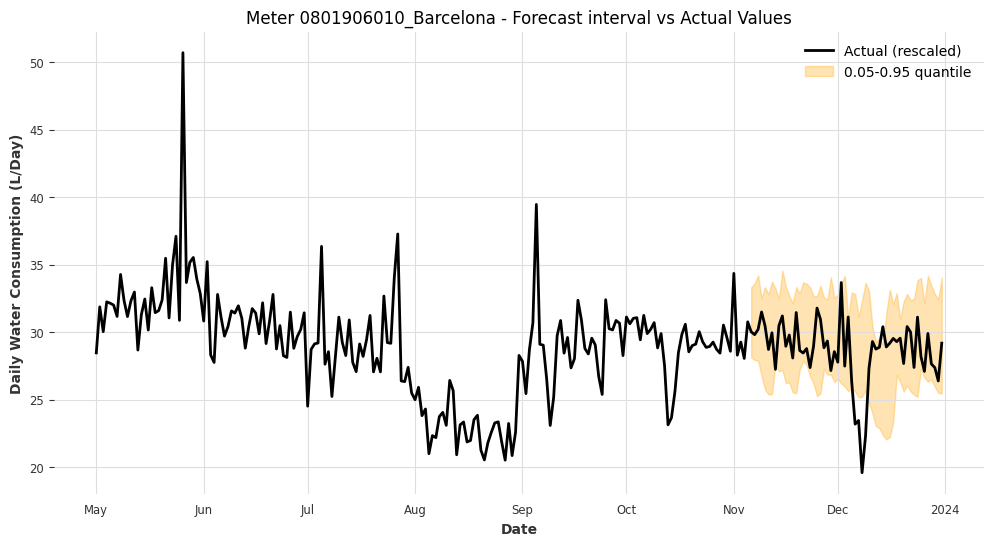

Meter 0801906010_Barcelona - Coverage: 0.8571, Width: 6.8756



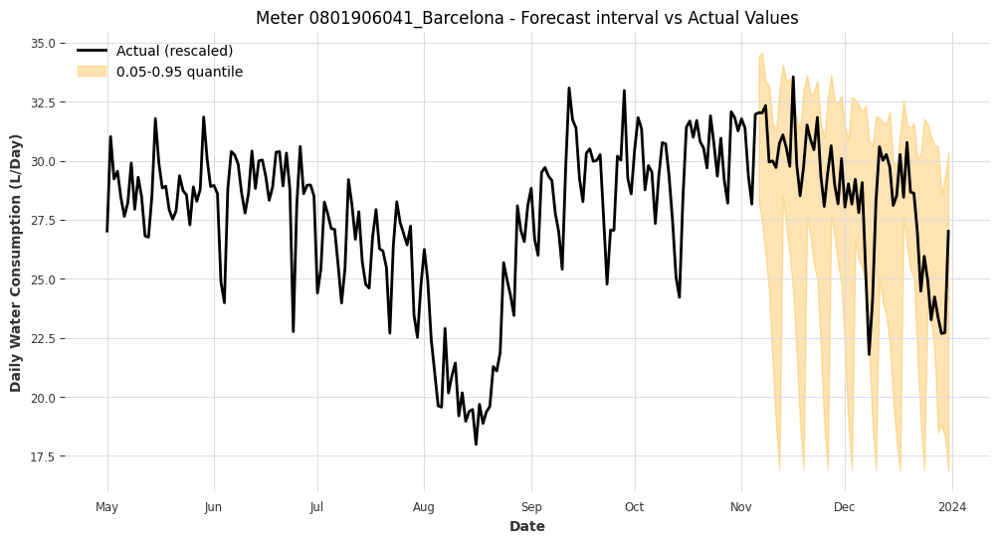

Meter 0801906041_Barcelona - Coverage: 0.9643, Width: 9.3207



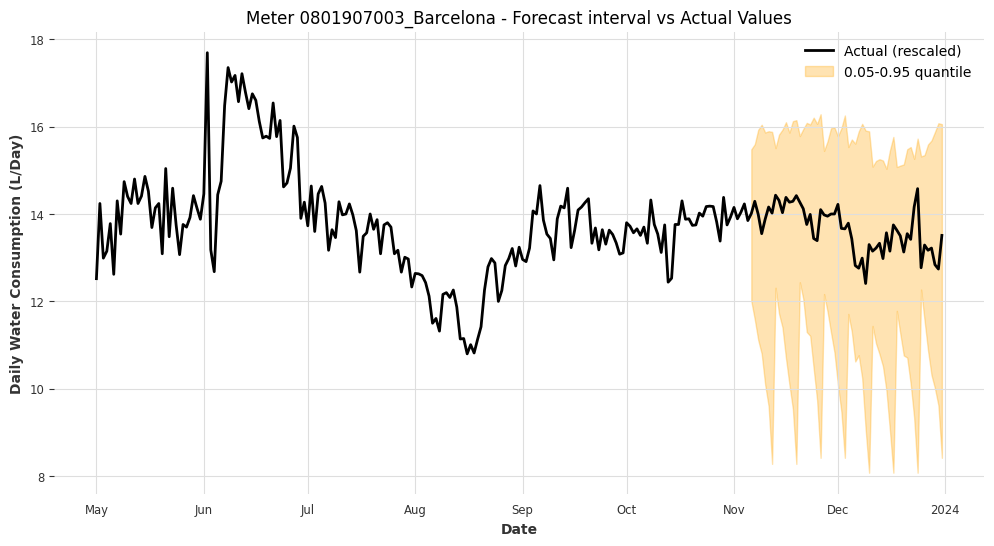

Meter 0801907003_Barcelona - Coverage: 1.0000, Width: 5.2747



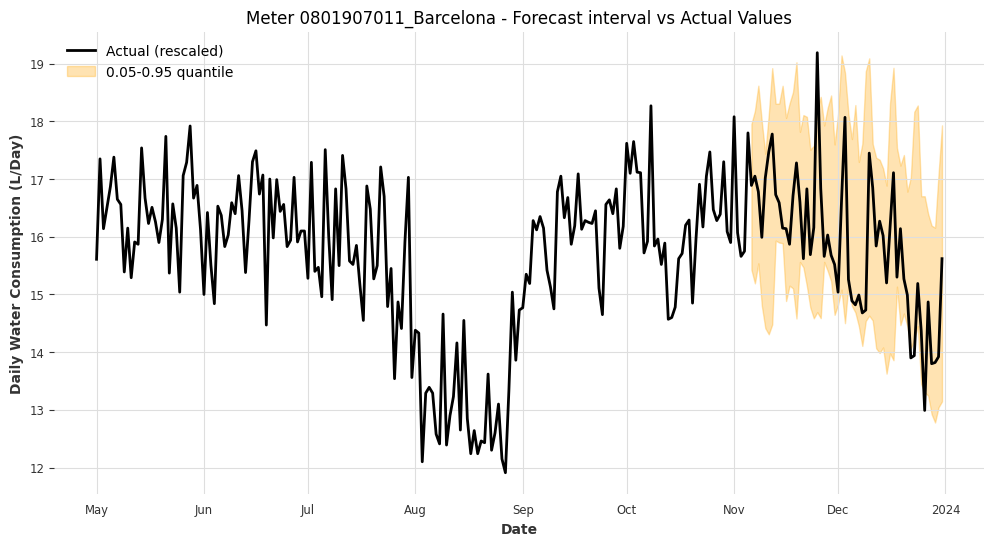

Meter 0801907011_Barcelona - Coverage: 0.9286, Width: 3.3037



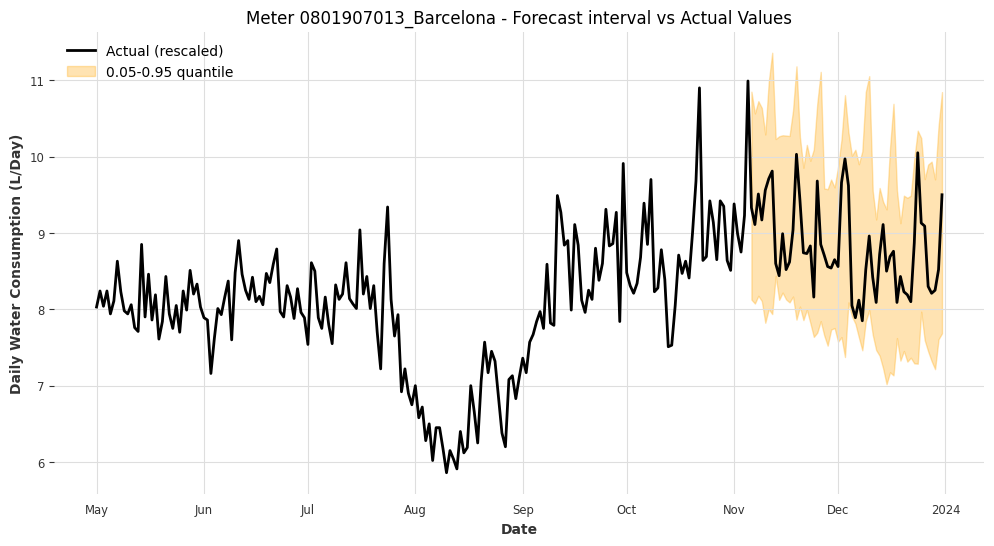

Meter 0801907013_Barcelona - Coverage: 1.0000, Width: 2.4368



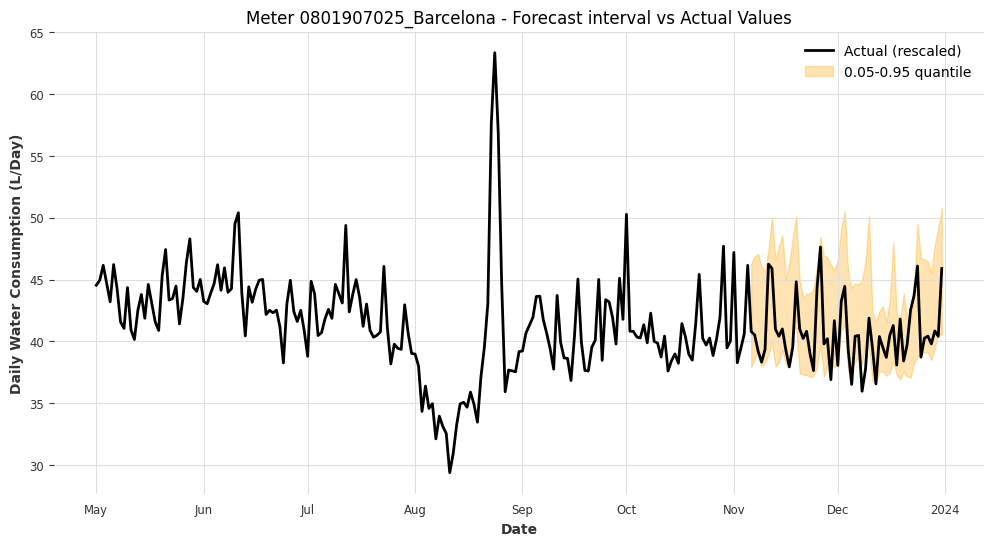

Meter 0801907025_Barcelona - Coverage: 0.7857, Width: 7.4688



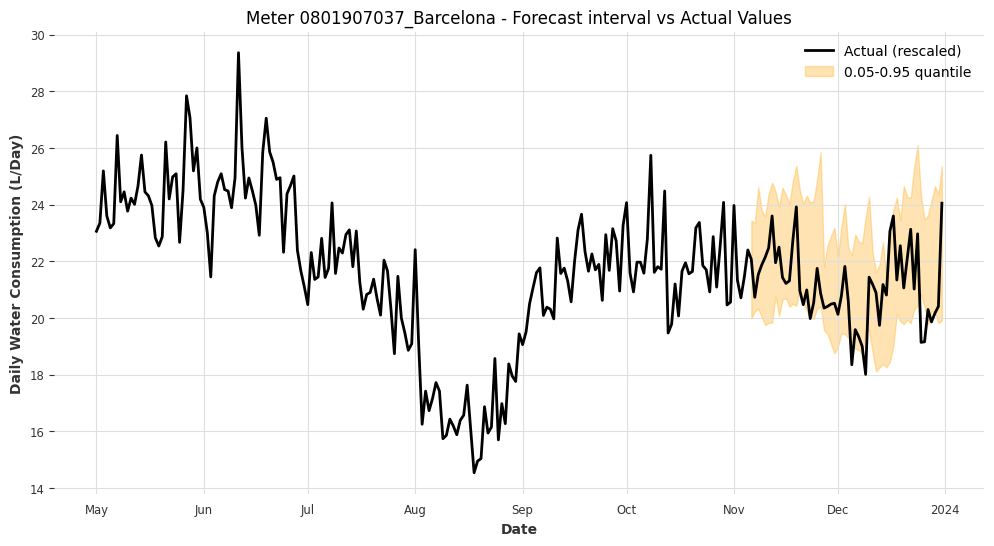

Meter 0801907037_Barcelona - Coverage: 0.8214, Width: 4.0133



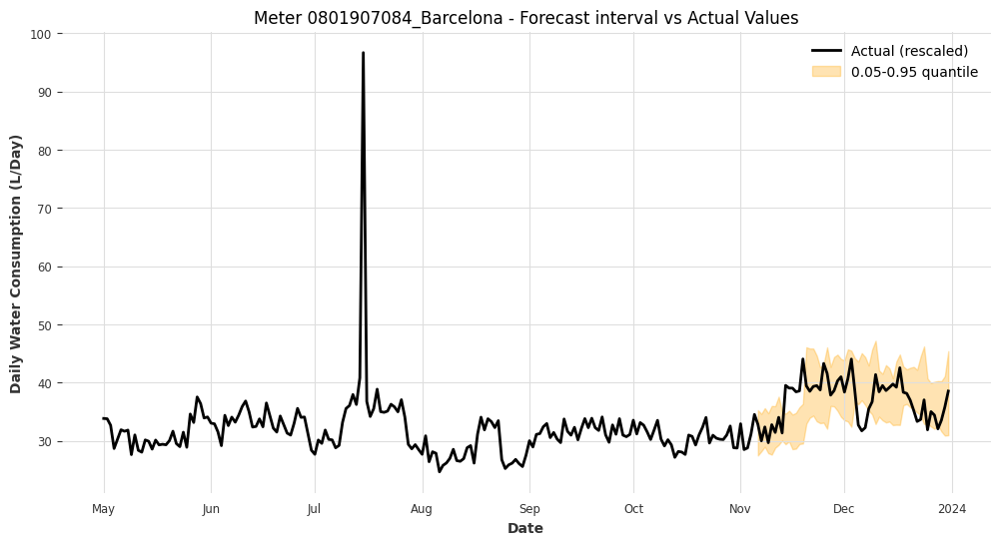

Meter 0801907084_Barcelona - Coverage: 0.7321, Width: 8.8527



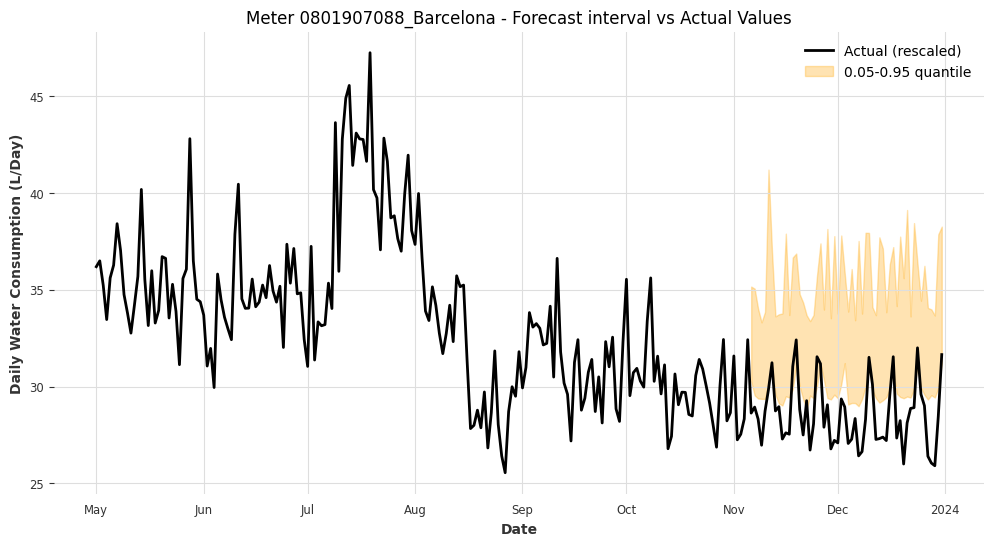

Meter 0801907088_Barcelona - Coverage: 0.1964, Width: 5.8507



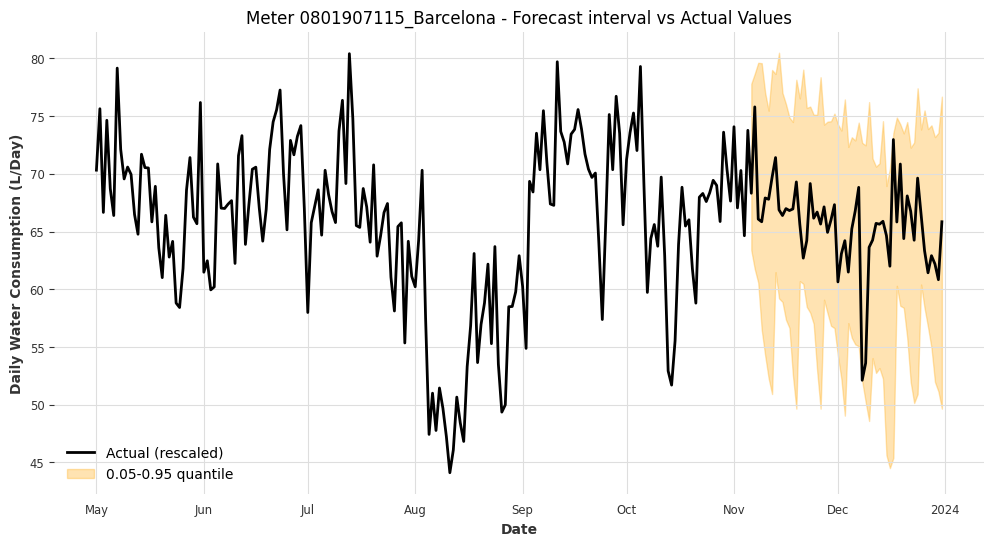

Meter 0801907115_Barcelona - Coverage: 1.0000, Width: 20.1892



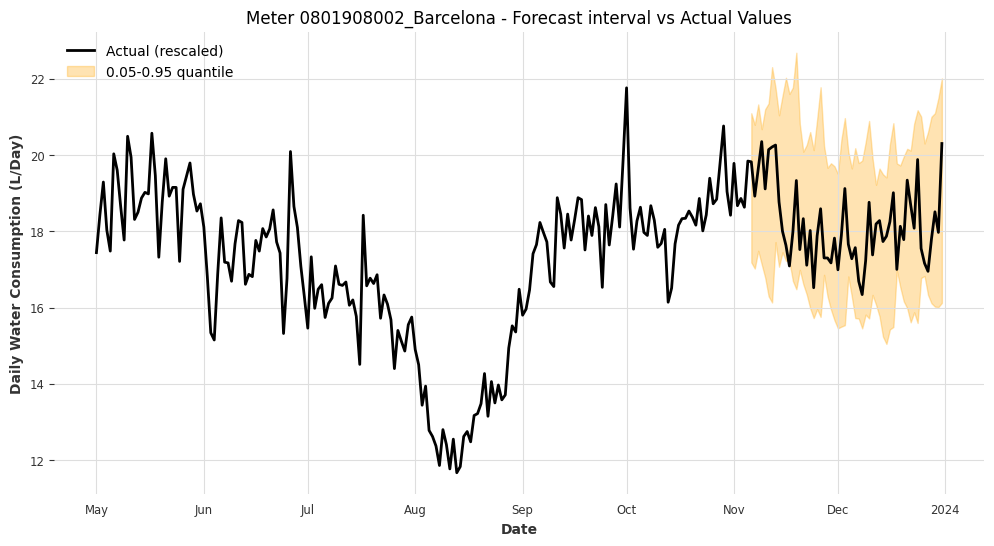

Meter 0801908002_Barcelona - Coverage: 0.9821, Width: 4.3649



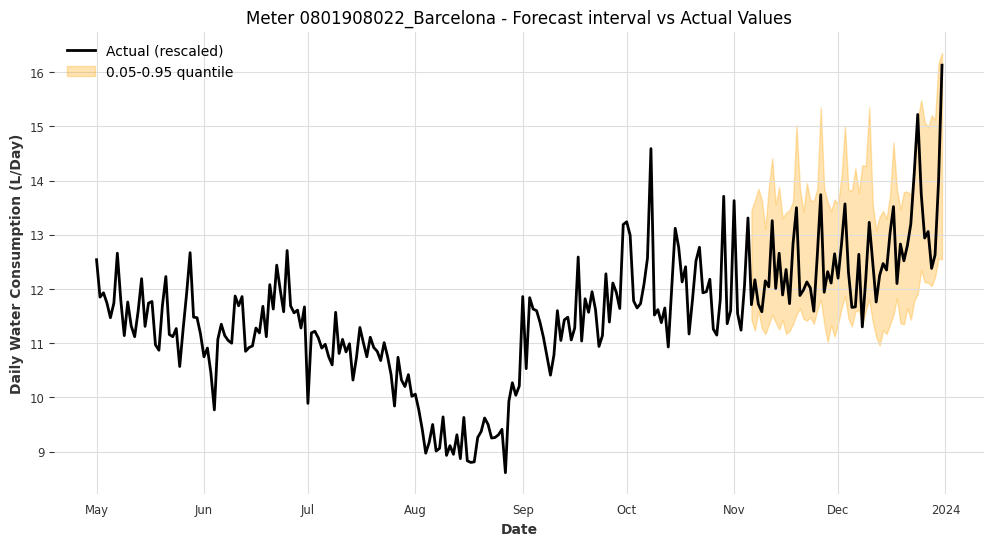

Meter 0801908022_Barcelona - Coverage: 0.9643, Width: 2.5369



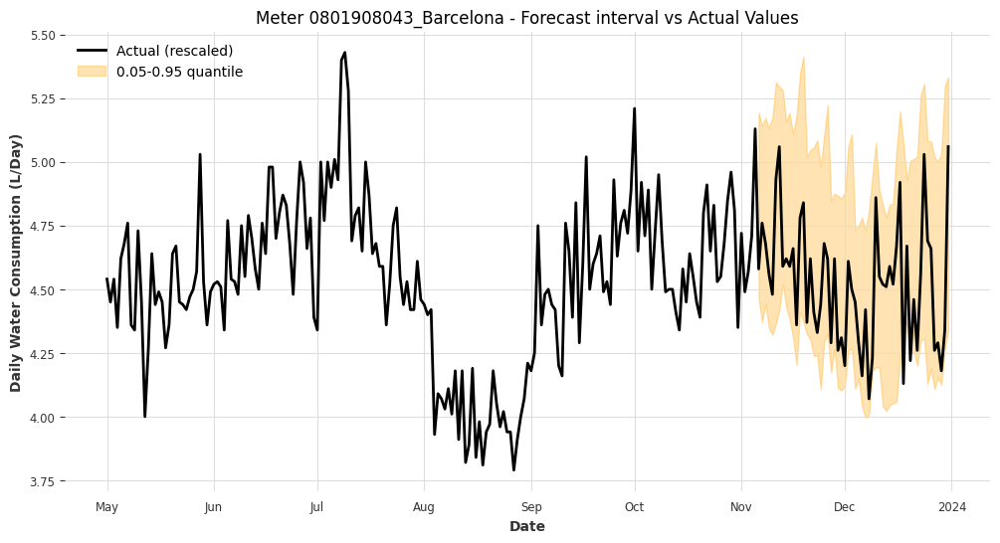

Meter 0801908043_Barcelona - Coverage: 0.9643, Width: 0.8149



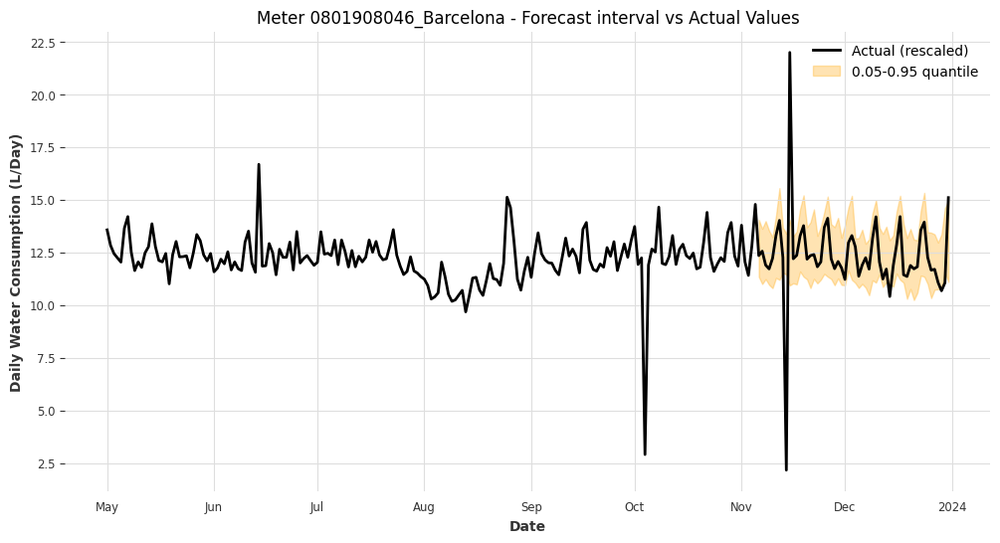

Meter 0801908046_Barcelona - Coverage: 0.8929, Width: 2.8260



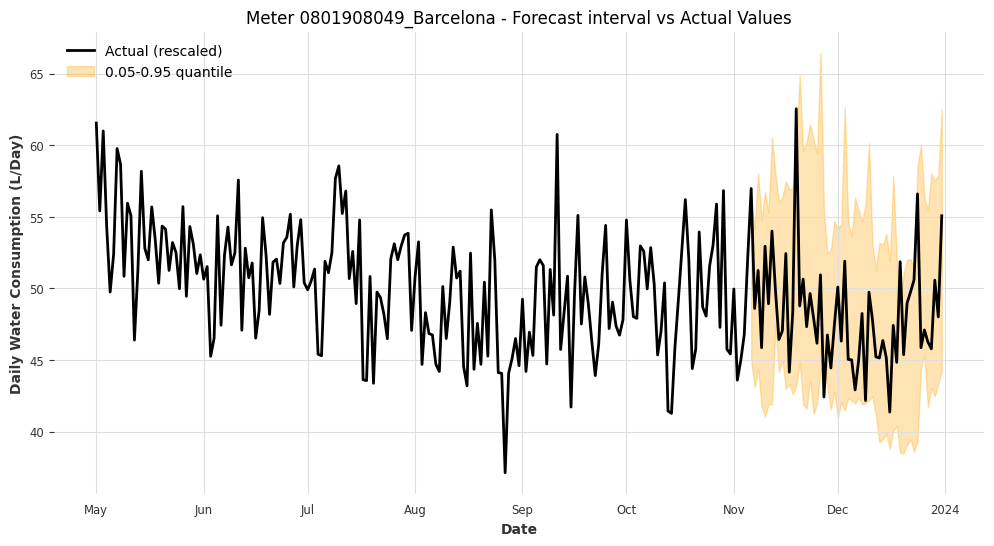

Meter 0801908049_Barcelona - Coverage: 0.9286, Width: 14.2557



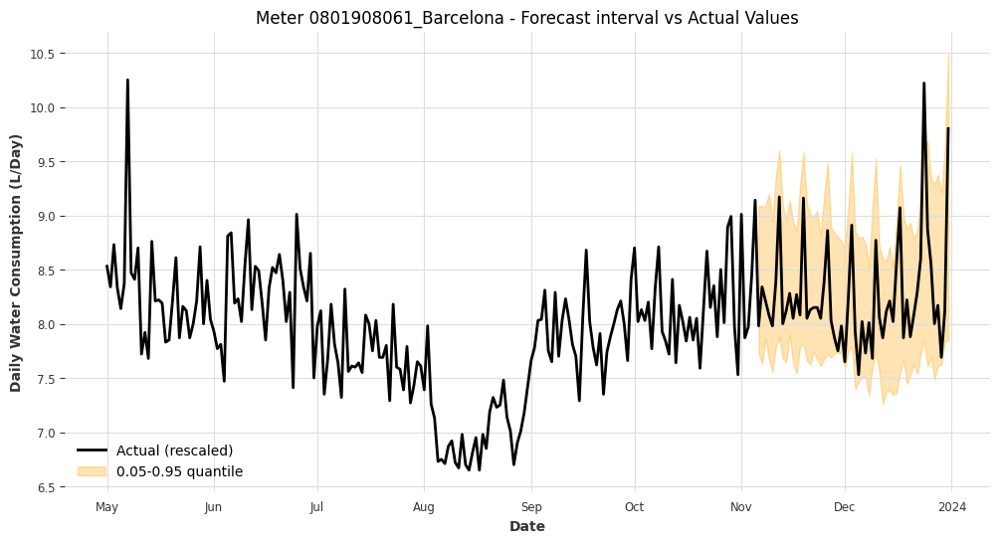

Meter 0801908061_Barcelona - Coverage: 0.9821, Width: 1.4527



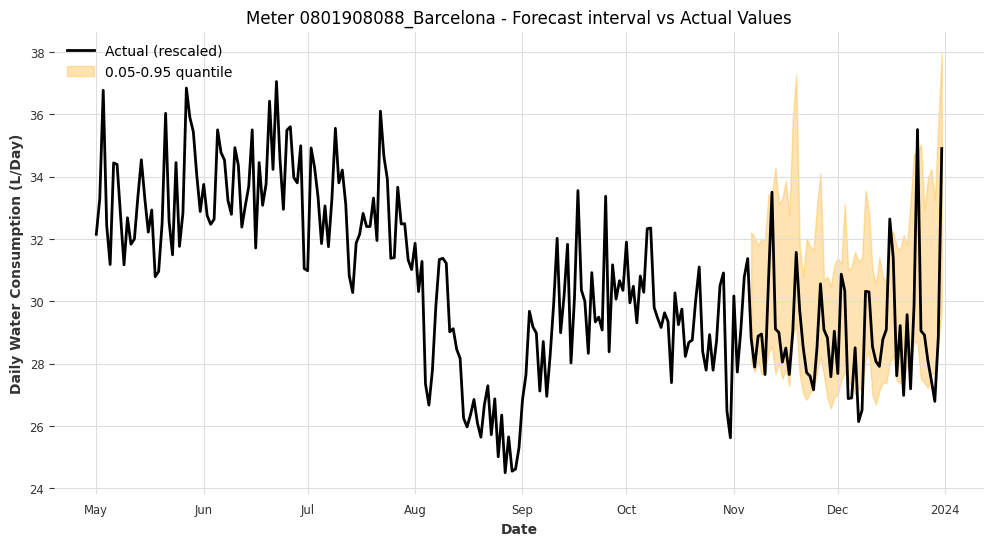

Meter 0801908088_Barcelona - Coverage: 0.7679, Width: 4.9169



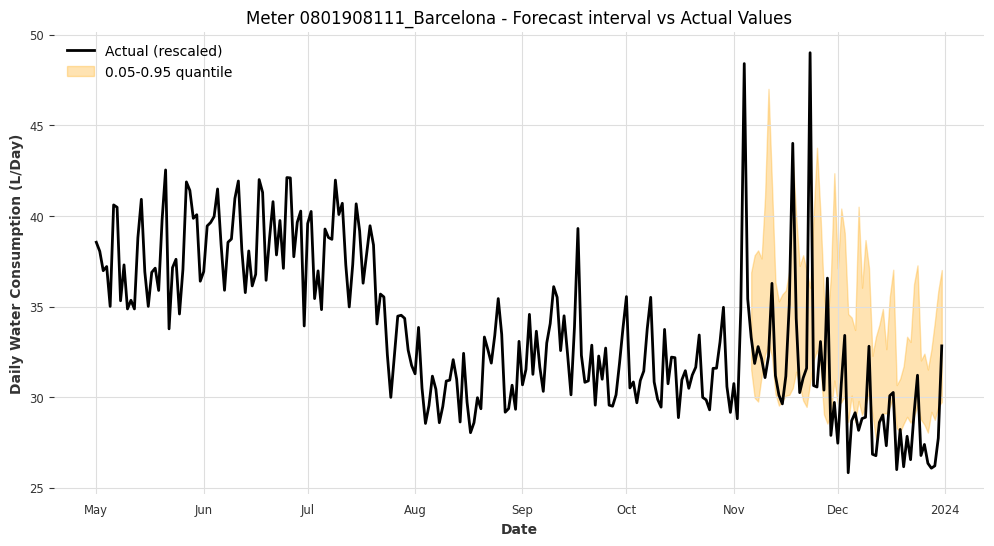

Meter 0801908111_Barcelona - Coverage: 0.4286, Width: 6.7249



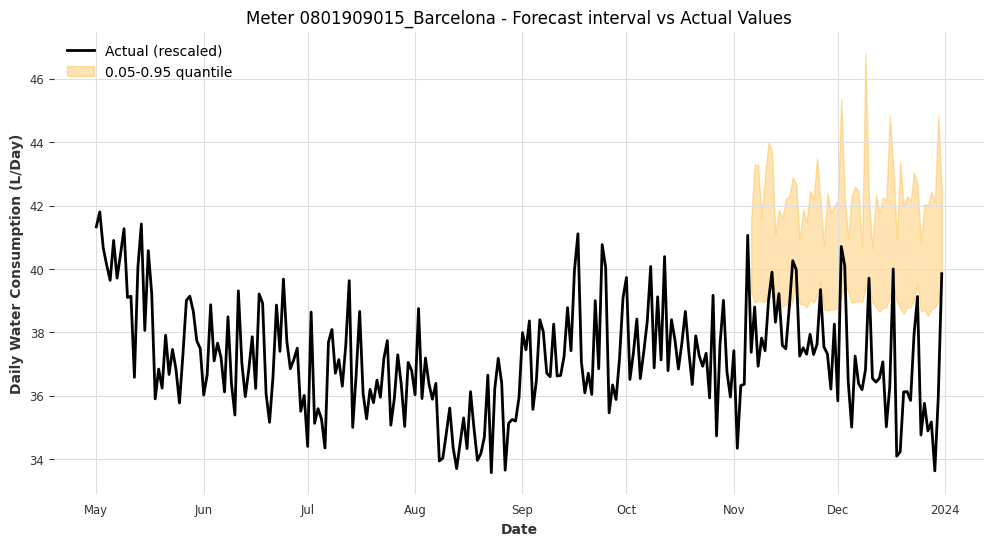

Meter 0801909015_Barcelona - Coverage: 0.1607, Width: 3.4150



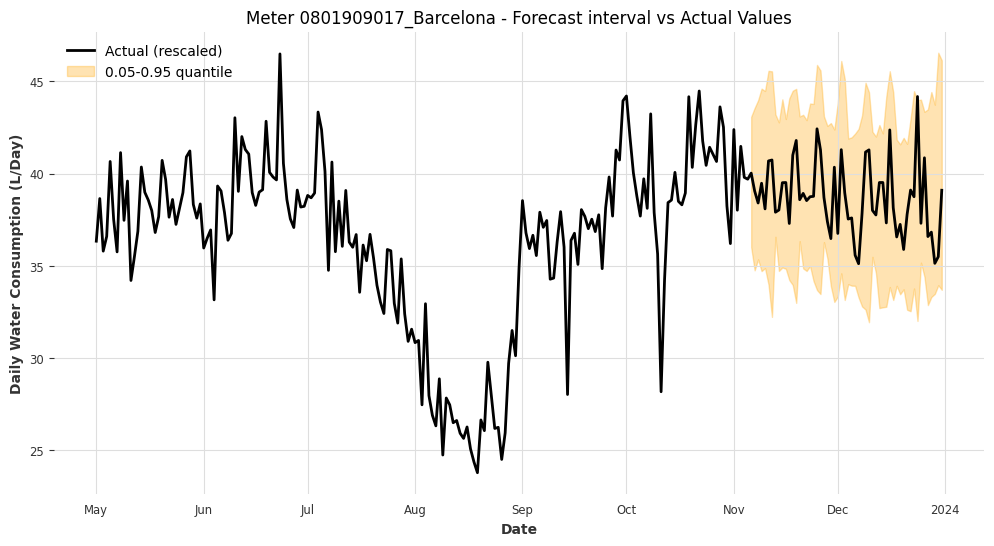

Meter 0801909017_Barcelona - Coverage: 0.9821, Width: 9.6859



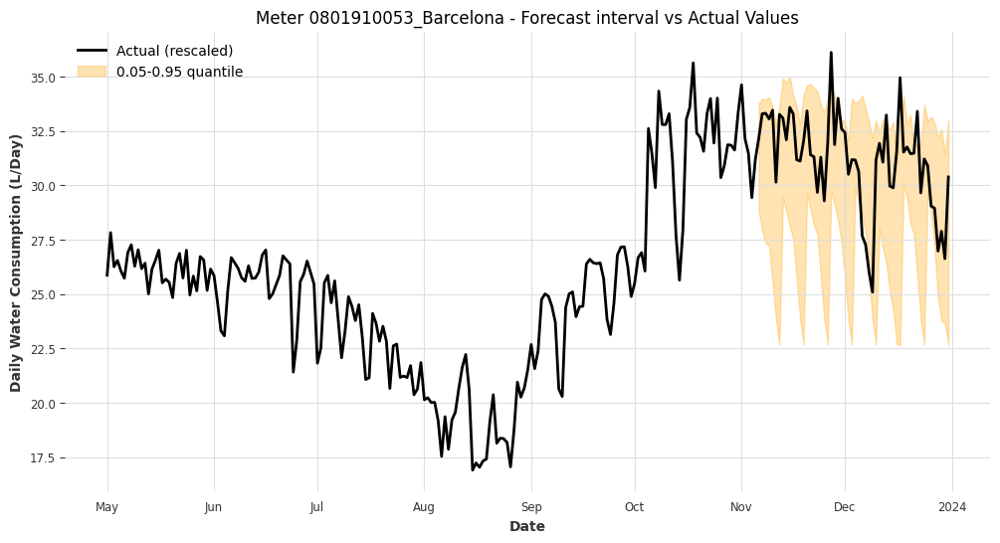

Meter 0801910053_Barcelona - Coverage: 0.8571, Width: 7.0102



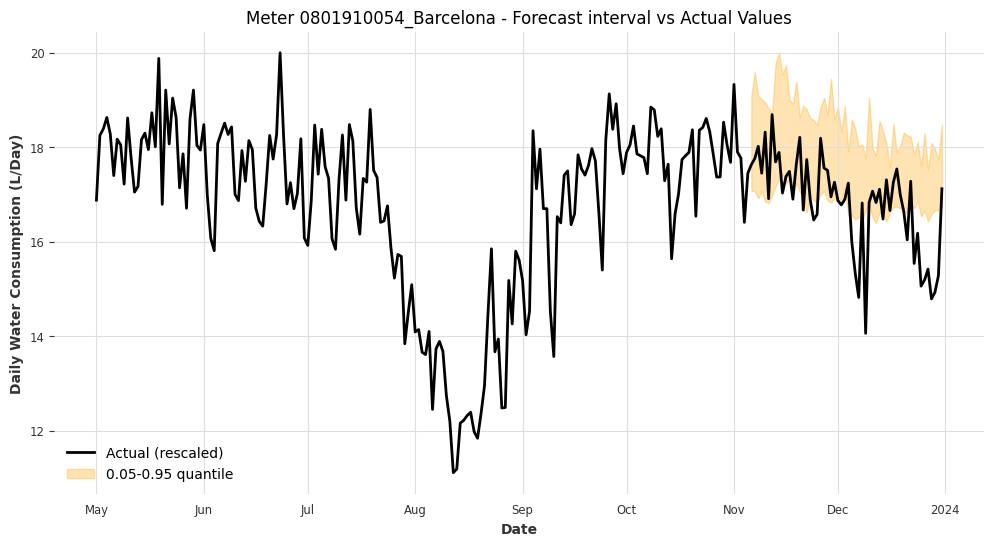

Meter 0801910054_Barcelona - Coverage: 0.5893, Width: 1.7453



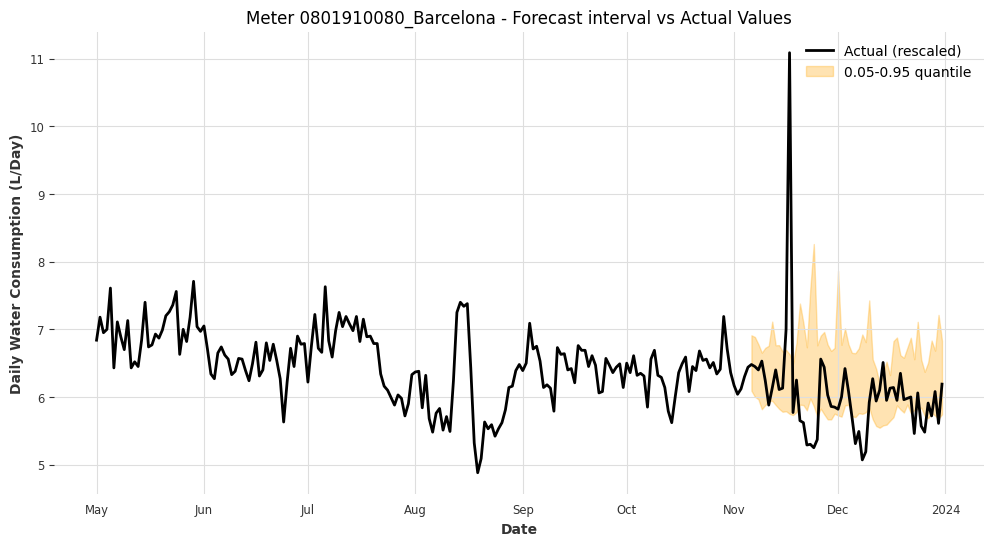

Meter 0801910080_Barcelona - Coverage: 0.6429, Width: 1.0315



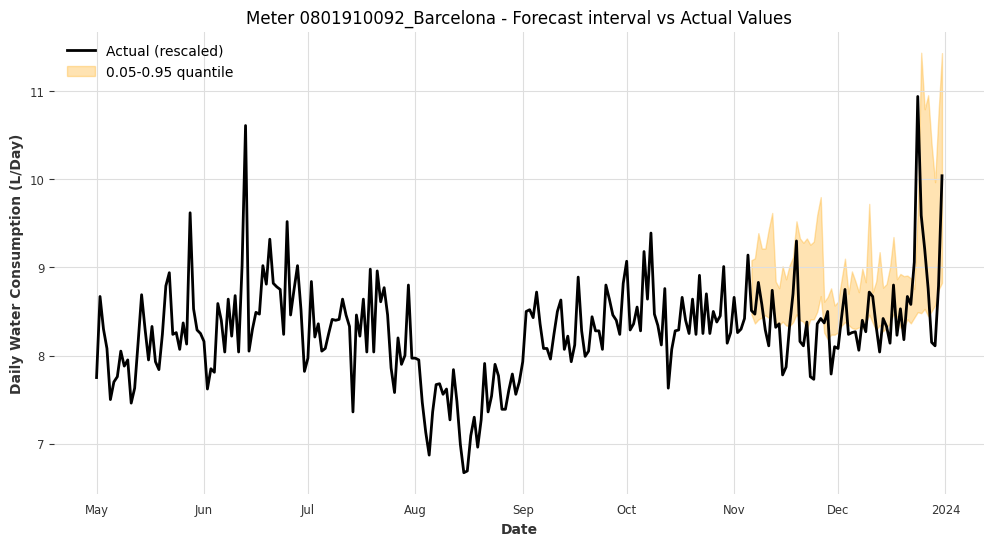

Meter 0801910092_Barcelona - Coverage: 0.5000, Width: 0.8718



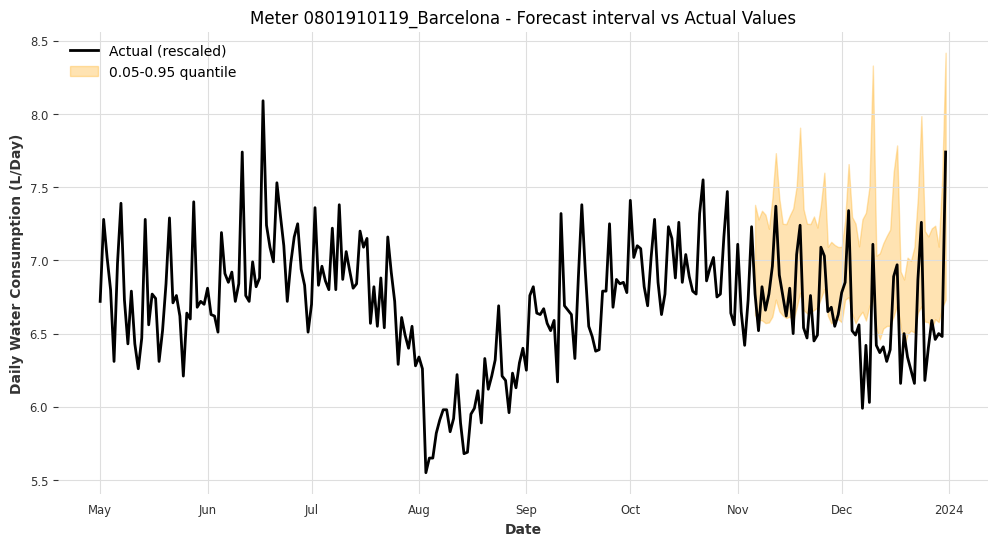

Meter 0801910119_Barcelona - Coverage: 0.5179, Width: 0.7151



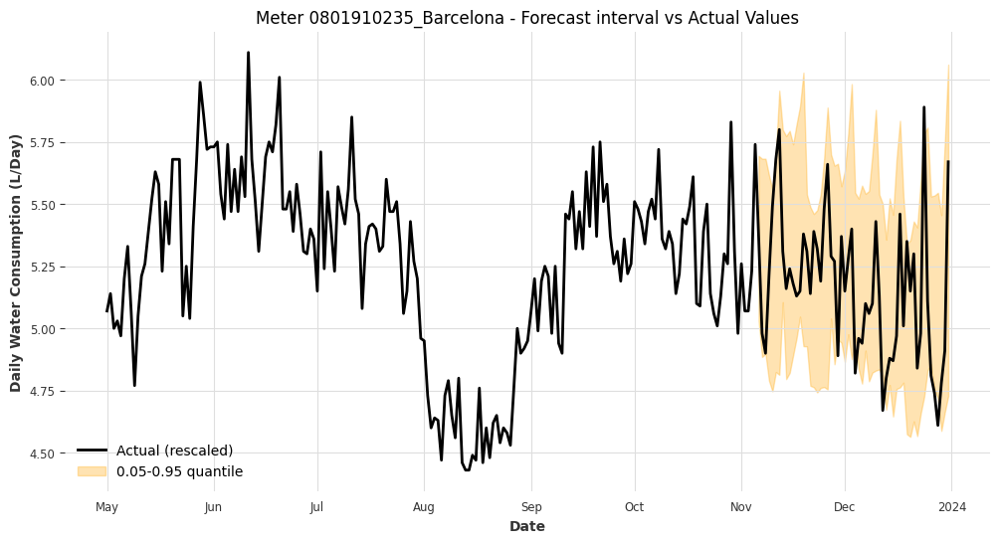

Meter 0801910235_Barcelona - Coverage: 0.8571, Width: 0.8352



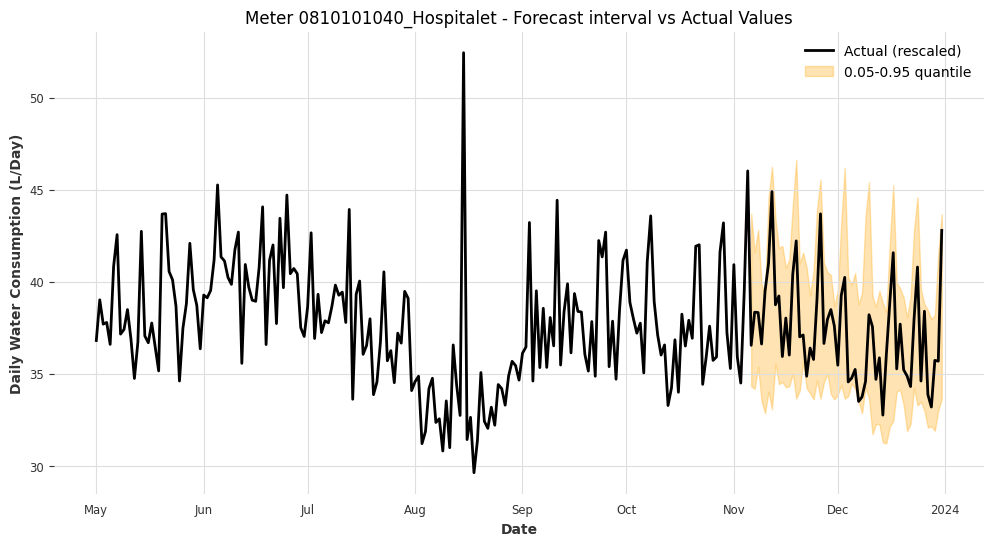

Meter 0810101040_Hospitalet - Coverage: 0.9821, Width: 7.6938



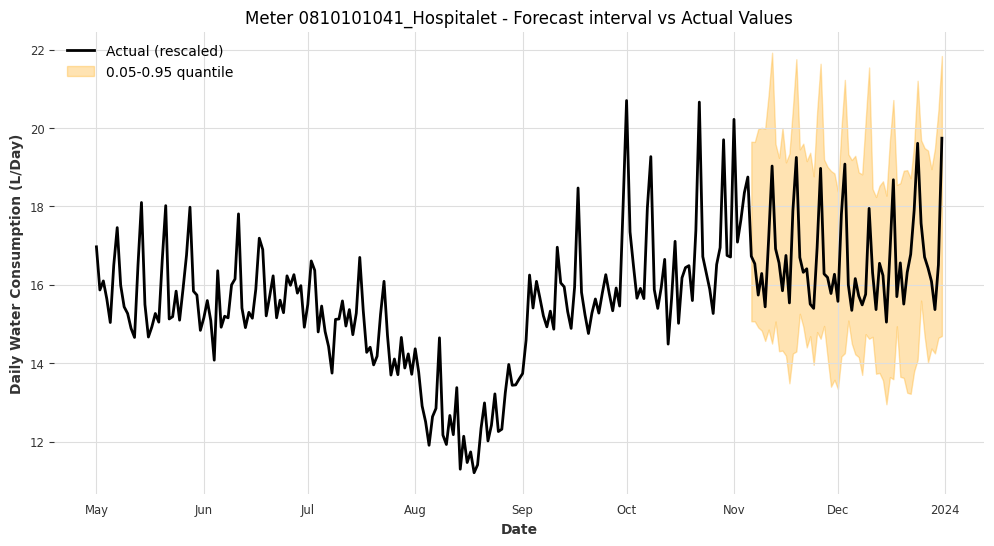

Meter 0810101041_Hospitalet - Coverage: 1.0000, Width: 5.3371



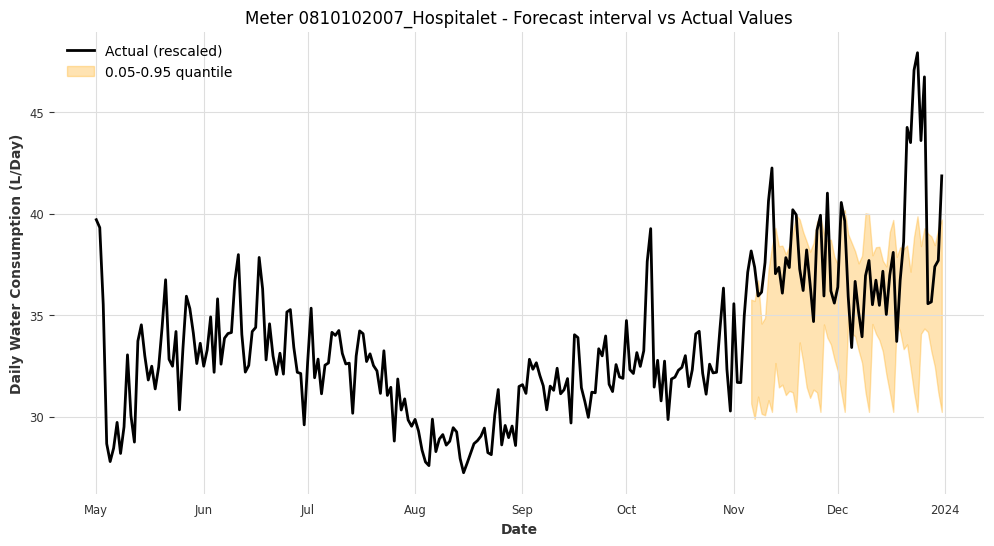

Meter 0810102007_Hospitalet - Coverage: 0.6250, Width: 6.2705



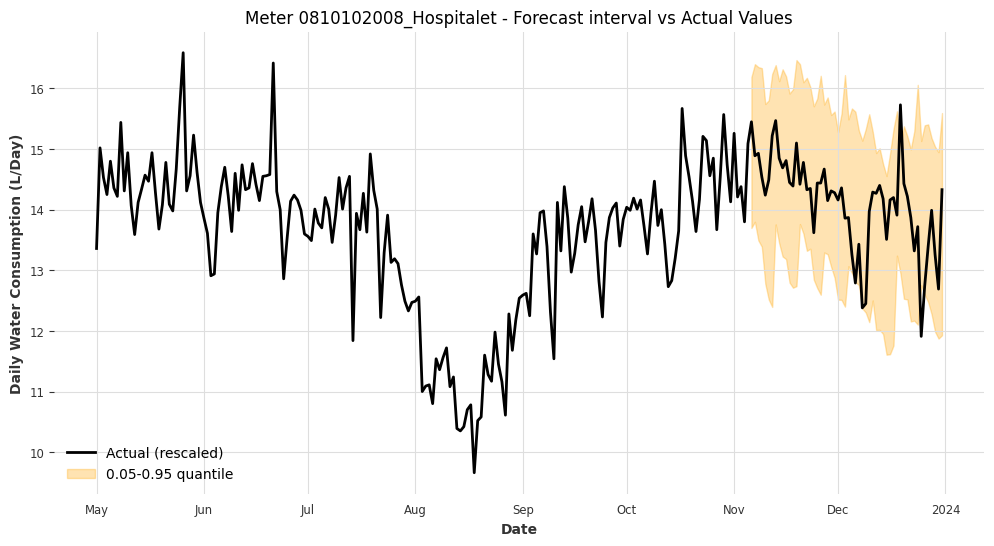

Meter 0810102008_Hospitalet - Coverage: 0.9464, Width: 2.9377



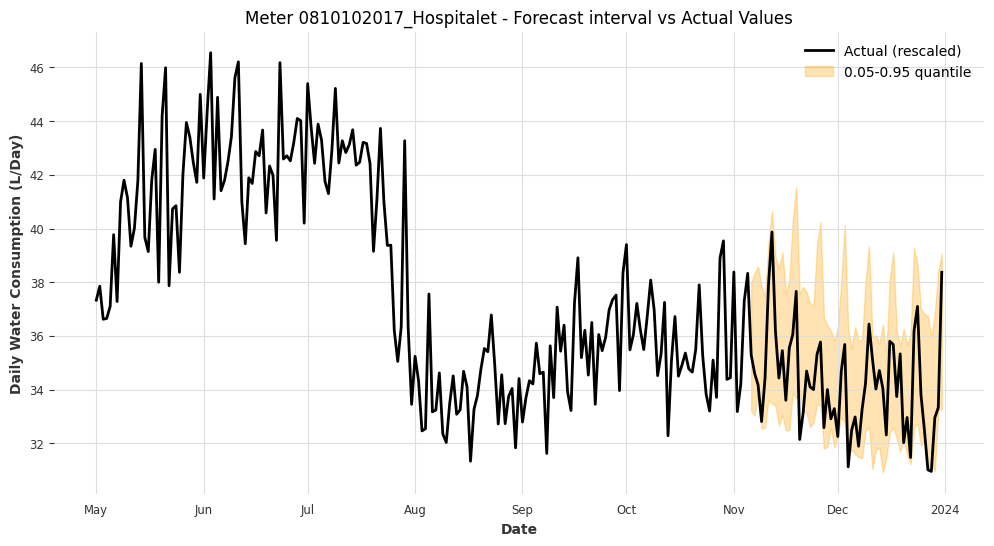

Meter 0810102017_Hospitalet - Coverage: 0.8750, Width: 5.1364



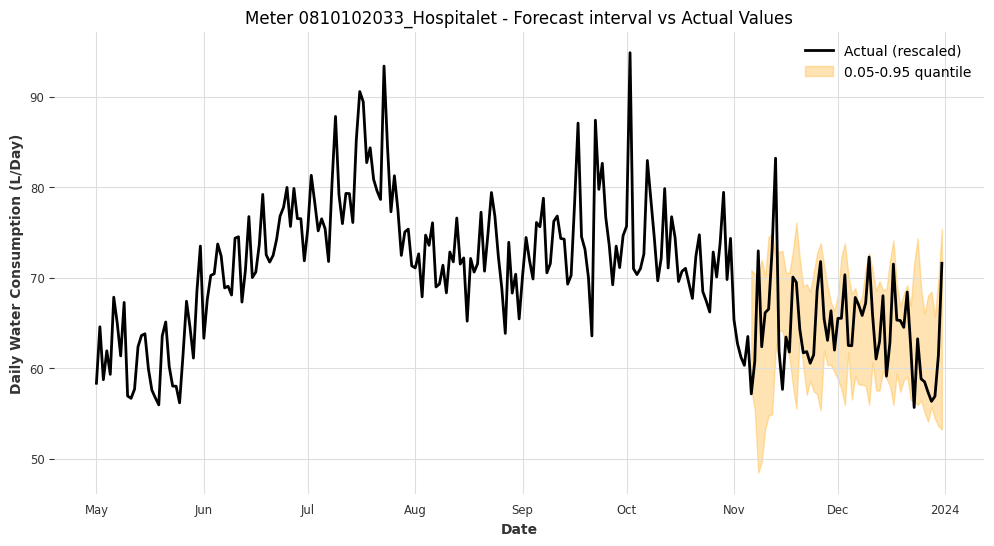

Meter 0810102033_Hospitalet - Coverage: 0.8929, Width: 12.7719



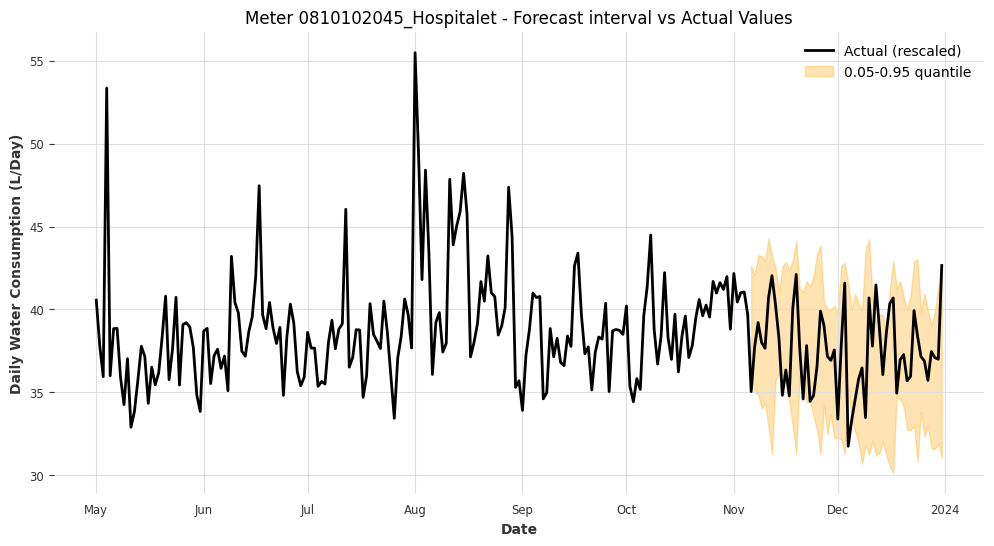

Meter 0810102045_Hospitalet - Coverage: 0.8393, Width: 8.4920



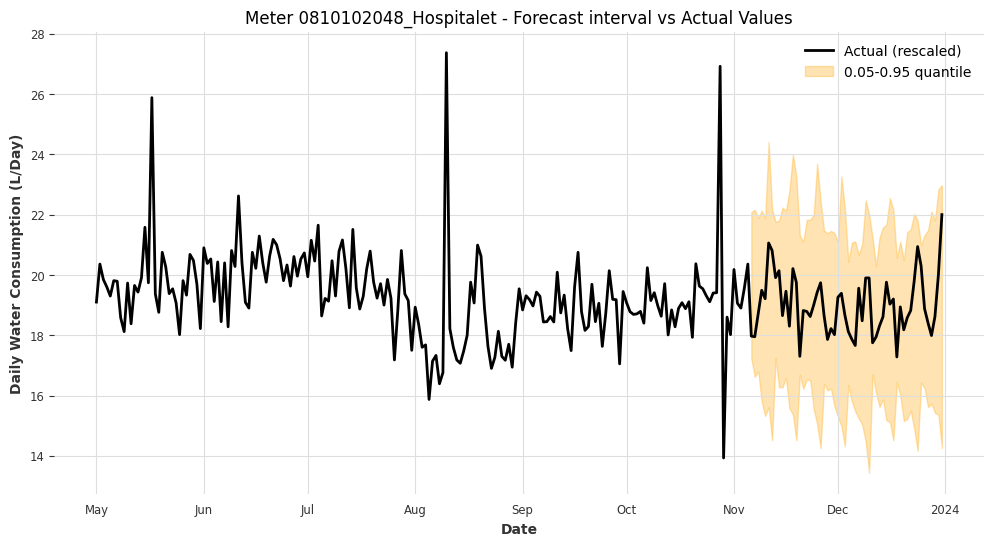

Meter 0810102048_Hospitalet - Coverage: 1.0000, Width: 6.2178



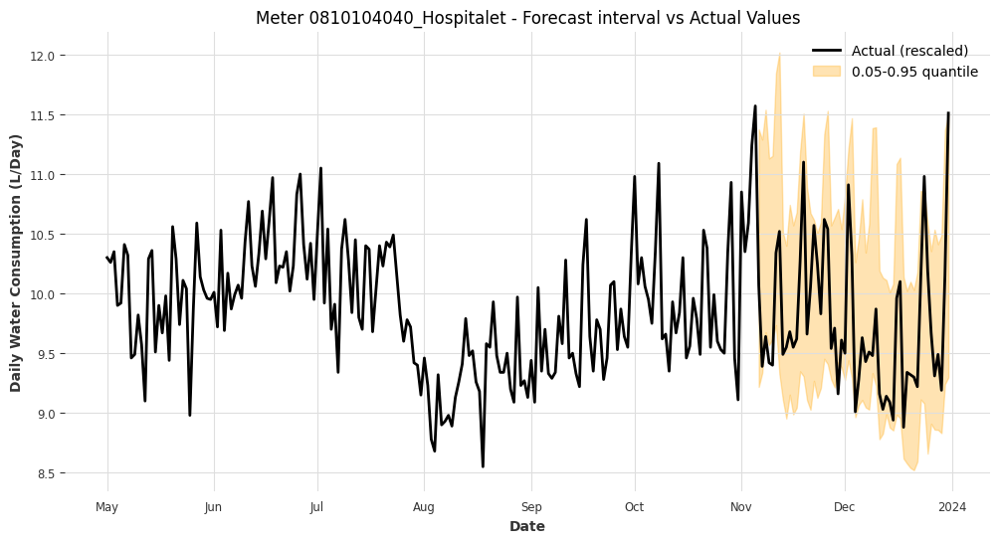

Meter 0810104040_Hospitalet - Coverage: 0.8929, Width: 1.6676



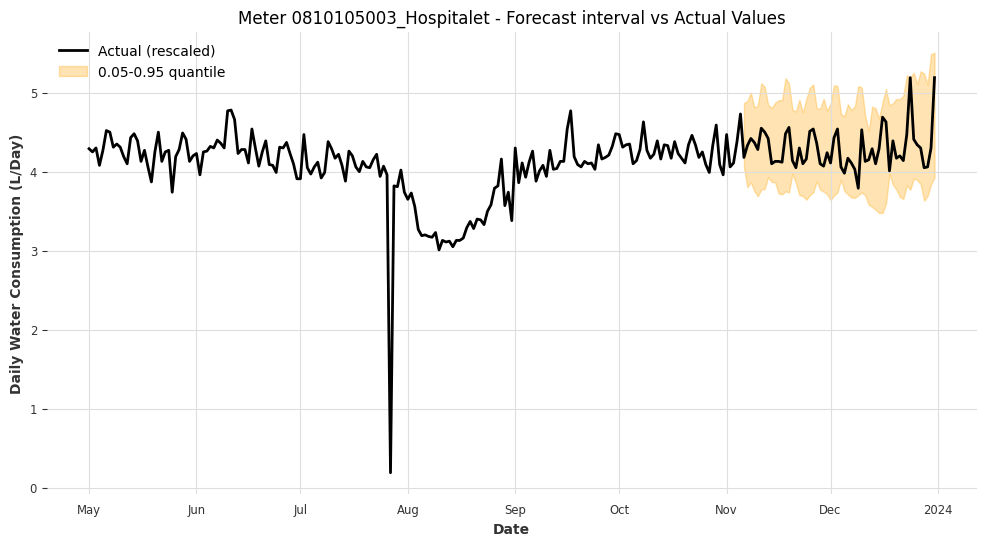

Meter 0810105003_Hospitalet - Coverage: 1.0000, Width: 1.1986



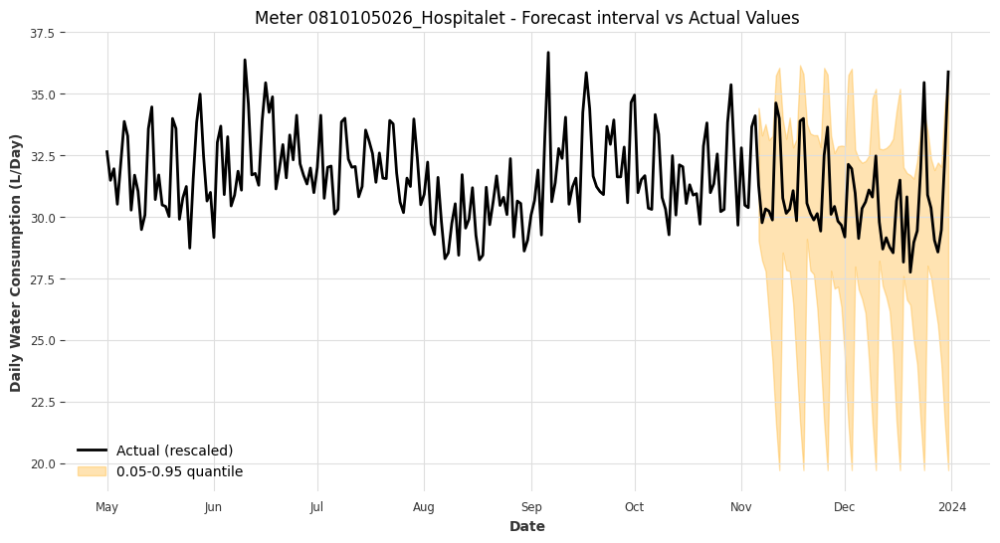

Meter 0810105026_Hospitalet - Coverage: 0.9643, Width: 8.6344



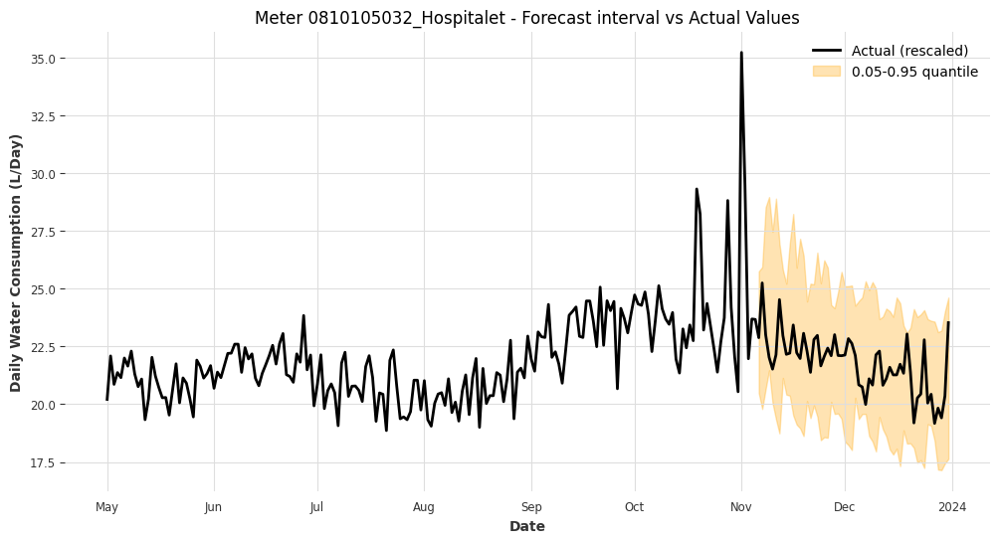

Meter 0810105032_Hospitalet - Coverage: 1.0000, Width: 6.1584



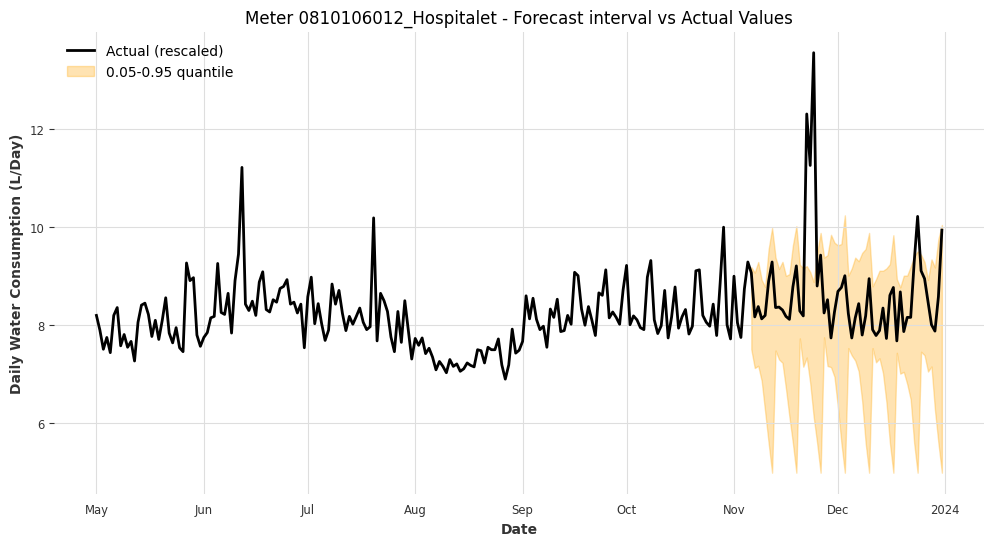

Meter 0810106012_Hospitalet - Coverage: 0.9286, Width: 2.7955



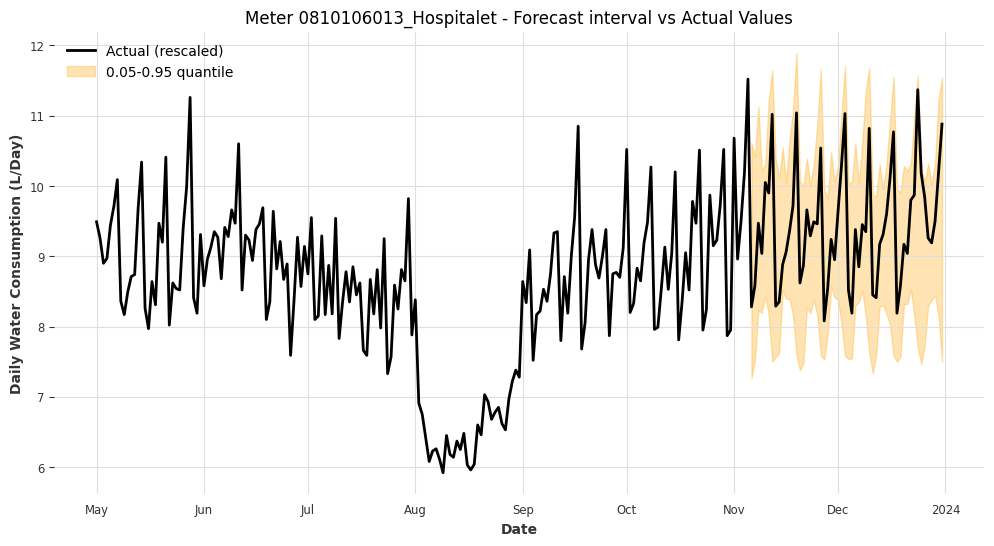

Meter 0810106013_Hospitalet - Coverage: 1.0000, Width: 2.5769



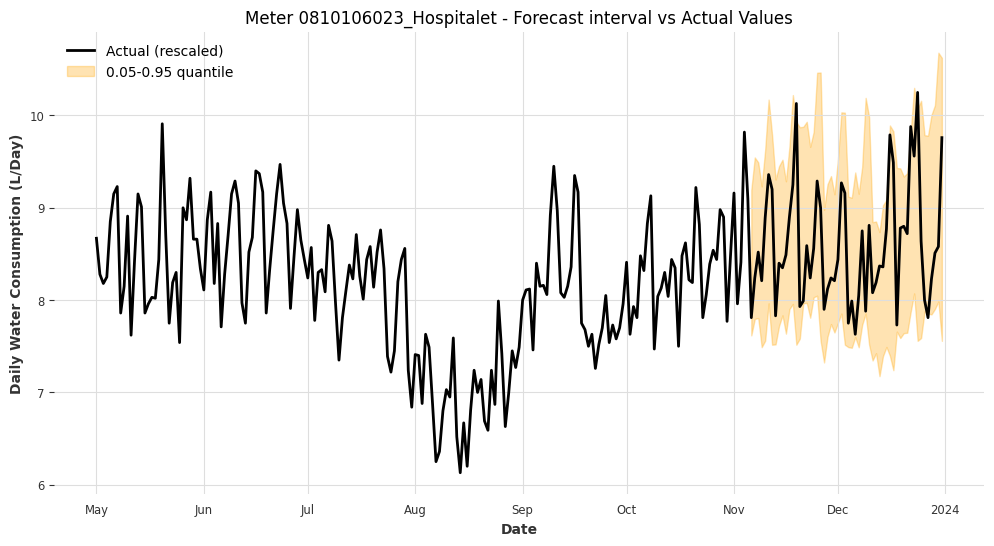

Meter 0810106023_Hospitalet - Coverage: 0.9286, Width: 1.9795



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # Darts utility to merge TimeSeries

for meter_id, hfcs in all_hfcs.items():
    # Get the actual time series
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width = df_result["Width rescaled"].iloc[0]

    # Start a new plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    full_lower = []
    full_upper = []

    # Collect lower and upper quantiles from each forecast window
    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components
            and 'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)


    if full_lower and full_upper:
        # Concatenate all the TimeSeries pieces into full series
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        # Plot the quantile area as a filled region
        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05-0.95 quantile'
        )

    ax.set_title(f"Meter {meter_id} - Forecast interval vs Actual Values")
    ax.set_ylabel("Daily Water Consumption (L/Day)")  # <-- Add this line

    ax.legend()
    plt.show()

    # Print the metrics below each plot
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Width: {width:.4f}\n")

In [ ]:
# Let's check the standard scaling

In [ ]:
# Load model
model = LightGBMModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/lightGBM/simple/lightgbm_model_standard.pkl")
# We load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test/scaled_test_standard.pkl')
print(test_data.keys())

# Extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])


    # We backtest (evaluate) the generated predictions
    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": bt[1], "Width rescaled": mean_width})

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


historical forecasts: 100%|██████████| 1/1 [00:00<00:00, 15.62it/s]


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()
mean_width_rescaled = combined_results["Width rescaled"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")
print(f"Mean Width rescaled: {mean_width_rescaled:.4f}")

Mean Coverage: 0.7878
Mean Width: 1.9244
Mean Width rescaled: 6.1688


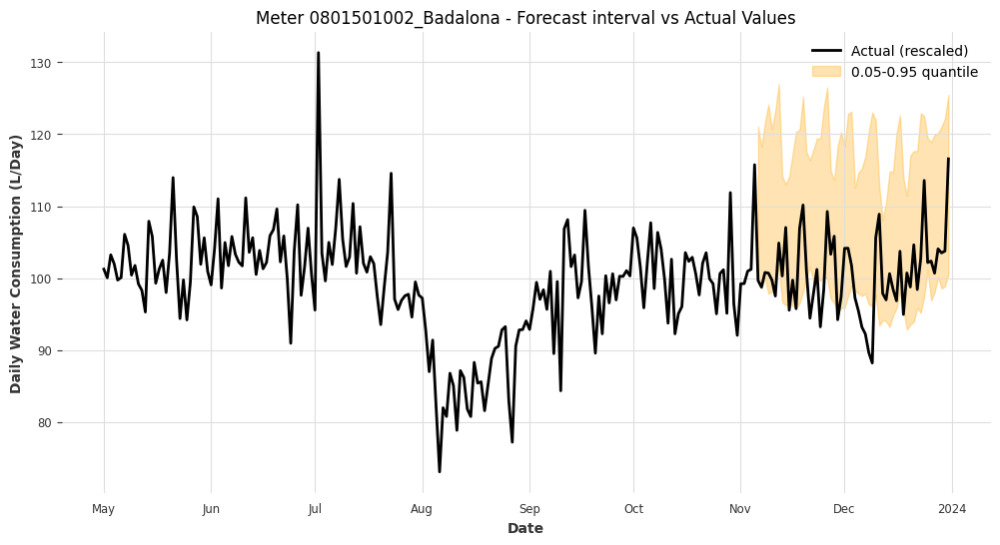

Meter 0801501002_Badalona - Coverage: 0.7143, Width: 21.4258



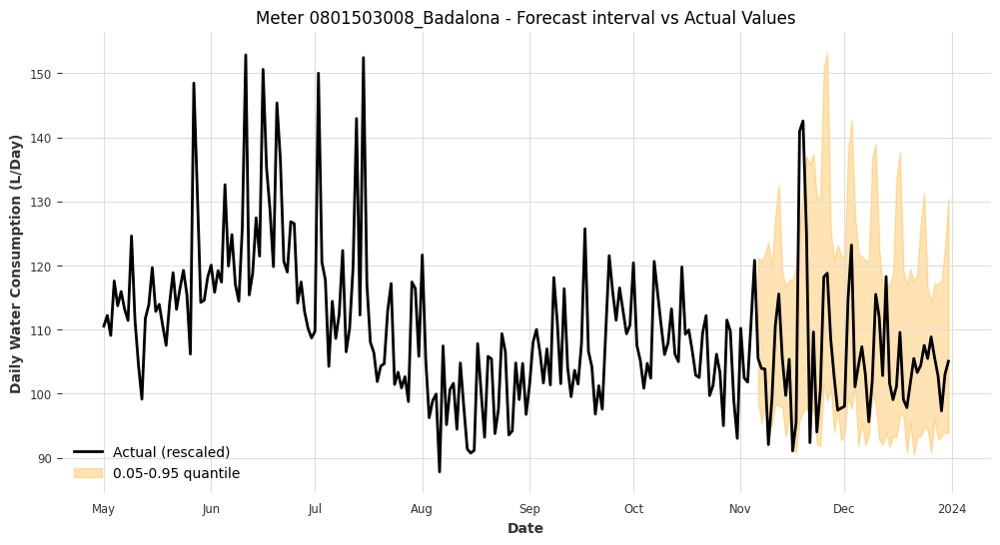

Meter 0801503008_Badalona - Coverage: 0.8571, Width: 30.1985



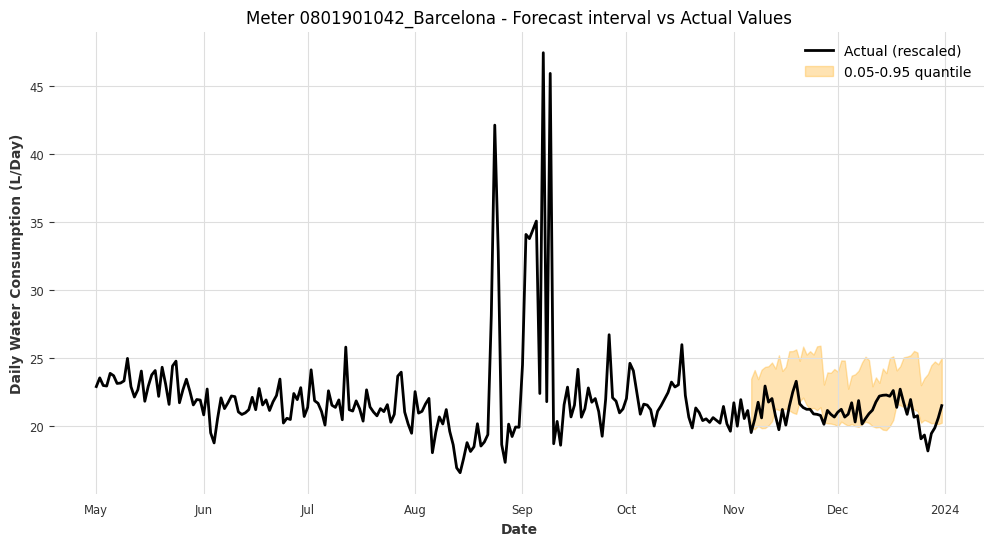

Meter 0801901042_Barcelona - Coverage: 0.6250, Width: 3.9139



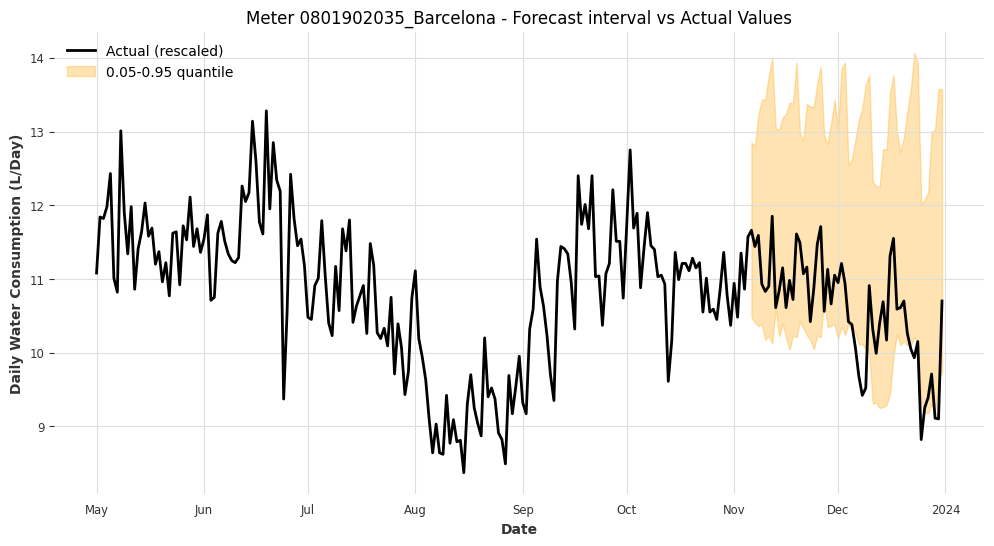

Meter 0801902035_Barcelona - Coverage: 0.8036, Width: 3.1396



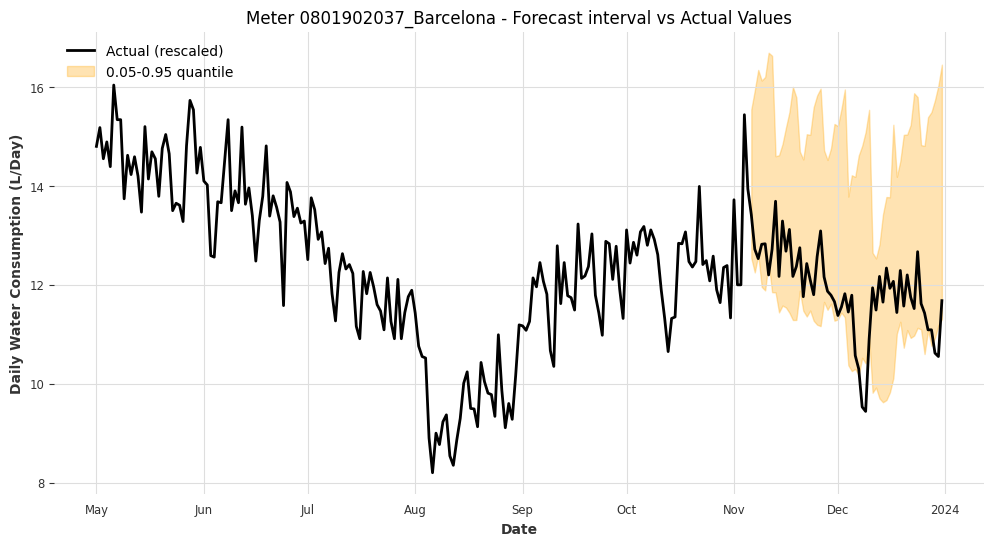

Meter 0801902037_Barcelona - Coverage: 0.8750, Width: 3.9617



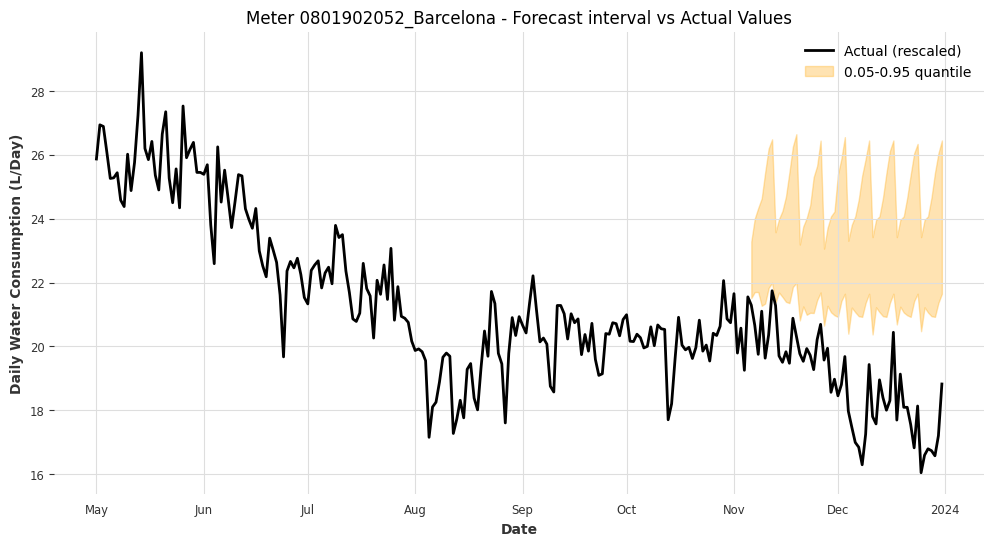

Meter 0801902052_Barcelona - Coverage: 0.0000, Width: 3.5884



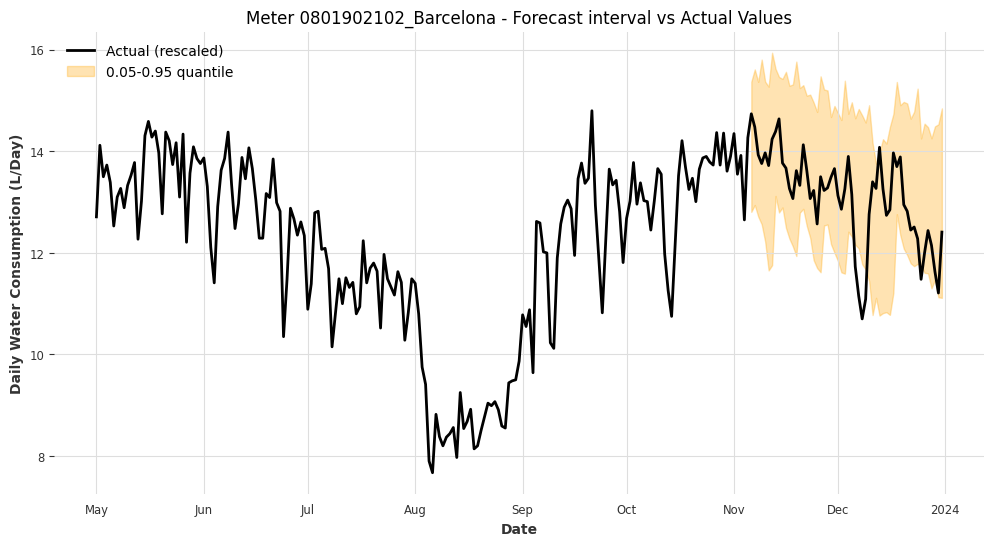

Meter 0801902102_Barcelona - Coverage: 0.8929, Width: 3.0030



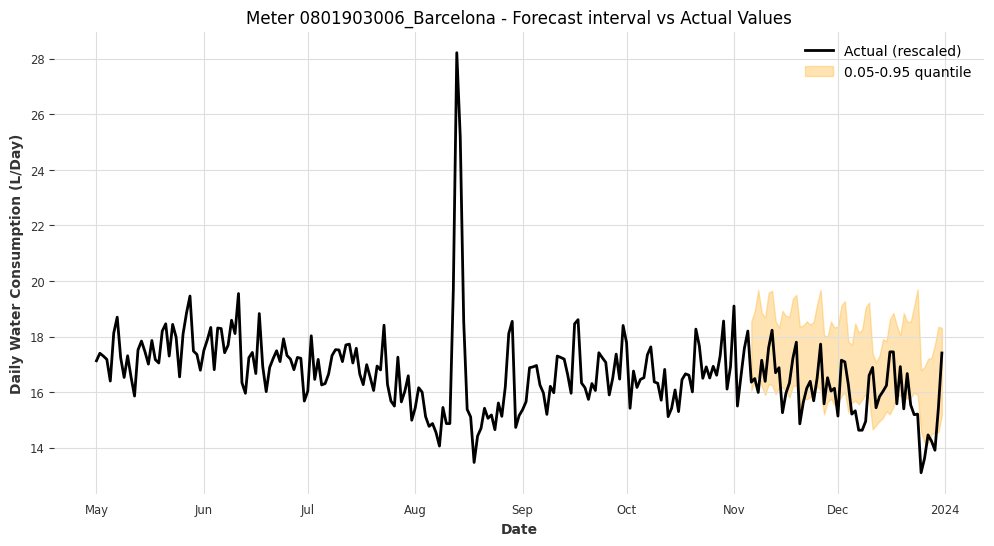

Meter 0801903006_Barcelona - Coverage: 0.6250, Width: 2.8510



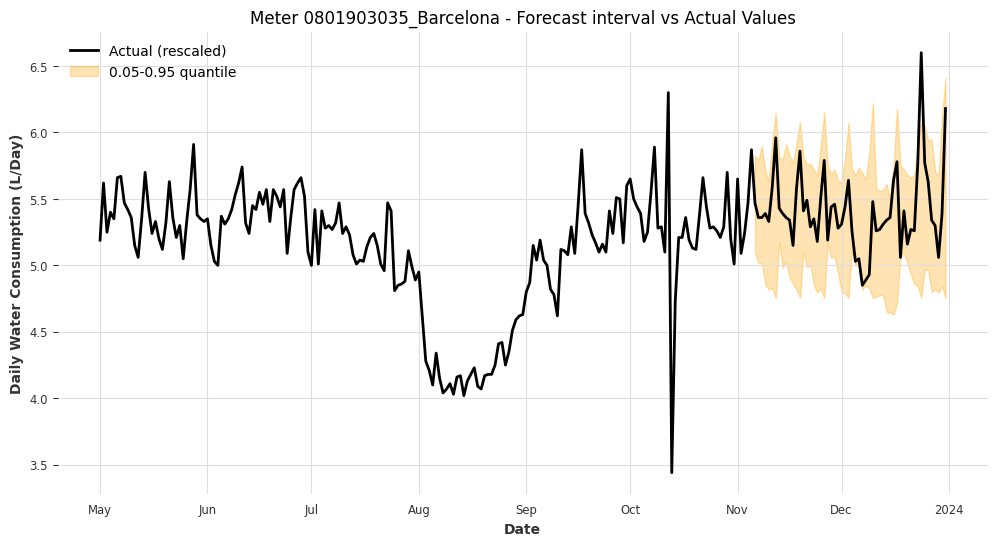

Meter 0801903035_Barcelona - Coverage: 0.9643, Width: 0.9307



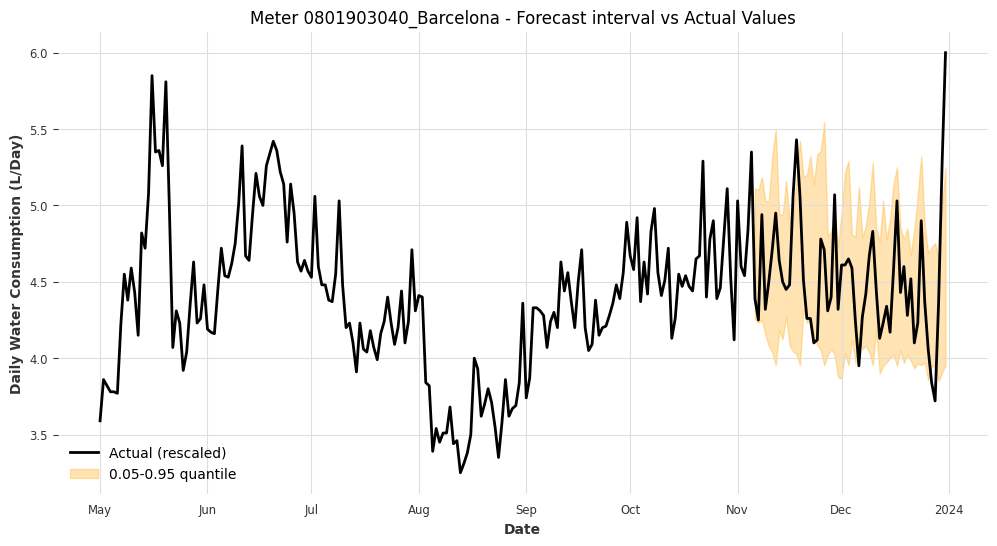

Meter 0801903040_Barcelona - Coverage: 0.8214, Width: 0.9854



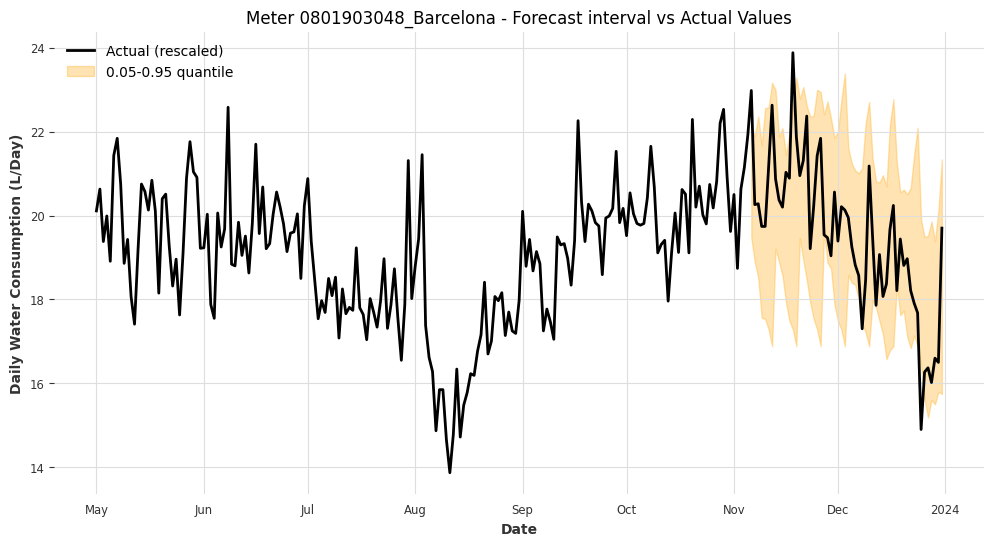

Meter 0801903048_Barcelona - Coverage: 0.8929, Width: 4.1723



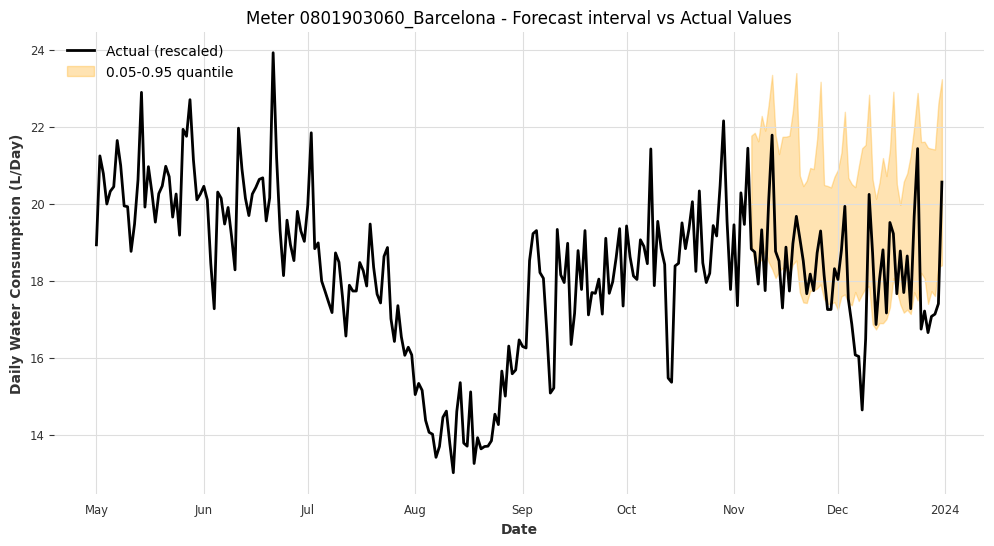

Meter 0801903060_Barcelona - Coverage: 0.6429, Width: 3.6970



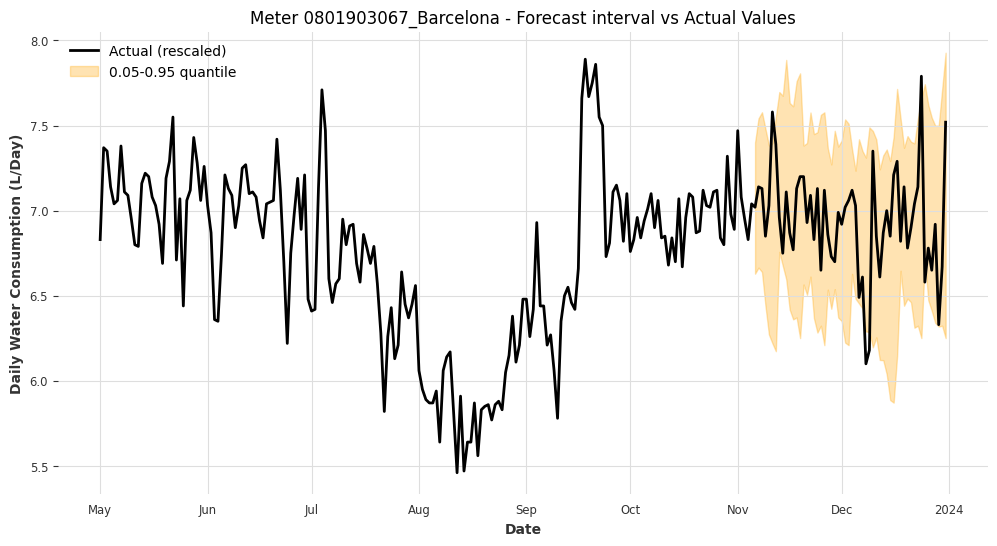

Meter 0801903067_Barcelona - Coverage: 0.9107, Width: 1.1271



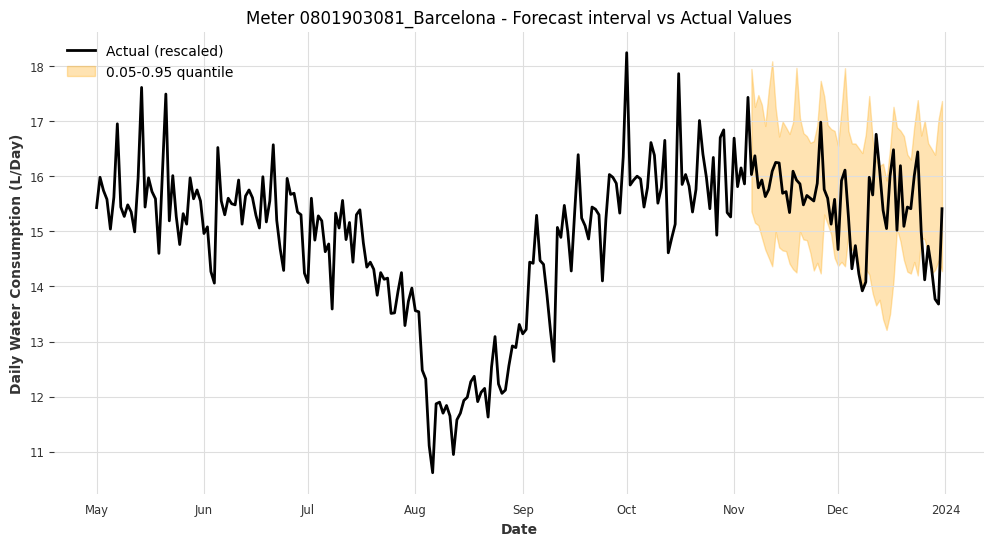

Meter 0801903081_Barcelona - Coverage: 0.8393, Width: 2.4346



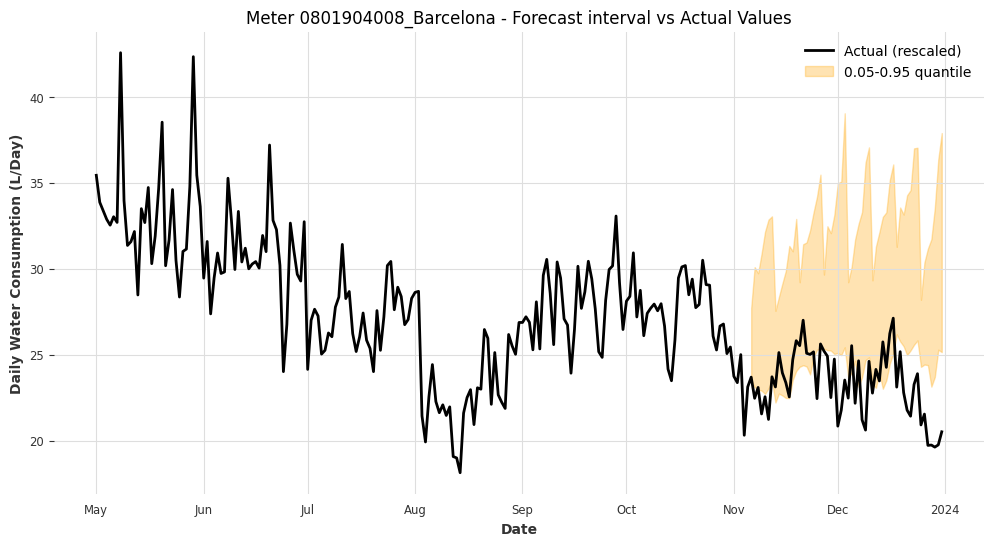

Meter 0801904008_Barcelona - Coverage: 0.4107, Width: 8.3191



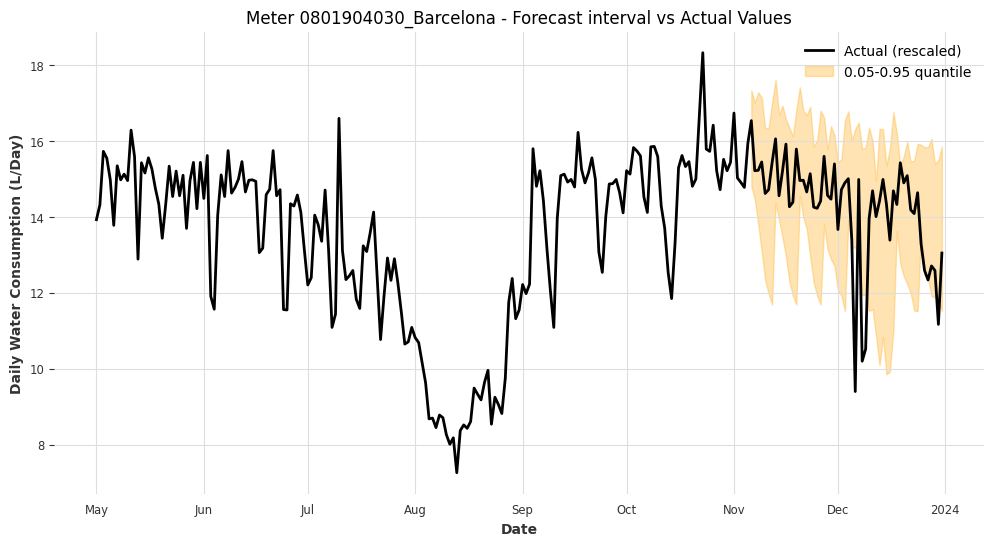

Meter 0801904030_Barcelona - Coverage: 0.8750, Width: 3.8183



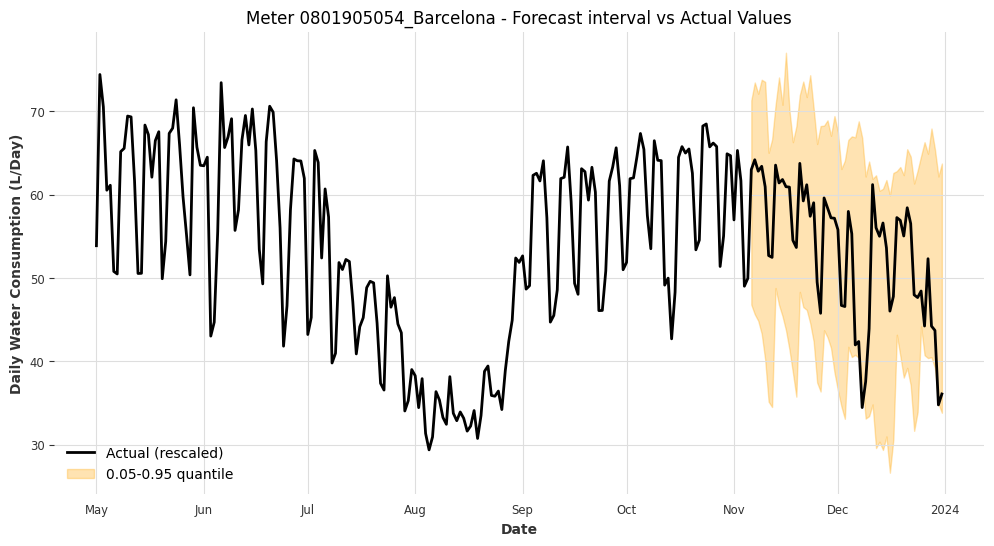

Meter 0801905054_Barcelona - Coverage: 0.9643, Width: 27.9716



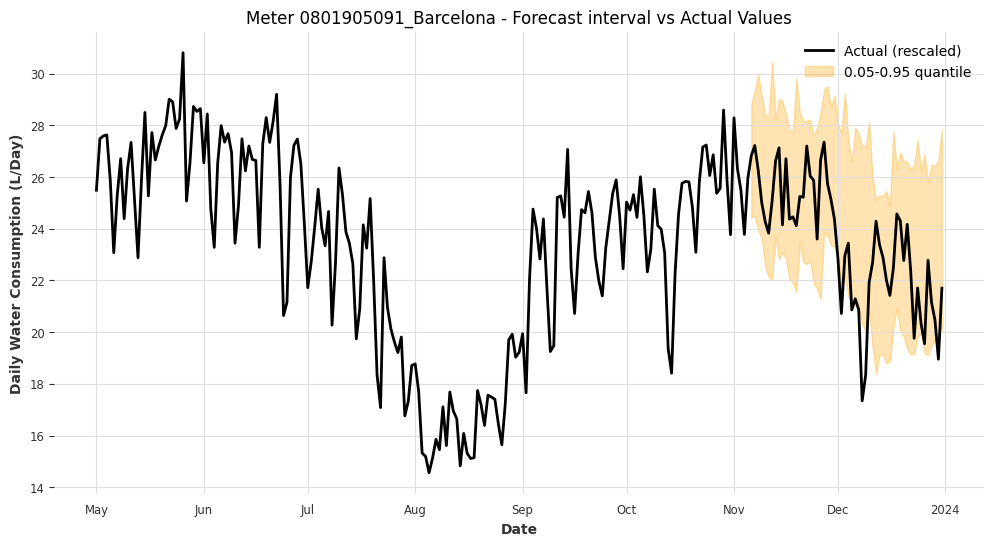

Meter 0801905091_Barcelona - Coverage: 0.8750, Width: 6.3309



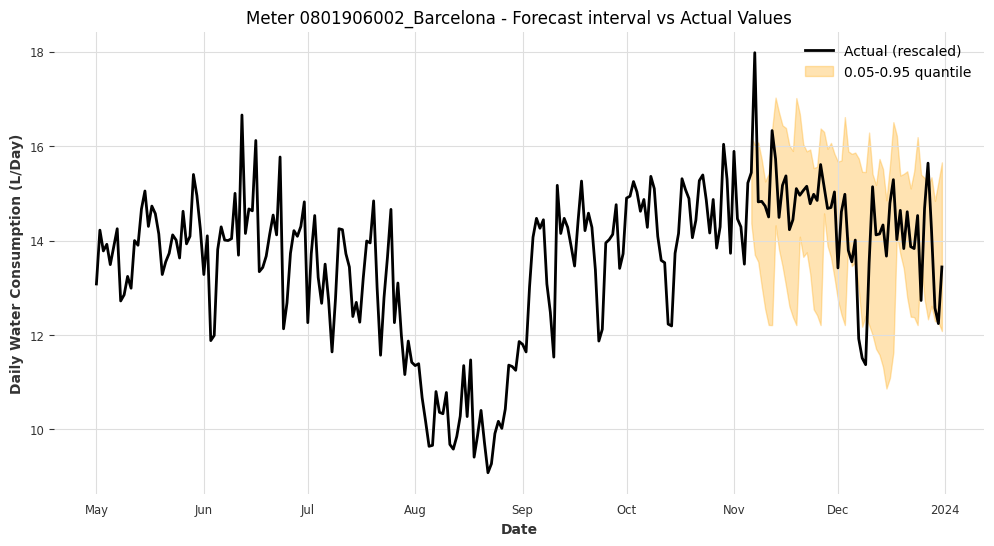

Meter 0801906002_Barcelona - Coverage: 0.8393, Width: 3.0029



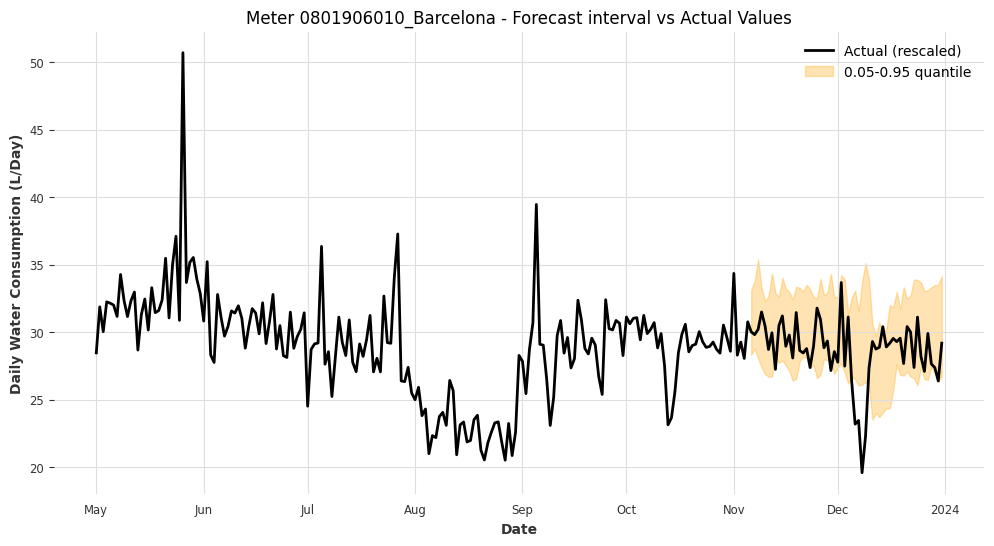

Meter 0801906010_Barcelona - Coverage: 0.8393, Width: 6.1597



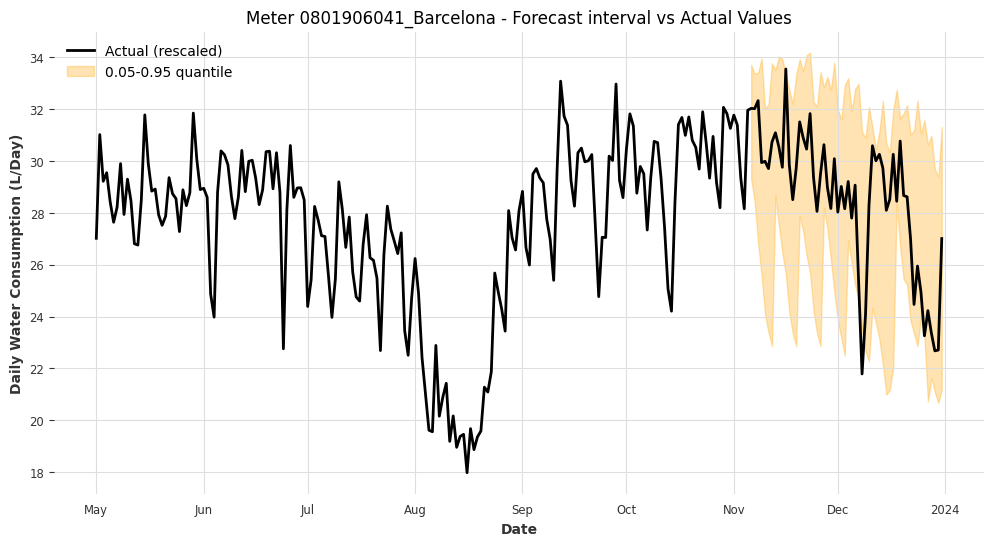

Meter 0801906041_Barcelona - Coverage: 0.9643, Width: 7.8319



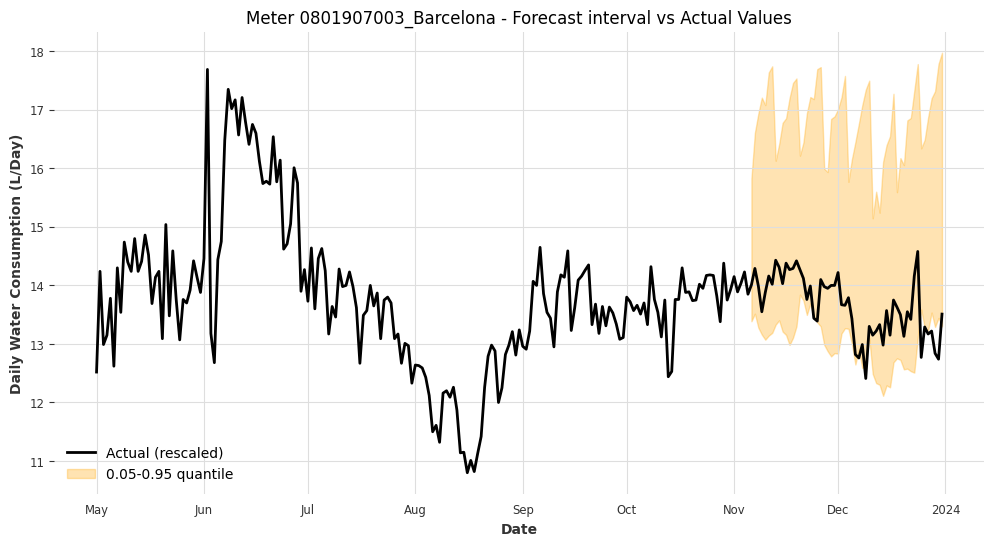

Meter 0801907003_Barcelona - Coverage: 0.8571, Width: 3.7546



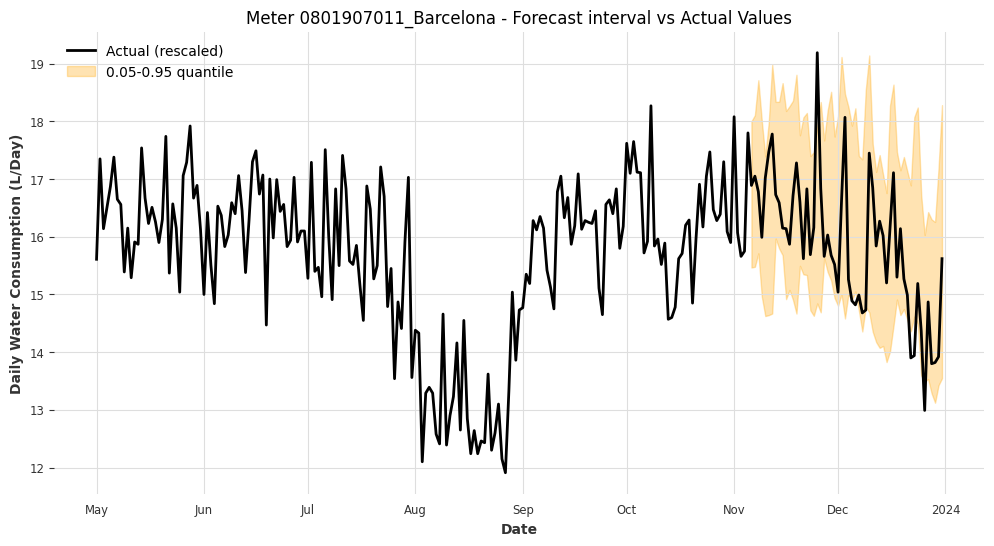

Meter 0801907011_Barcelona - Coverage: 0.8750, Width: 3.1466



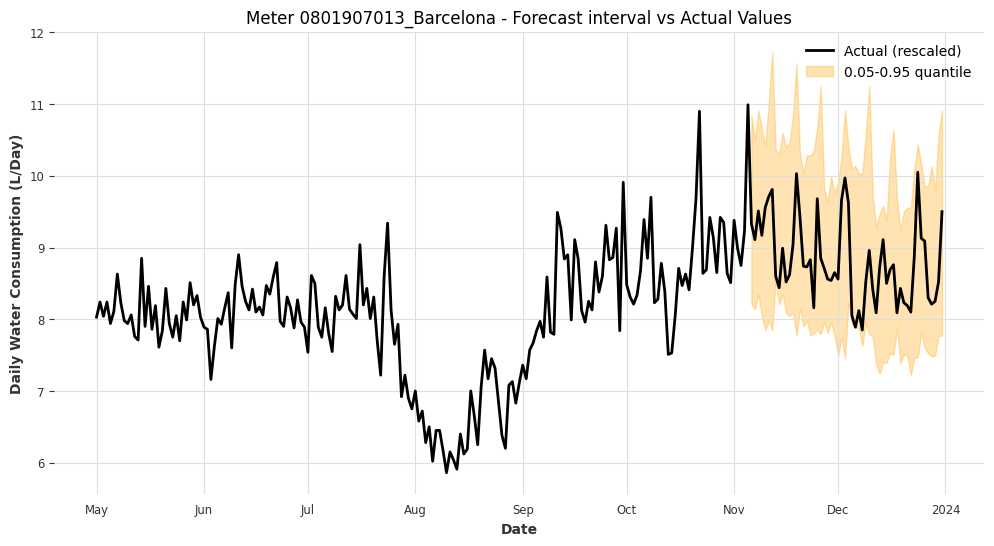

Meter 0801907013_Barcelona - Coverage: 1.0000, Width: 2.4646



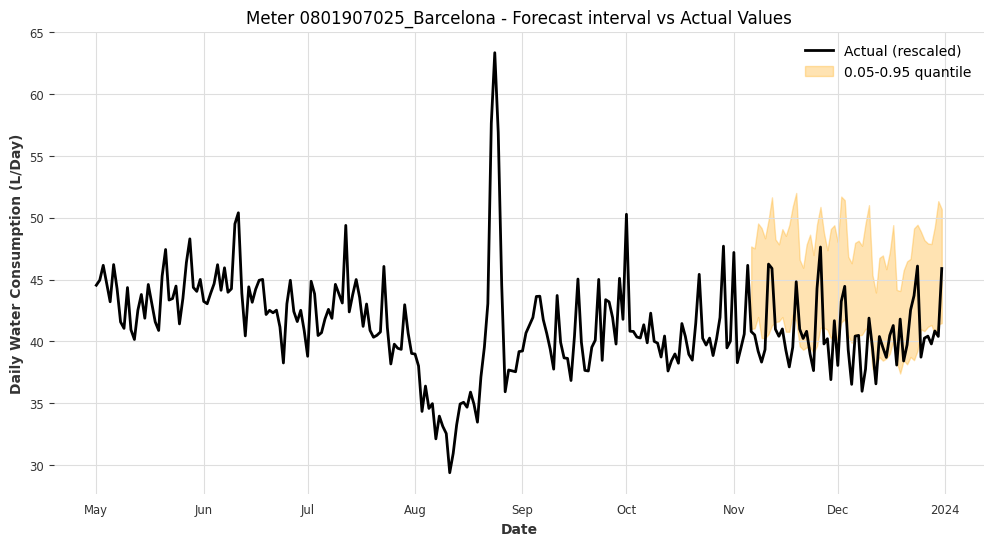

Meter 0801907025_Barcelona - Coverage: 0.4643, Width: 8.0826



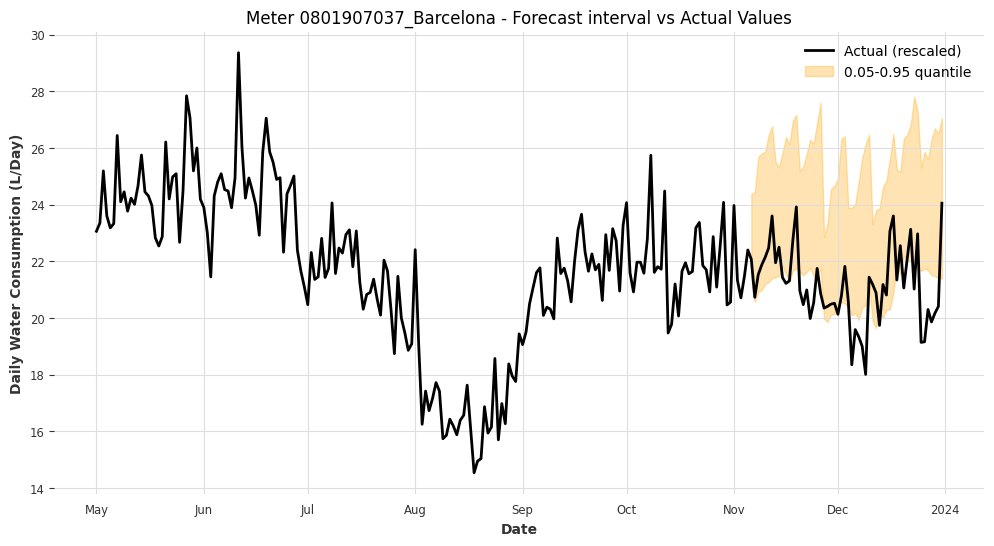

Meter 0801907037_Barcelona - Coverage: 0.5714, Width: 4.5612



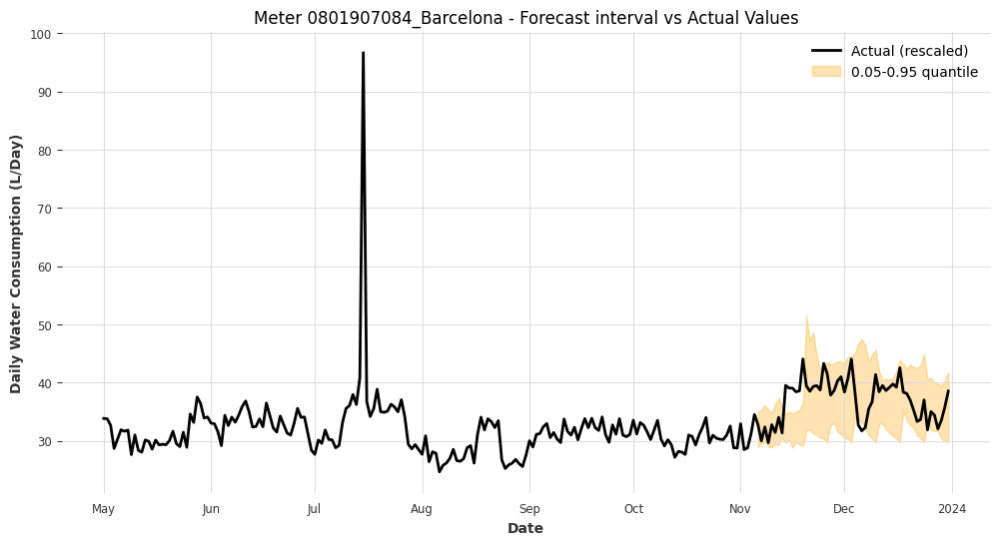

Meter 0801907084_Barcelona - Coverage: 0.8214, Width: 10.3962



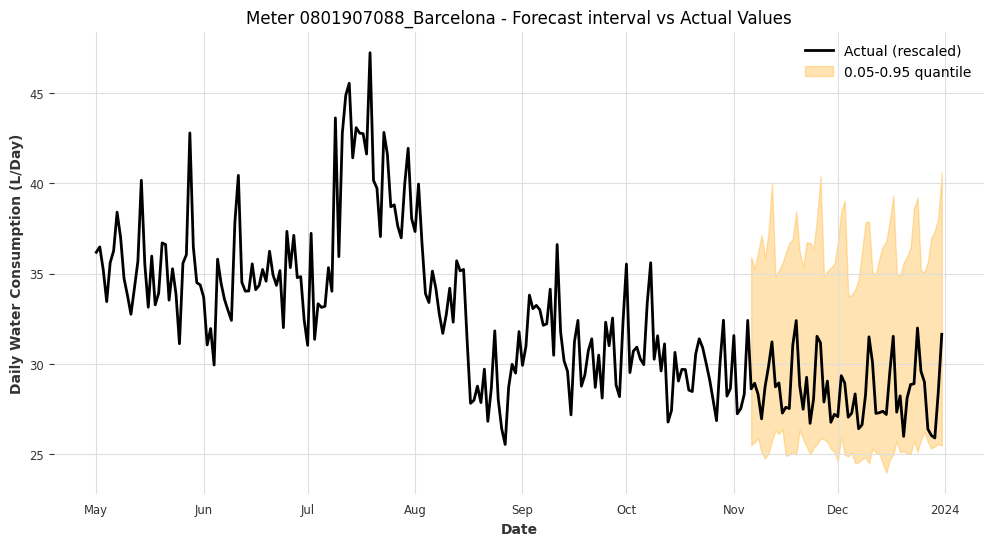

Meter 0801907088_Barcelona - Coverage: 1.0000, Width: 11.2389



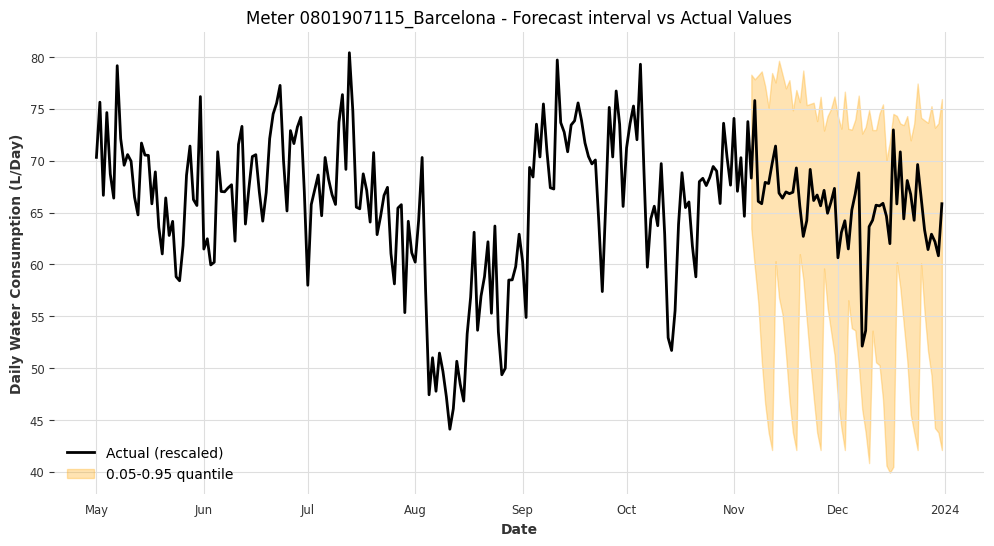

Meter 0801907115_Barcelona - Coverage: 1.0000, Width: 25.1249



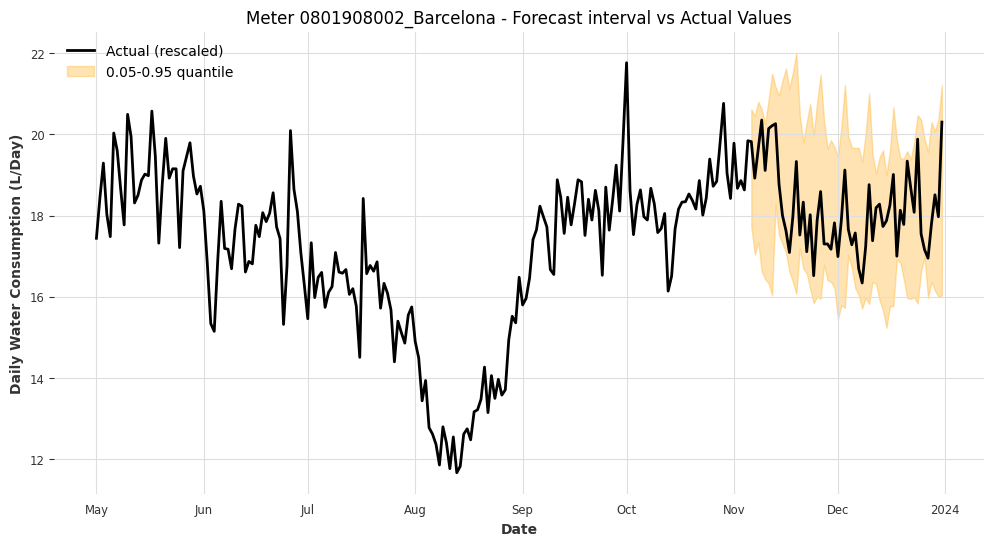

Meter 0801908002_Barcelona - Coverage: 1.0000, Width: 3.8941



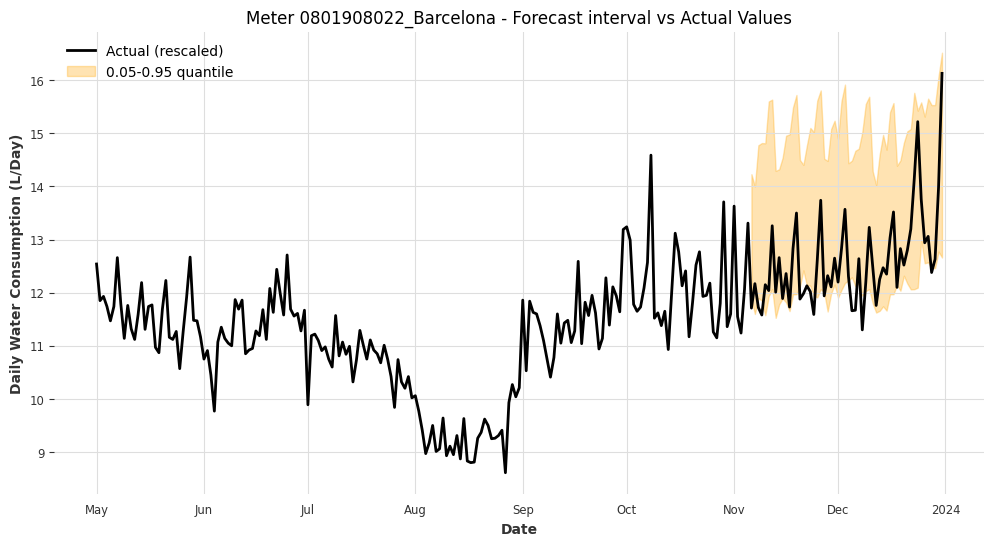

Meter 0801908022_Barcelona - Coverage: 0.7321, Width: 2.9960



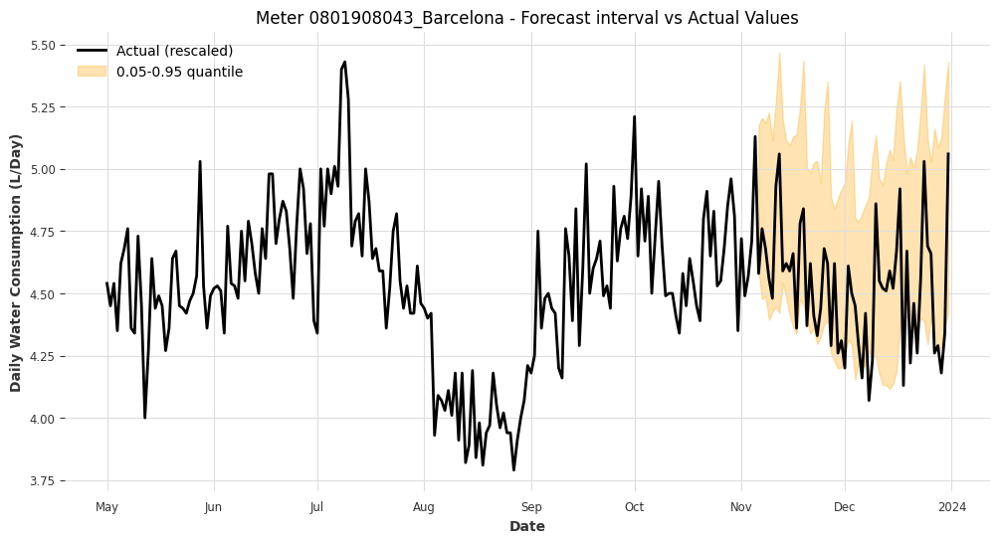

Meter 0801908043_Barcelona - Coverage: 0.7857, Width: 0.7701



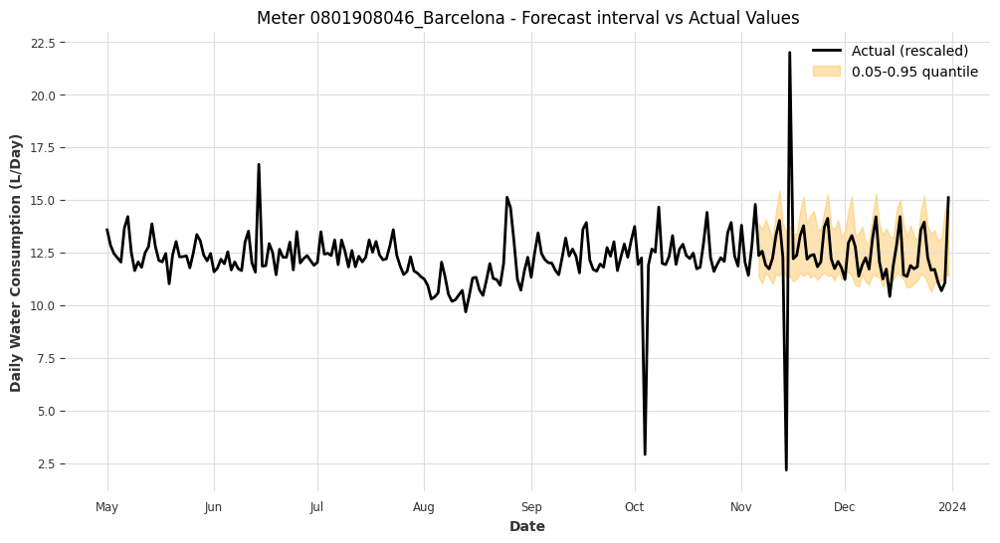

Meter 0801908046_Barcelona - Coverage: 0.8750, Width: 2.6394



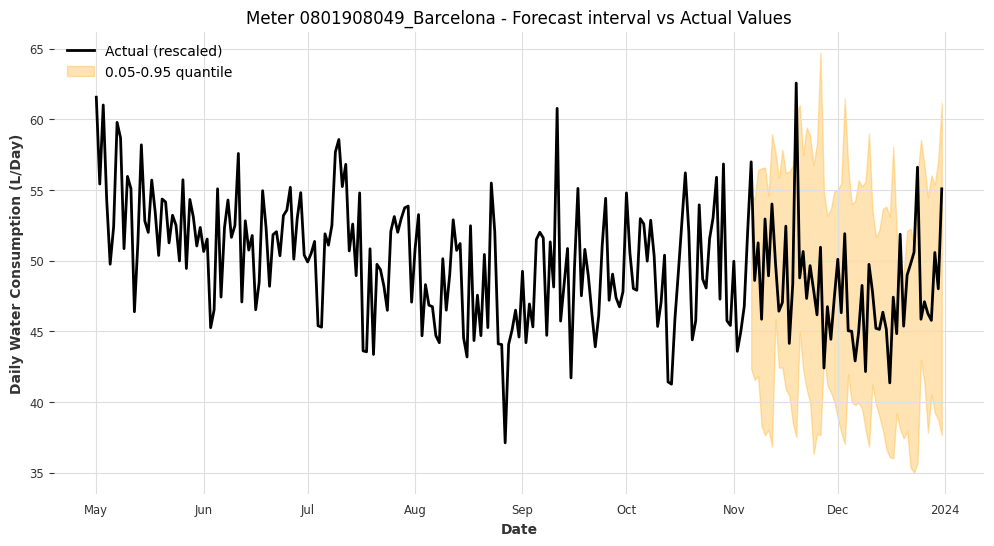

Meter 0801908049_Barcelona - Coverage: 0.9107, Width: 16.4765



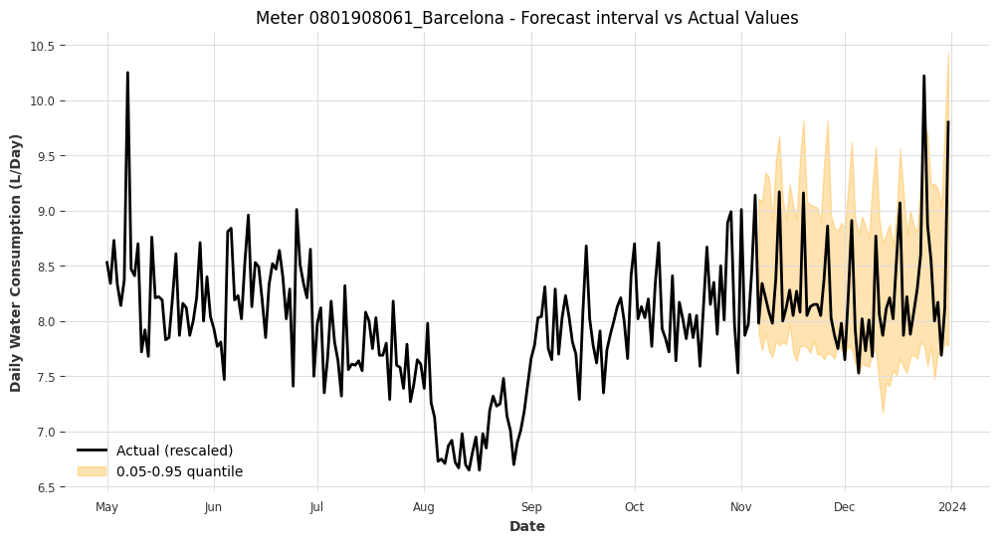

Meter 0801908061_Barcelona - Coverage: 0.9107, Width: 1.4734



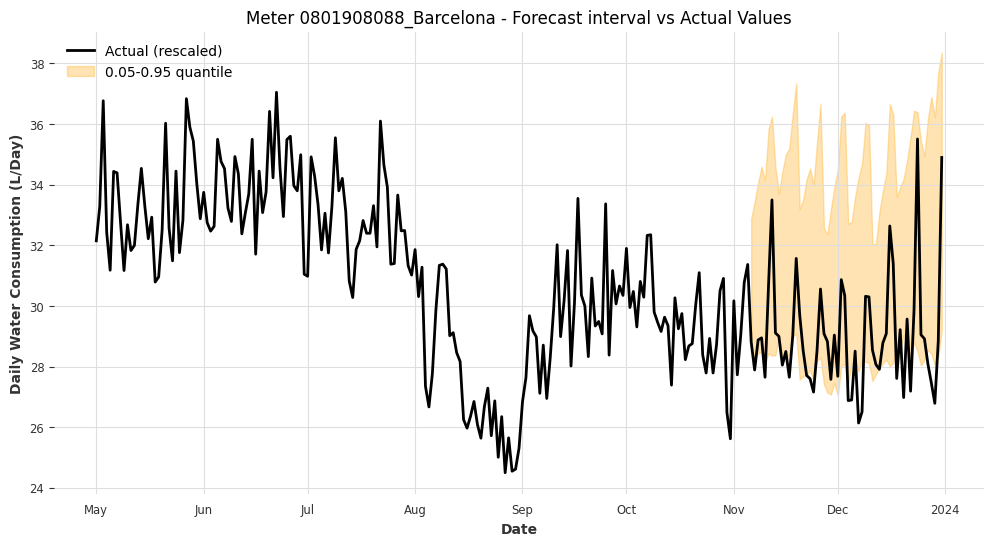

Meter 0801908088_Barcelona - Coverage: 0.6964, Width: 6.6086



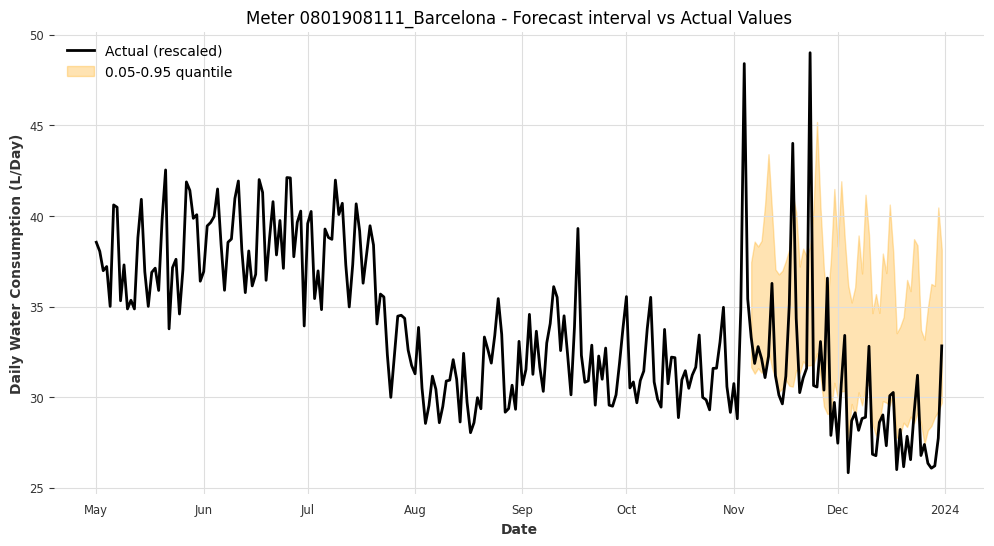

Meter 0801908111_Barcelona - Coverage: 0.3929, Width: 7.8352



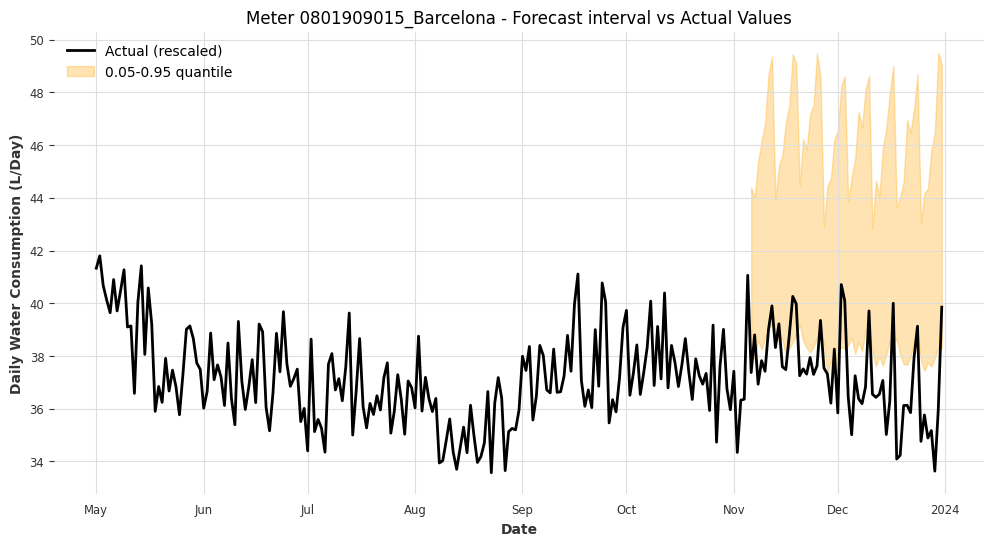

Meter 0801909015_Barcelona - Coverage: 0.2500, Width: 8.0256



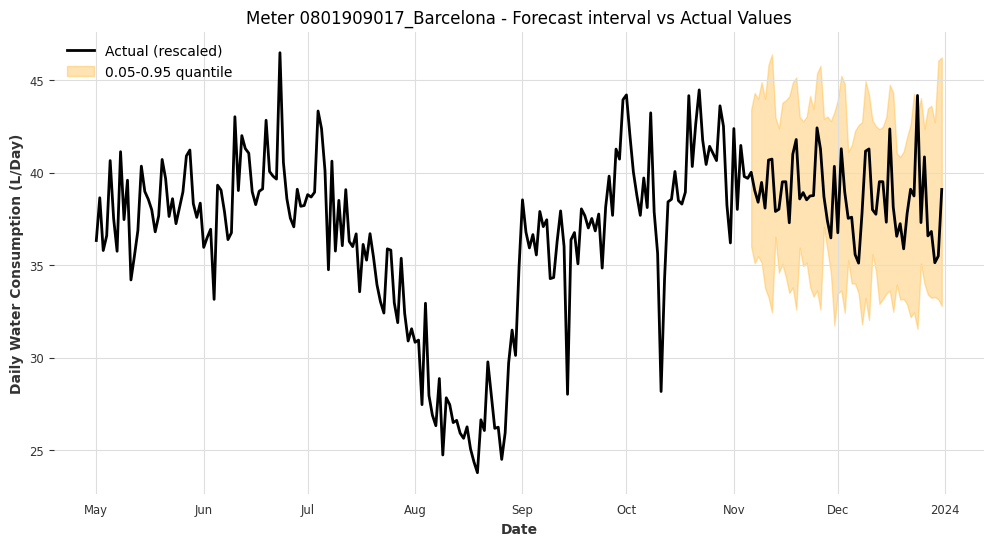

Meter 0801909017_Barcelona - Coverage: 0.9821, Width: 9.7295



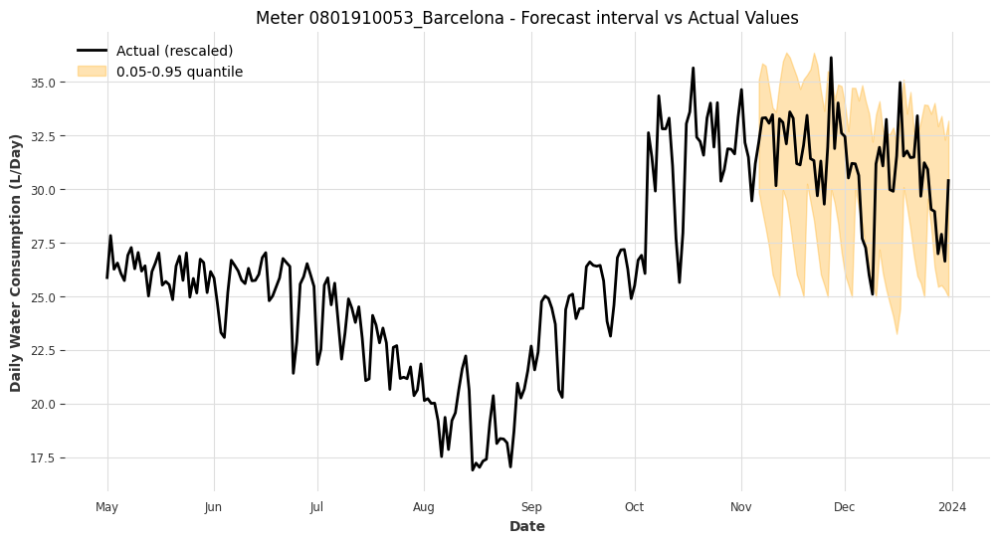

Meter 0801910053_Barcelona - Coverage: 0.8571, Width: 7.2802



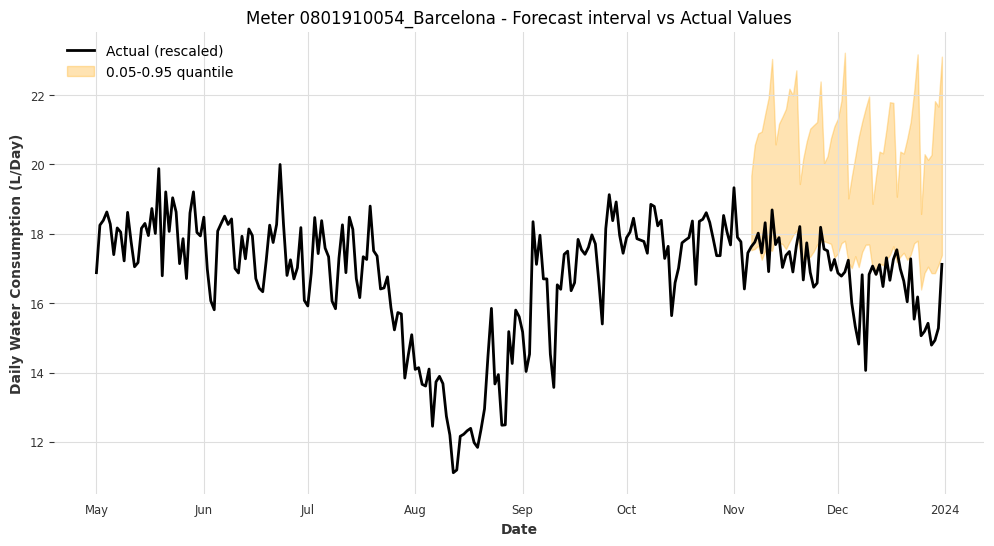

Meter 0801910054_Barcelona - Coverage: 0.2679, Width: 3.5778



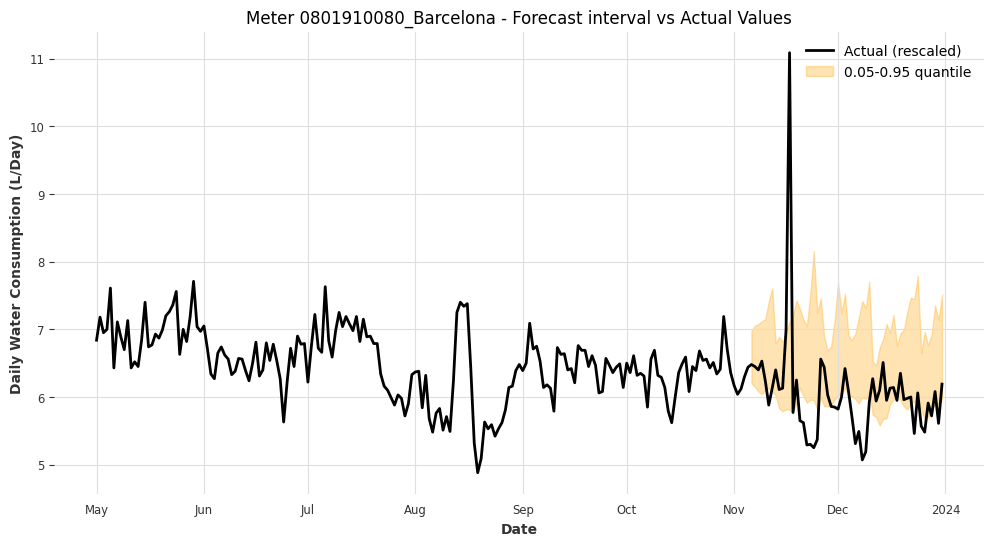

Meter 0801910080_Barcelona - Coverage: 0.5357, Width: 1.2089



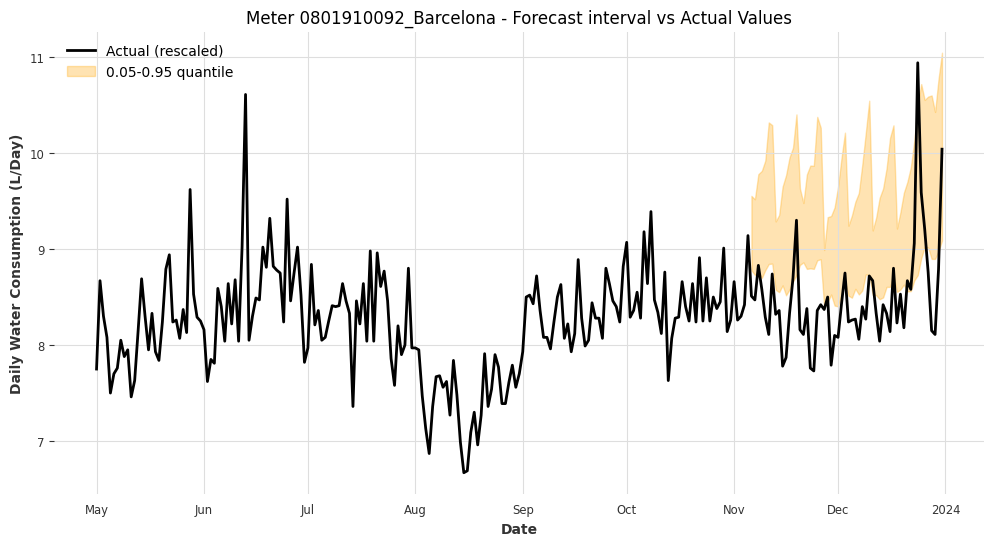

Meter 0801910092_Barcelona - Coverage: 0.2321, Width: 1.1977



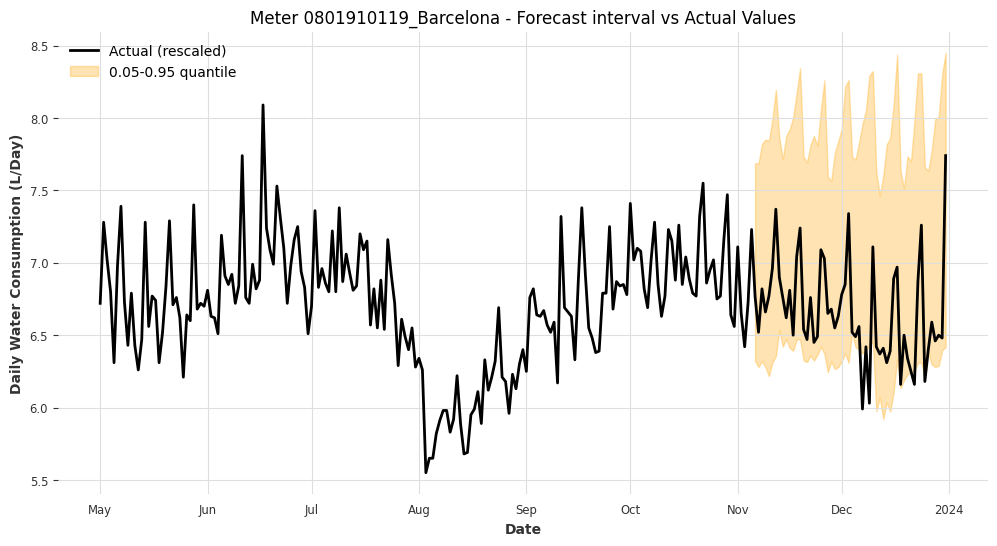

Meter 0801910119_Barcelona - Coverage: 0.9286, Width: 1.6074



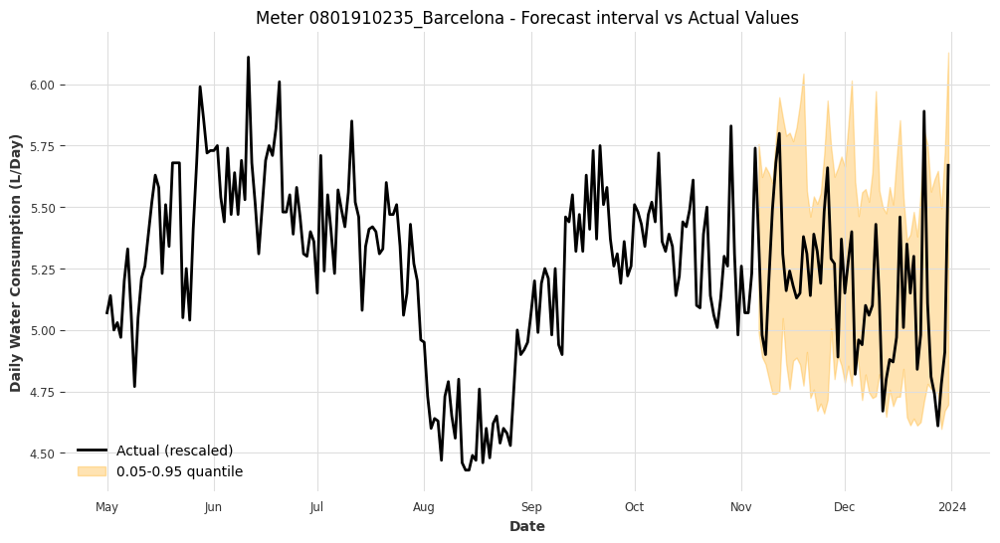

Meter 0801910235_Barcelona - Coverage: 0.8929, Width: 0.8960



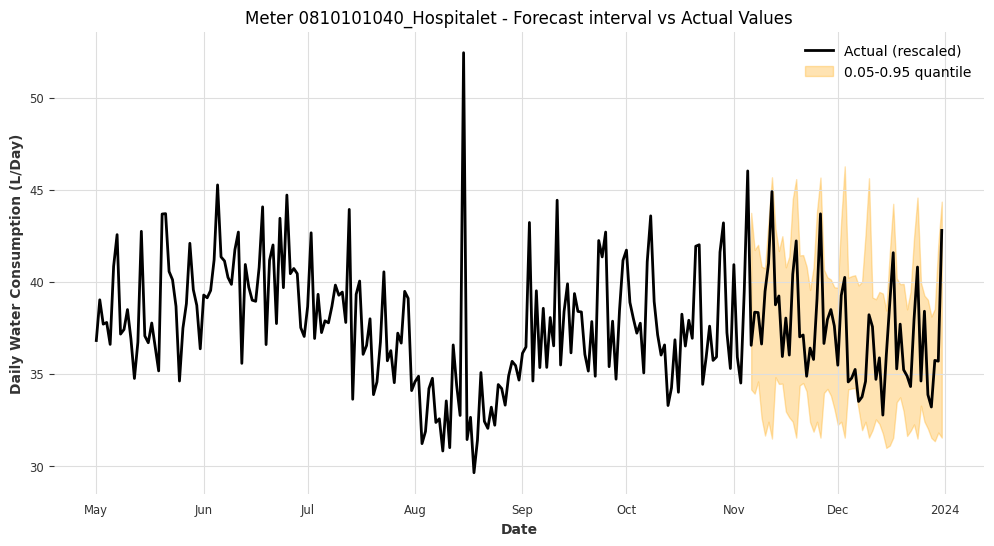

Meter 0810101040_Hospitalet - Coverage: 1.0000, Width: 8.6725



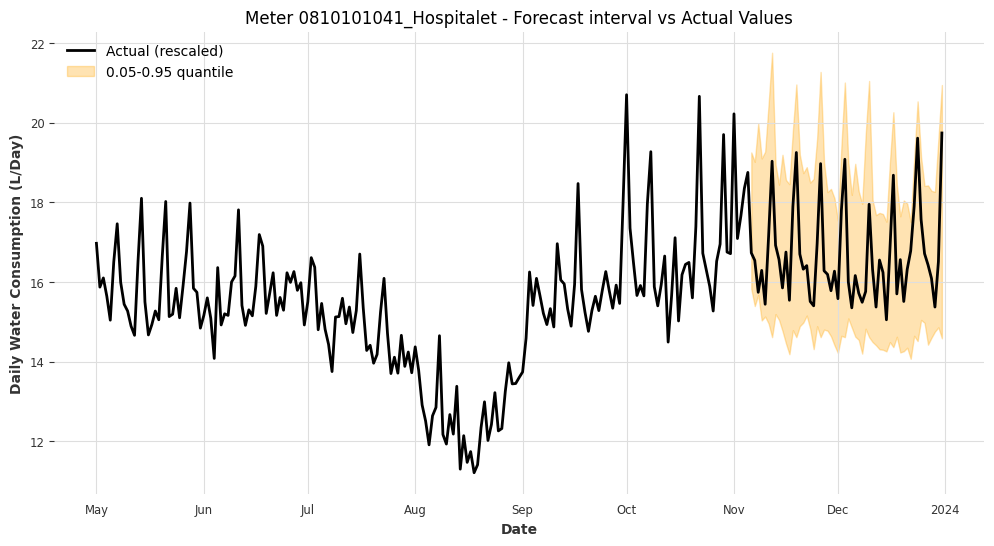

Meter 0810101041_Hospitalet - Coverage: 1.0000, Width: 4.2882



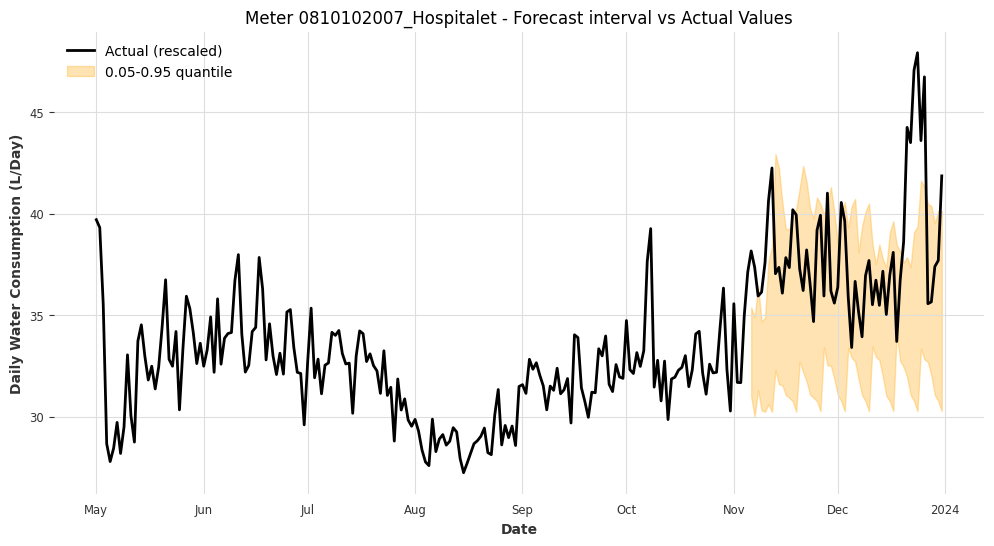

Meter 0810102007_Hospitalet - Coverage: 0.6786, Width: 7.7771



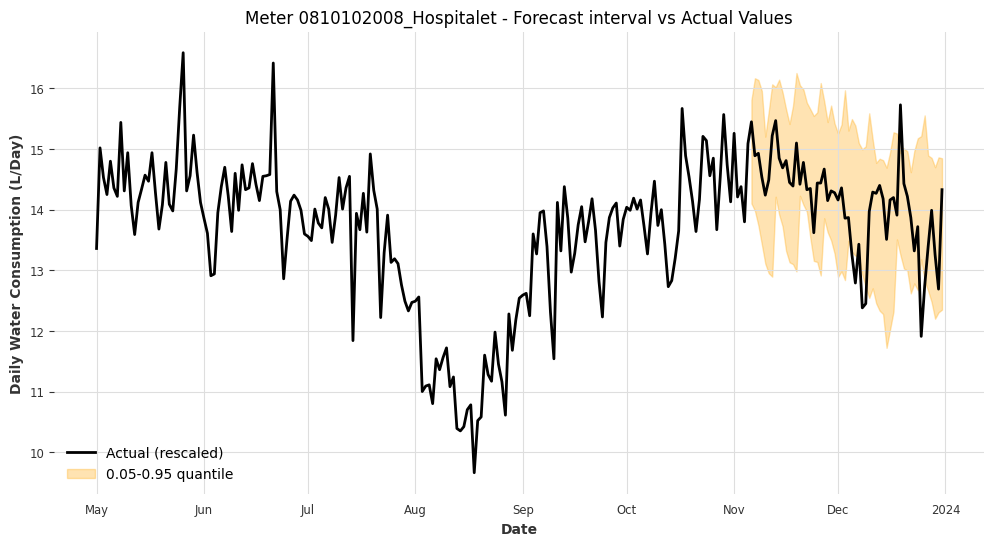

Meter 0810102008_Hospitalet - Coverage: 0.8750, Width: 2.3281



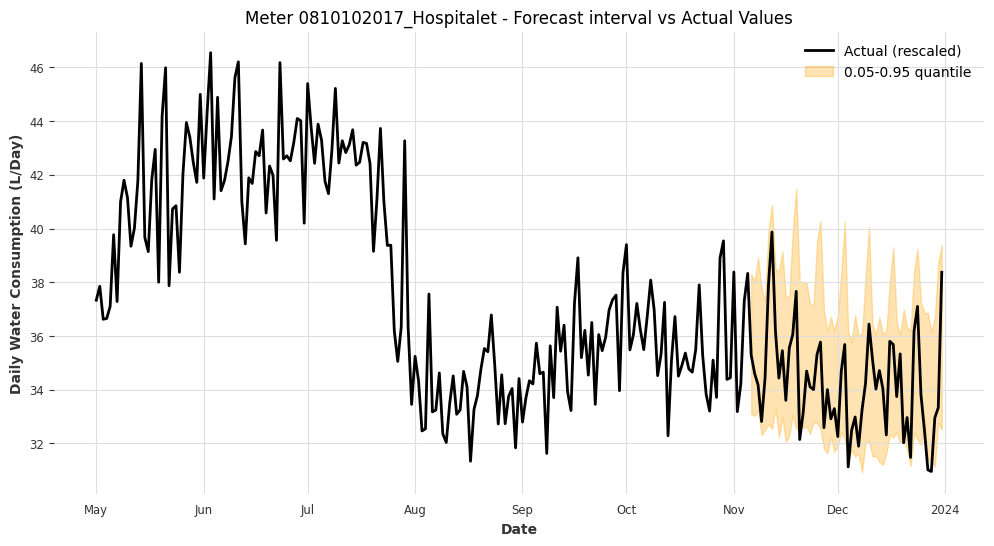

Meter 0810102017_Hospitalet - Coverage: 0.8929, Width: 5.5522



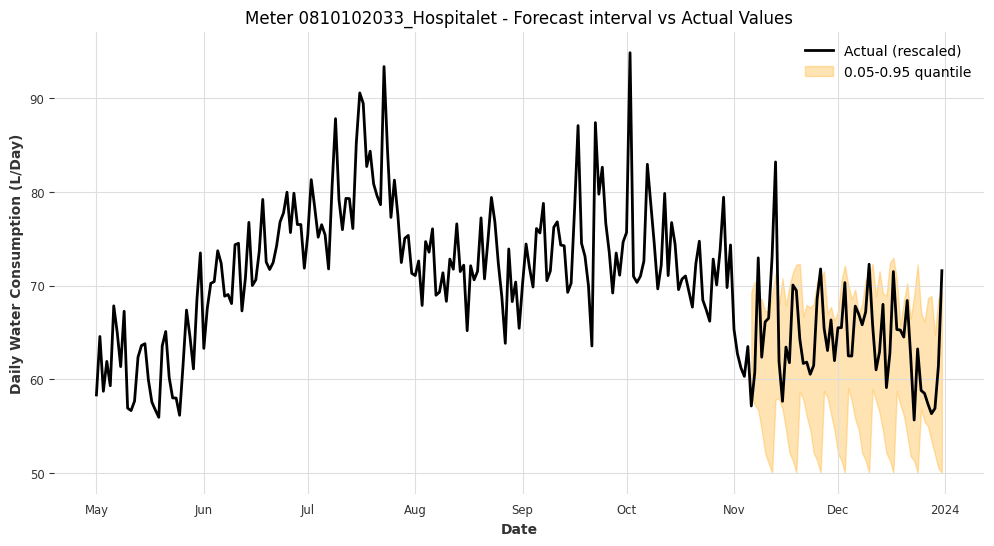

Meter 0810102033_Hospitalet - Coverage: 0.8750, Width: 14.9735



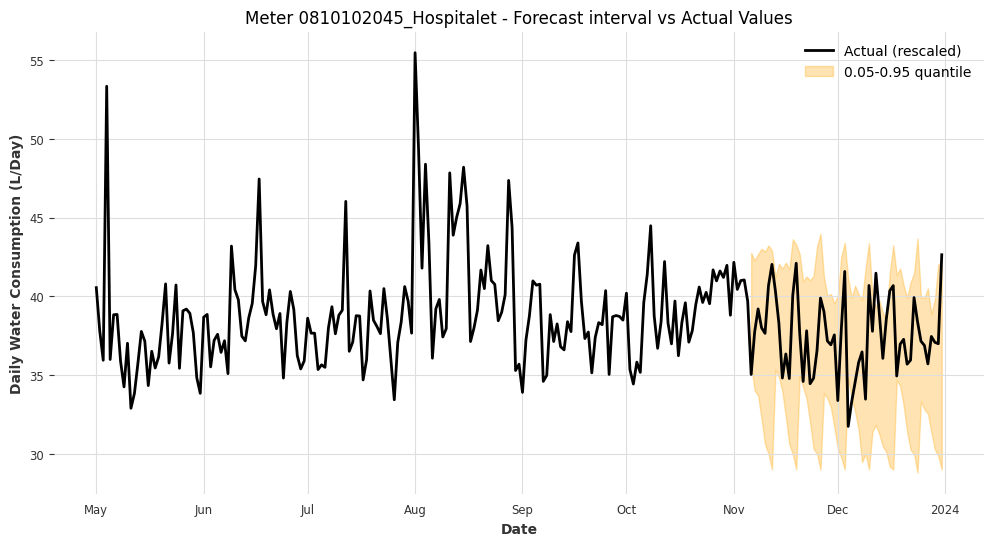

Meter 0810102045_Hospitalet - Coverage: 0.8929, Width: 9.7367



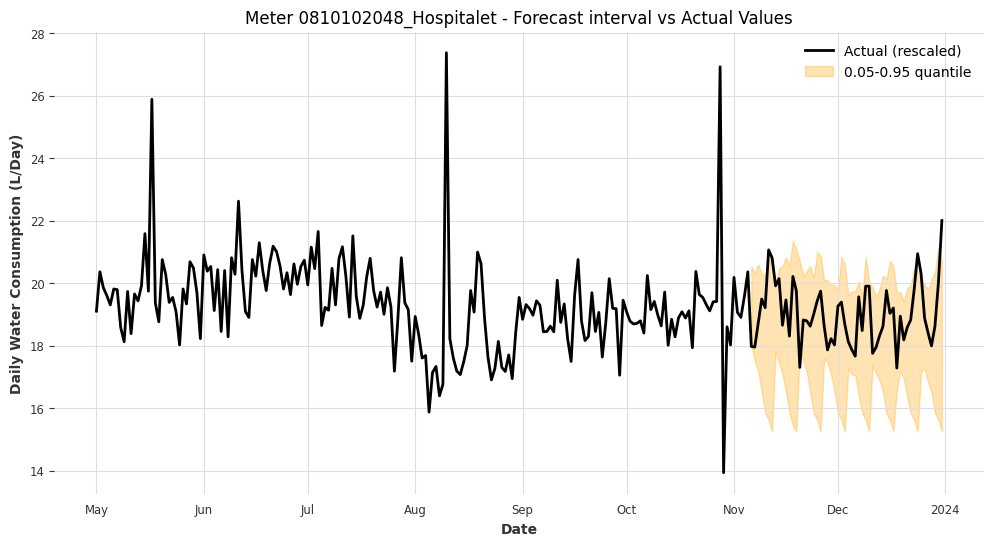

Meter 0810102048_Hospitalet - Coverage: 0.8750, Width: 3.8511



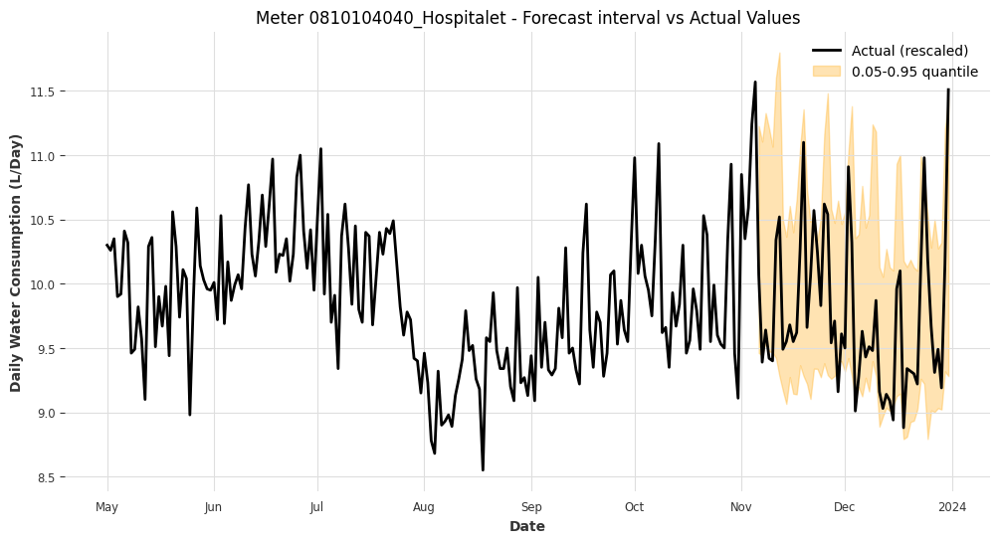

Meter 0810104040_Hospitalet - Coverage: 0.8393, Width: 1.5046



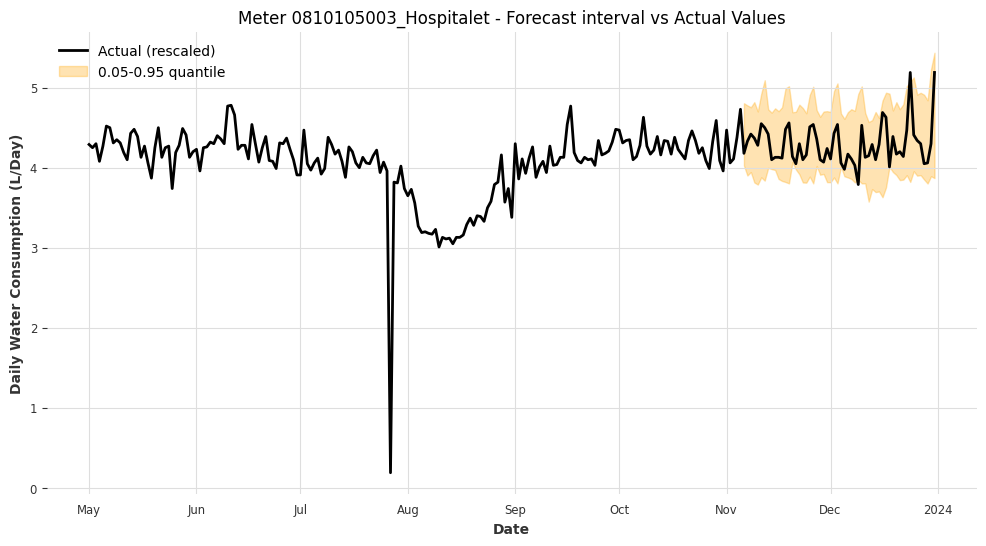

Meter 0810105003_Hospitalet - Coverage: 0.9464, Width: 0.9615



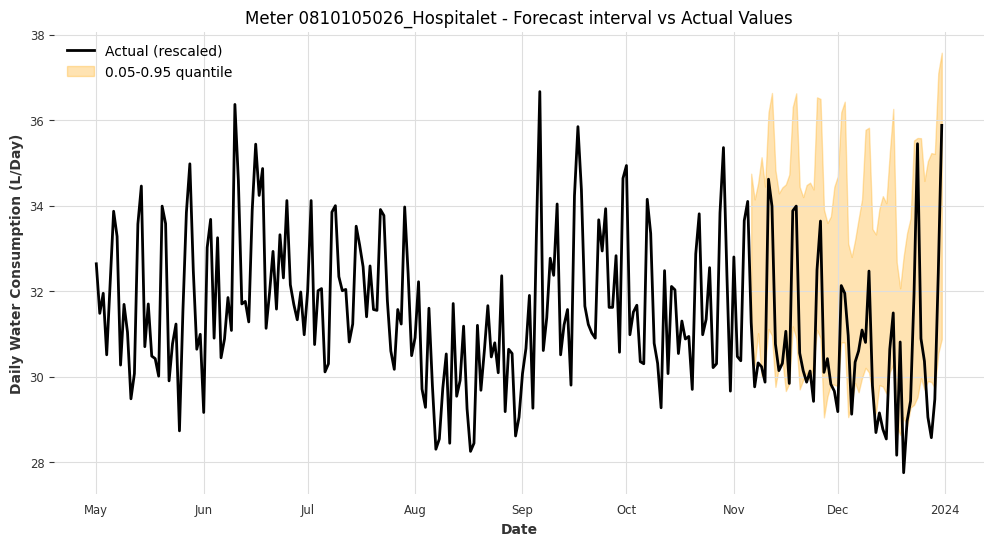

Meter 0810105026_Hospitalet - Coverage: 0.6607, Width: 4.7549



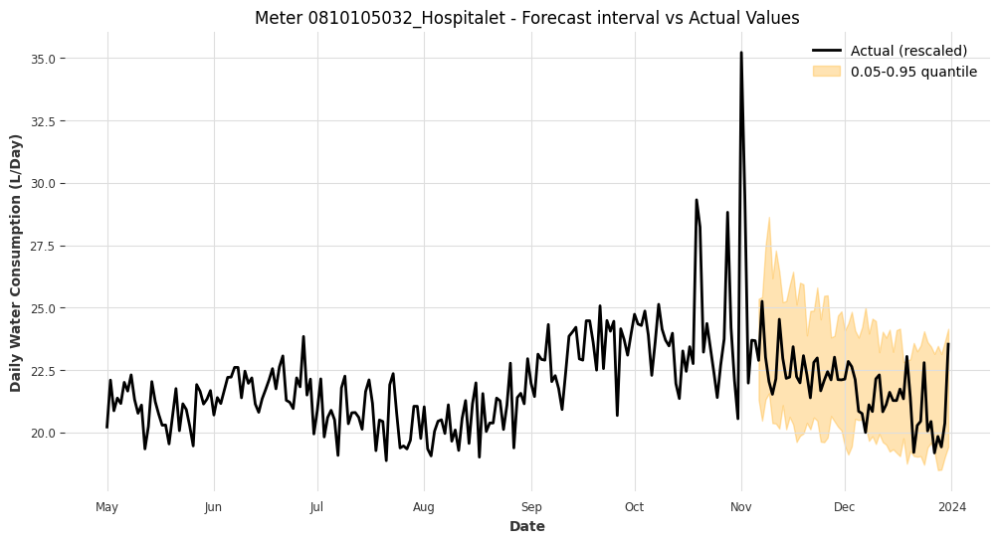

Meter 0810105032_Hospitalet - Coverage: 0.9464, Width: 4.7429



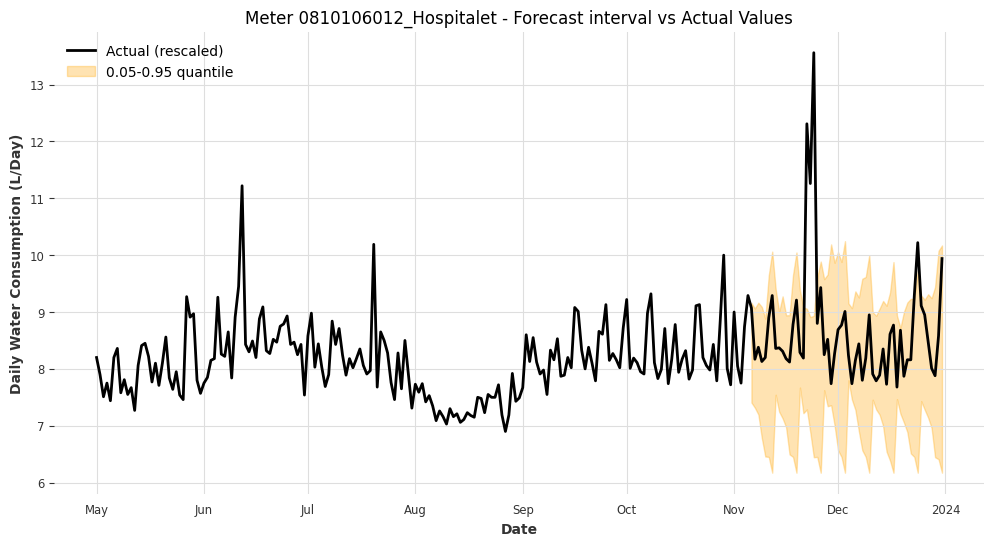

Meter 0810106012_Hospitalet - Coverage: 0.9107, Width: 2.5213



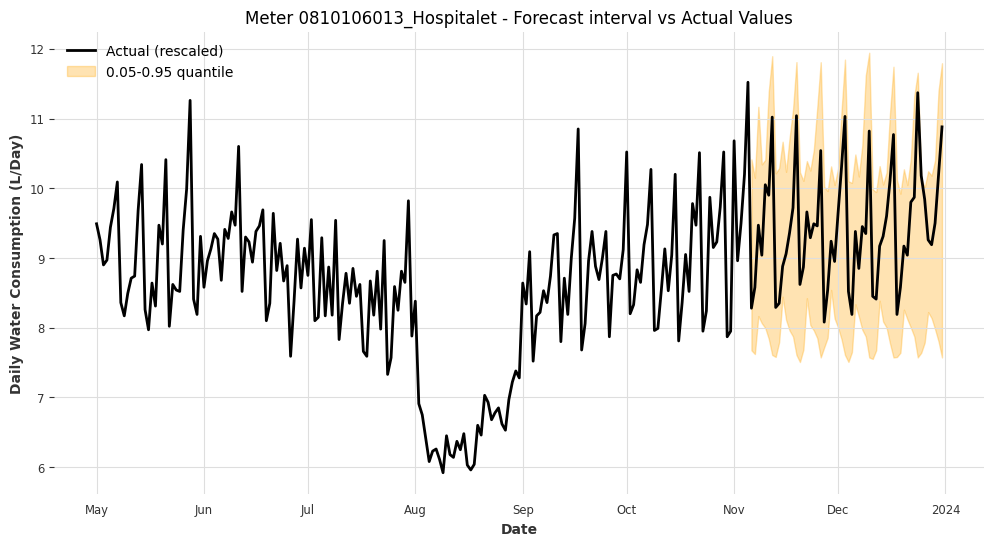

Meter 0810106013_Hospitalet - Coverage: 0.9821, Width: 2.7452



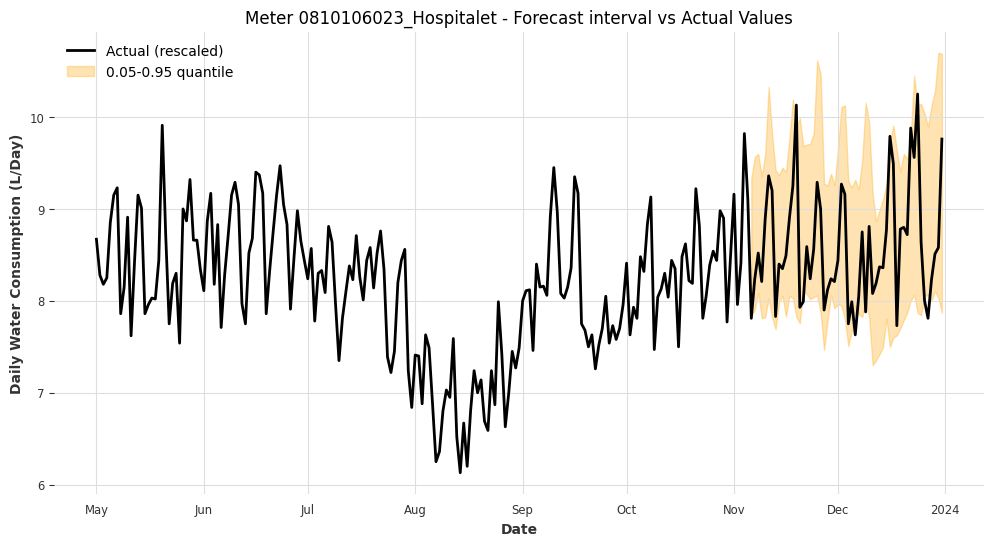

Meter 0810106023_Hospitalet - Coverage: 0.8214, Width: 1.8698



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # Darts utility to merge TimeSeries

for meter_id, hfcs in all_hfcs.items():
    # Get the actual time series
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width = df_result["Width rescaled"].iloc[0]

    # Start a new plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    full_lower = []
    full_upper = []

    # Collect lower and upper quantiles from each forecast window
    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components
            and 'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)


    if full_lower and full_upper:
        # Concatenate all the TimeSeries pieces into full series
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        # Plot the quantile area as a filled region
        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05-0.95 quantile'
        )

    ax.set_title(f"Meter {meter_id} - Forecast interval vs Actual Values")
    ax.set_ylabel("Daily Water Consumption (L/Day)")  # <-- Add this line

    ax.legend()
    plt.show()

    # Print the metrics below each plot
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Width: {width:.4f}\n")

In [ ]:
# Let's try with a improved version of the test set (more real time series)

In [ ]:
# Load model
model = LightGBMModel.load("/content/drive/MyDrive/Colab Notebooks/TFG/data/02_models/lightGBM/simple/lightgbm_model.pkl")
# We load the test data
test_data = joblib.load('/content/drive/MyDrive/Colab Notebooks/TFG/data/01_datasets/train_test_reduced/scaled_test_reduced.pkl')
print(test_data.keys())

# Extract components
scaled_calib_test_series = test_data['calib_test']
scalers_test = test_data['scalers']           # the scalers to reescale the series later

# Reuse the same sorted meter IDs to align
meter_ids_test = sorted(scaled_calib_test_series.keys())

# Build aligned lists
test_series_scaled = [scaled_calib_test_series[meter_id] for meter_id in meter_ids_test]

print(f"Loaded {len(test_series_scaled)} time series for testing.")

dict_keys(['train', 'validation', 'calib_test', 'scalers'])
Loaded 60 time series for testing.


In [ ]:
# Constants
start_date = pd.Timestamp("2023-11-6")
quantiles = [0.05, 0.5, 0.95]
pred_kwargs={"predict_likelihood_parameters": True, "verbose": True}
q_interval = [(0.05, 0.95)]
q_range = [0.9]

# Prepare to collect results
all_hfcs = {}
all_bt_results = {}

# We loop over each time series (one per meter)
for meter_id, ts in zip(meter_ids_test, test_series_scaled):
    # Historical forecasts
    hfcs = model.historical_forecasts(
        series=ts,
        forecast_horizon=7,
        start=pd.Timestamp("2023-11-6"),
        last_points_only=False,
        stride=7,
        retrain=False,
        **pred_kwargs,
    )

    scaler = scalers_test[meter_id]
    widths = []

    for forecast in hfcs:
        q05 = forecast["Consumption per meter_q0.05"]
        q95 = forecast["Consumption per meter_q0.95"]
        q05_orig = scaler.inverse_transform(q05)
        q95_orig = scaler.inverse_transform(q95)
        width = (q95_orig - q05_orig).values()
        widths.append(width)

    mean_width = np.mean([np.mean(w) for w in widths])


    # We backtest (evaluate) the generated predictions
    bt = model.backtest(
        ts,
        historical_forecasts=hfcs,
        last_points_only=False,
        metric=[metrics.mic, metrics.miw],
        metric_kwargs={"q_interval": q_interval},
        retrain = False
    )
    df_results = pd.DataFrame({"Interval": q_range, "Coverage": bt[0], "Width": bt[1], "Width rescaled": mean_width})

    # Store results
    all_hfcs[meter_id] = hfcs
    all_bt_results[meter_id] = df_results

# We combine results across meters
combined_results = pd.concat(all_bt_results.values(), keys=all_bt_results.keys())
combined_results.reset_index(level=1, drop=True, inplace=True)


historical forecasts: 100%|██████████| 1/1 [00:00<00:00, 26.67it/s]


In [ ]:
mean_coverage = combined_results["Coverage"].mean()
mean_width = combined_results["Width"].mean()
mean_width_rescaled = combined_results["Width rescaled"].mean()

print(f"Mean Coverage: {mean_coverage:.4f}")
print(f"Mean Width: {mean_width:.4f}")
print(f"Mean Width rescaled: {mean_width_rescaled:.4f}")

Mean Coverage: 0.9036
Mean Width: 0.3265
Mean Width rescaled: 4.7751


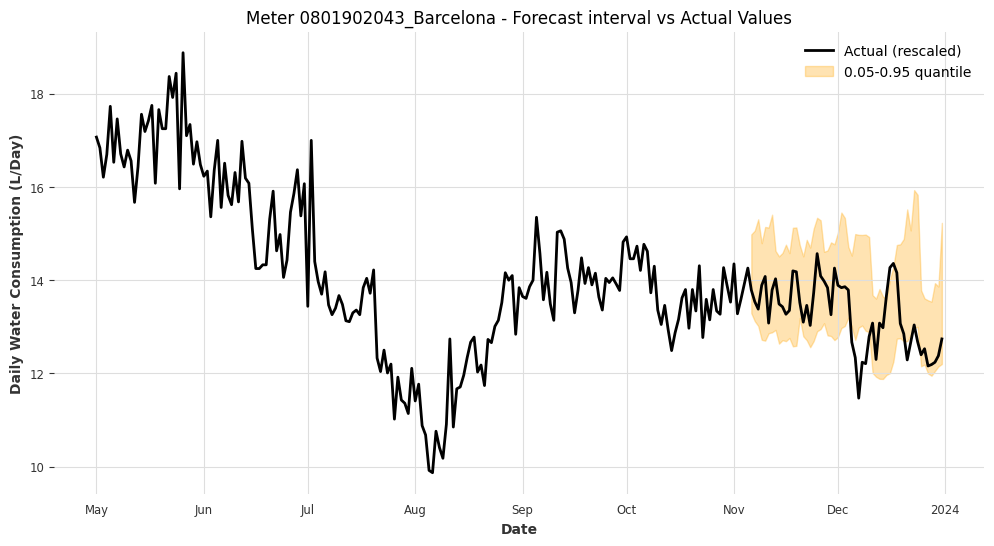

Meter 0801902043_Barcelona - Coverage: 0.7857, Width: 2.0499



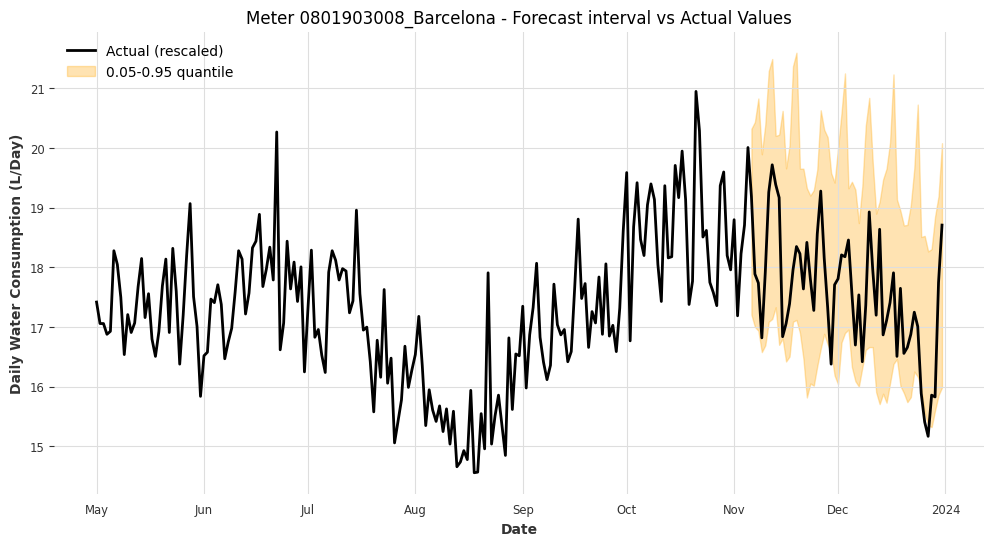

Meter 0801903008_Barcelona - Coverage: 0.9286, Width: 3.4480



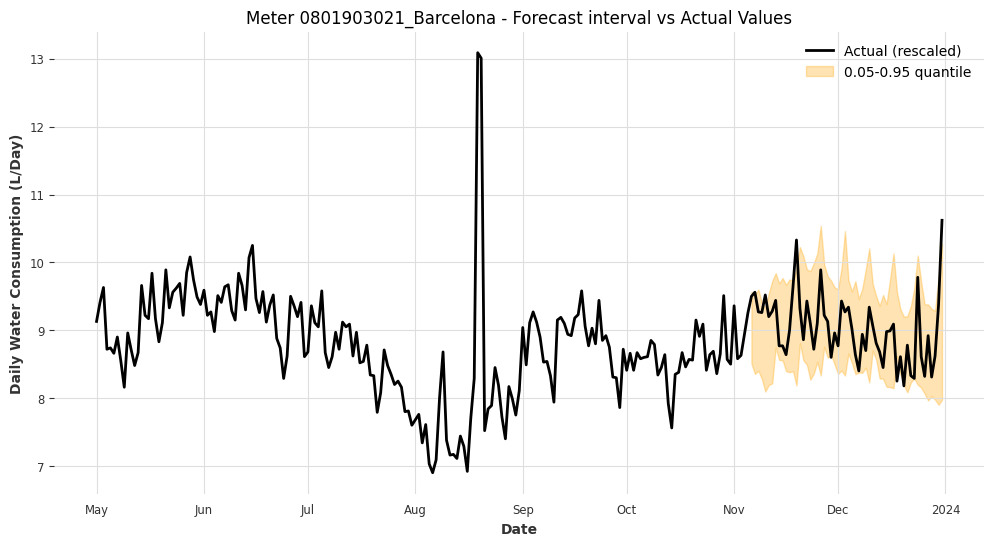

Meter 0801903021_Barcelona - Coverage: 0.8750, Width: 1.3641



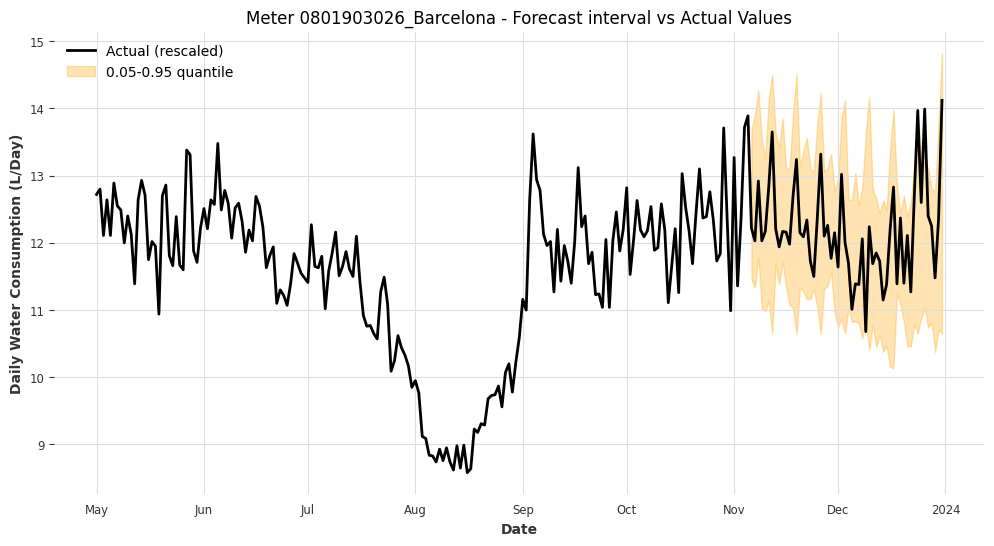

Meter 0801903026_Barcelona - Coverage: 0.9464, Width: 2.4007



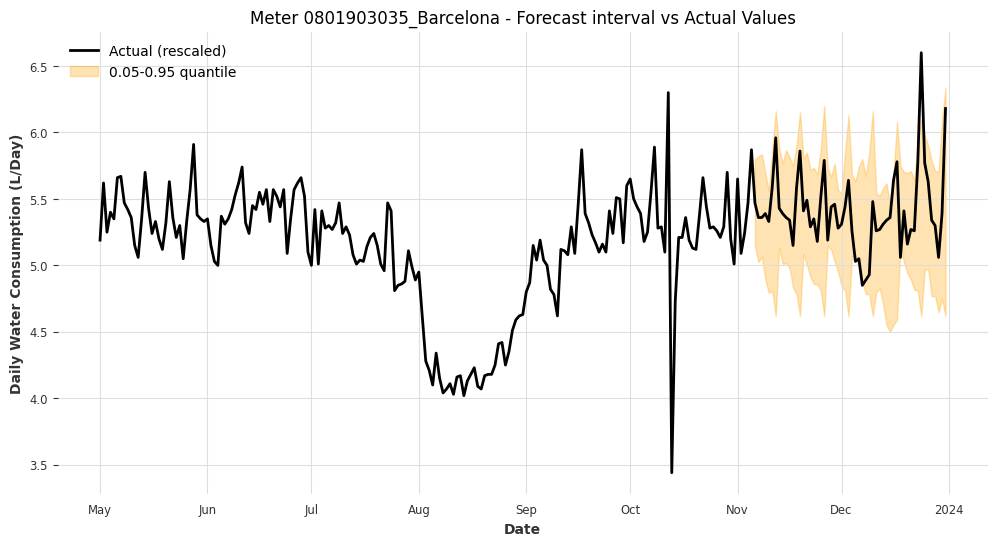

Meter 0801903035_Barcelona - Coverage: 0.9286, Width: 0.9502



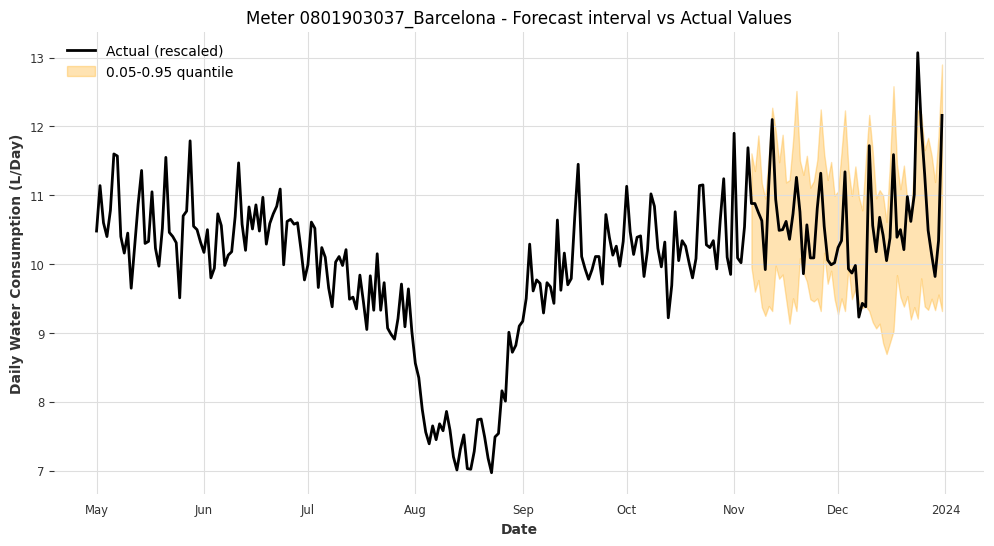

Meter 0801903037_Barcelona - Coverage: 0.8929, Width: 2.0410



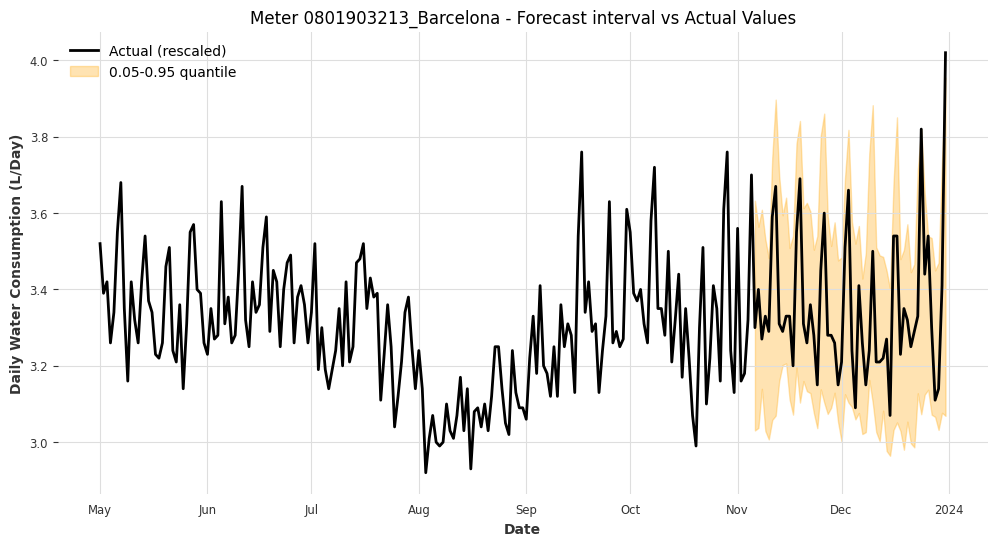

Meter 0801903213_Barcelona - Coverage: 0.9643, Width: 0.5341



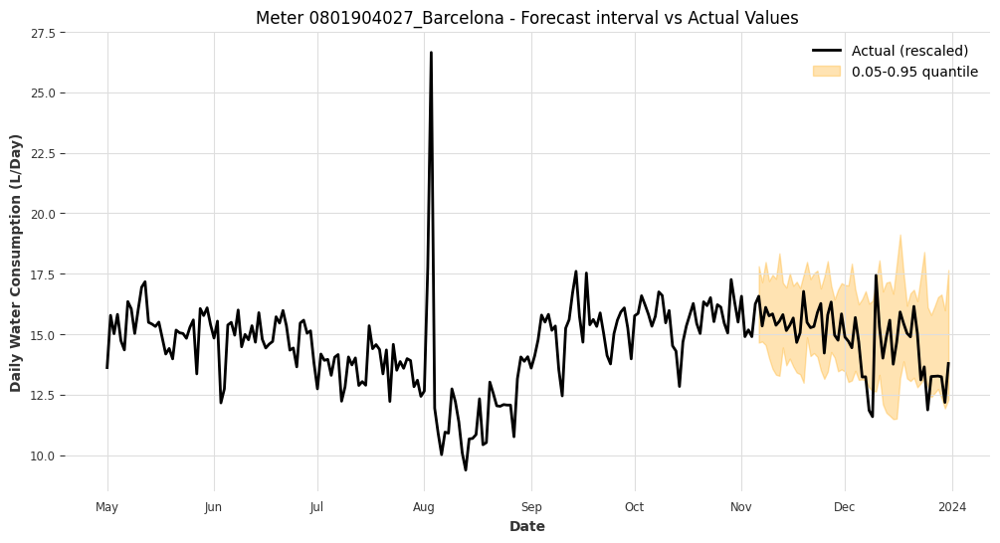

Meter 0801904027_Barcelona - Coverage: 0.9286, Width: 3.8800



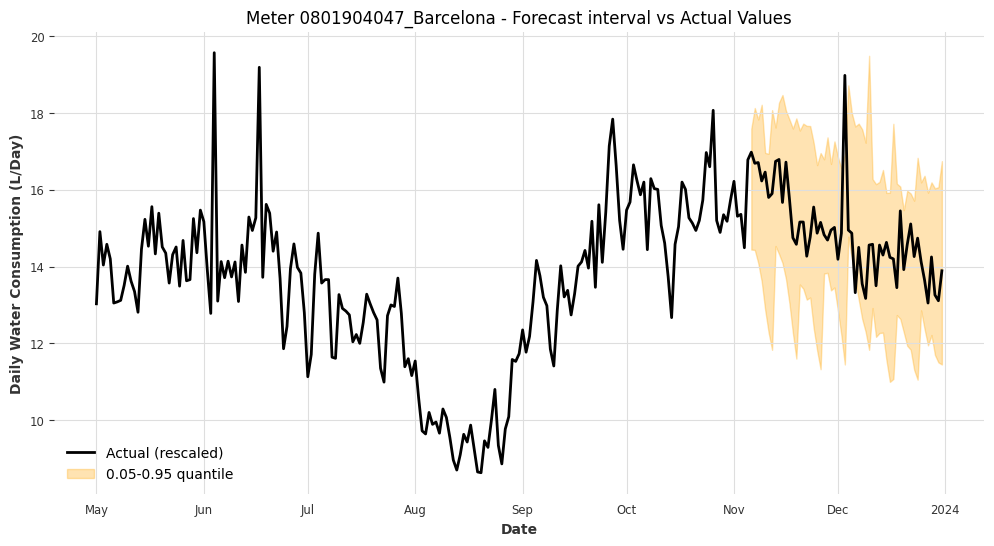

Meter 0801904047_Barcelona - Coverage: 0.9643, Width: 4.3821



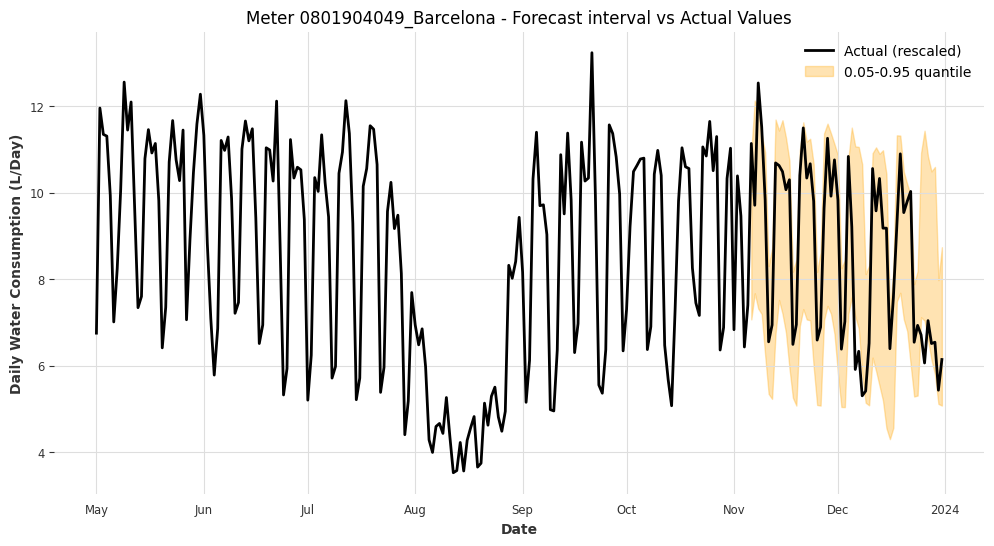

Meter 0801904049_Barcelona - Coverage: 0.8214, Width: 4.0375



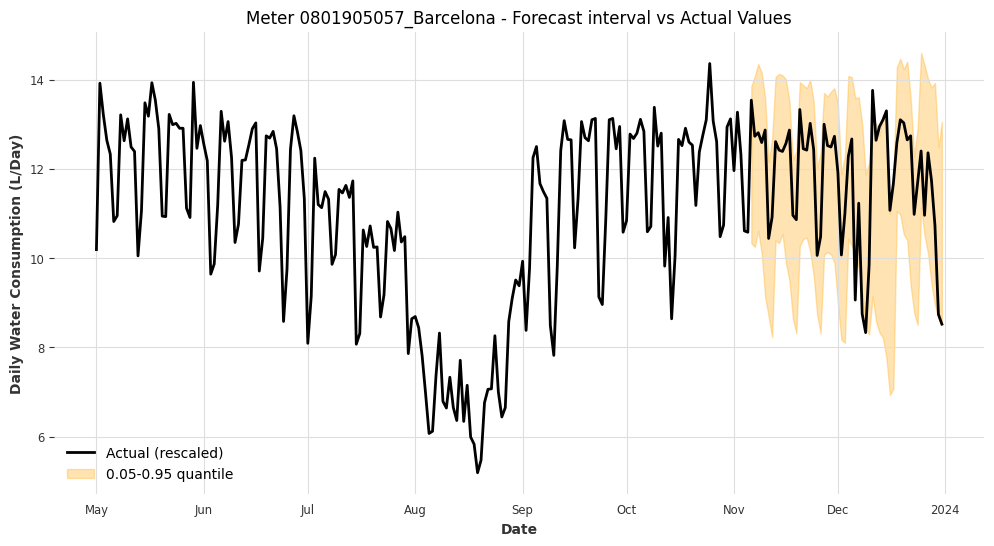

Meter 0801905057_Barcelona - Coverage: 0.8750, Width: 3.9264



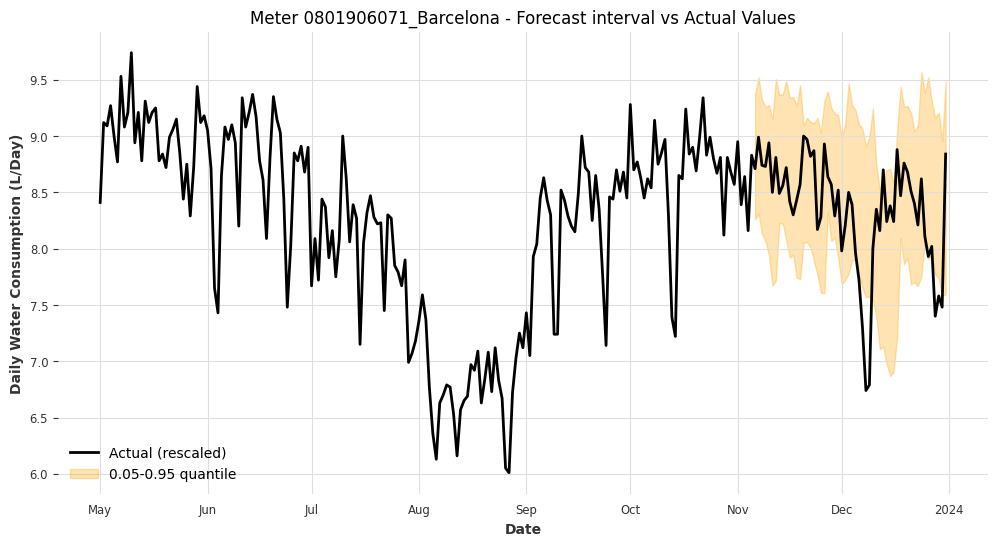

Meter 0801906071_Barcelona - Coverage: 0.8571, Width: 1.4099



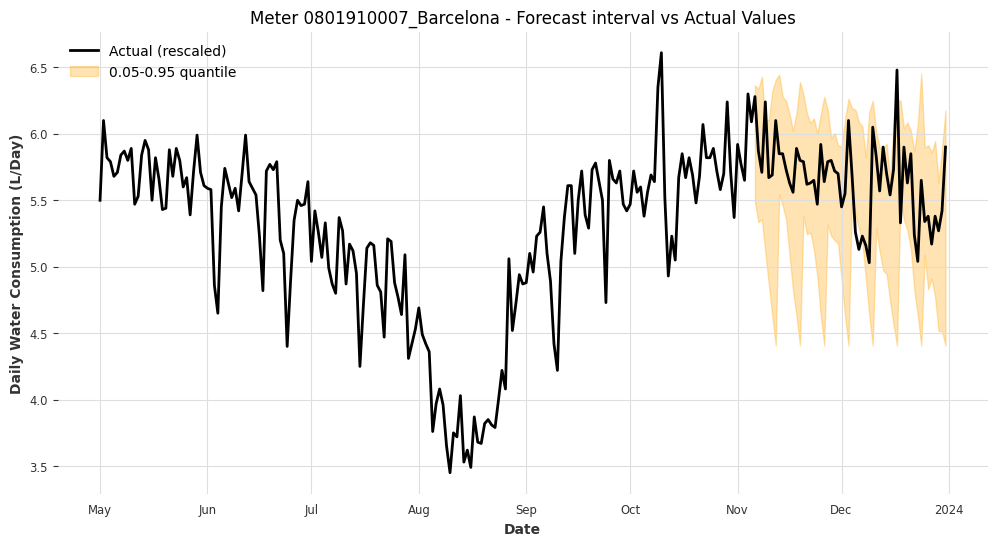

Meter 0801910007_Barcelona - Coverage: 0.8929, Width: 1.1394



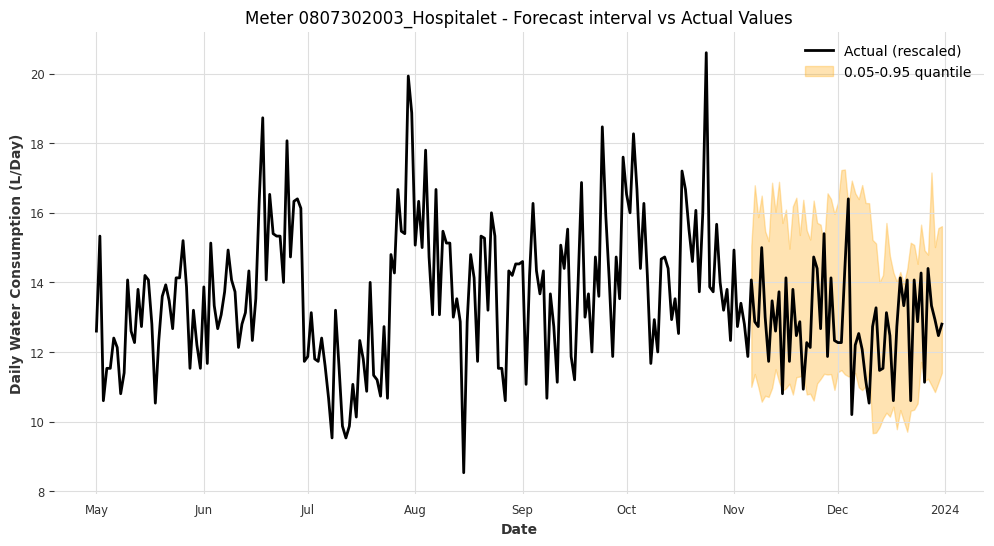

Meter 0807302003_Hospitalet - Coverage: 0.8750, Width: 4.8113



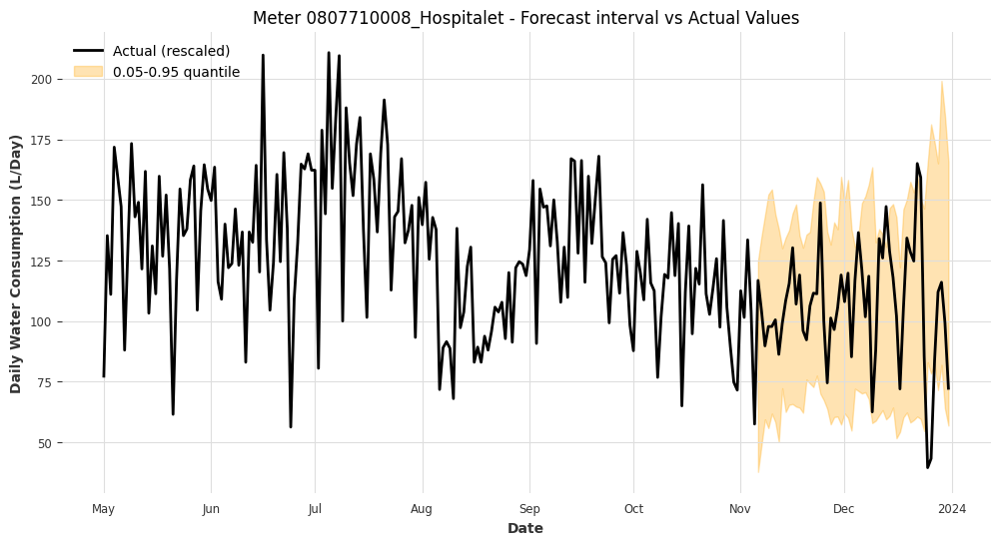

Meter 0807710008_Hospitalet - Coverage: 0.8929, Width: 84.2176



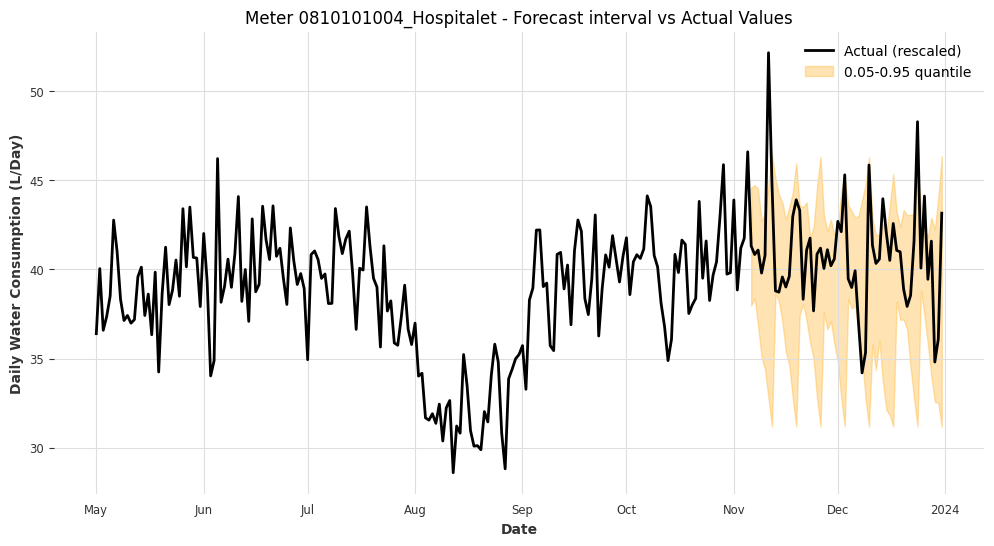

Meter 0810101004_Hospitalet - Coverage: 0.8571, Width: 8.5829



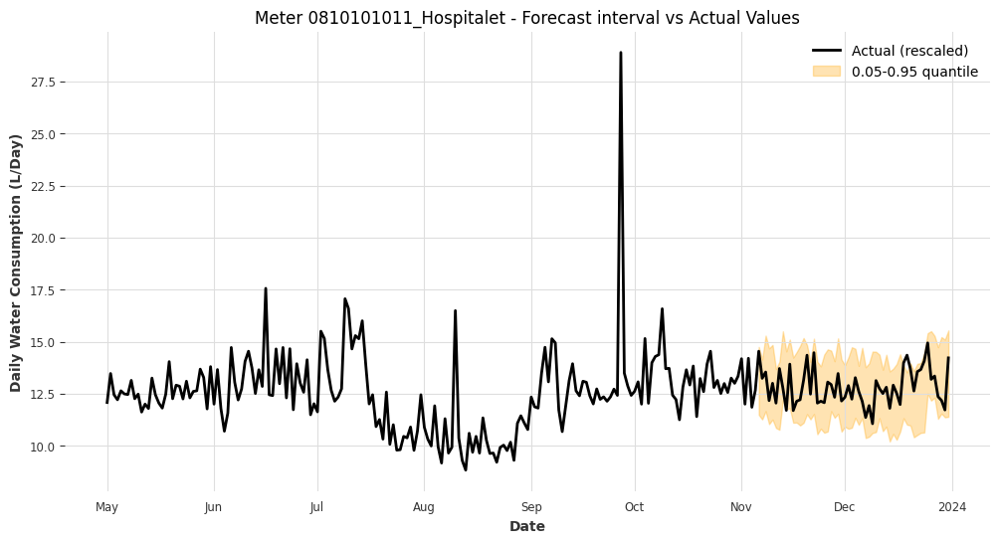

Meter 0810101011_Hospitalet - Coverage: 0.9464, Width: 3.3430



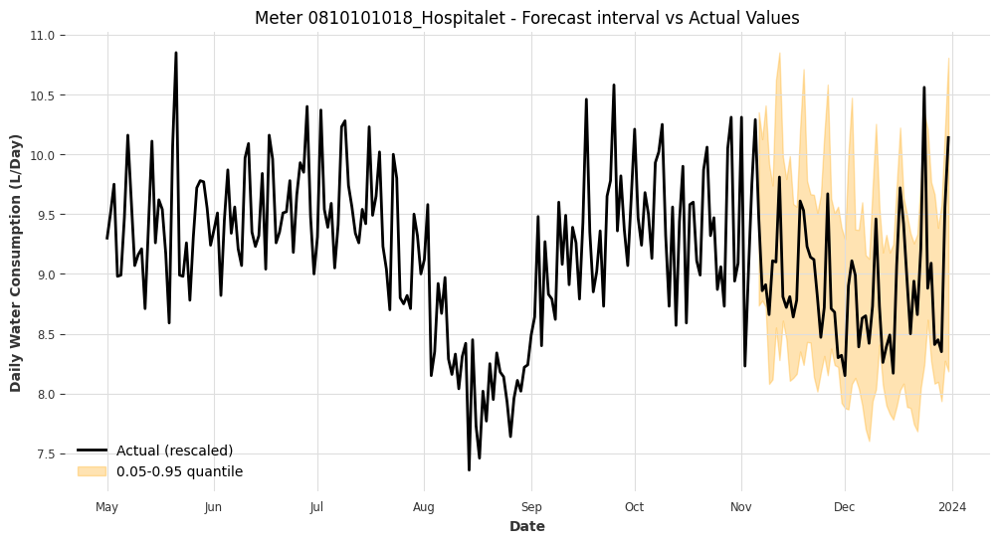

Meter 0810101018_Hospitalet - Coverage: 0.9821, Width: 1.6551



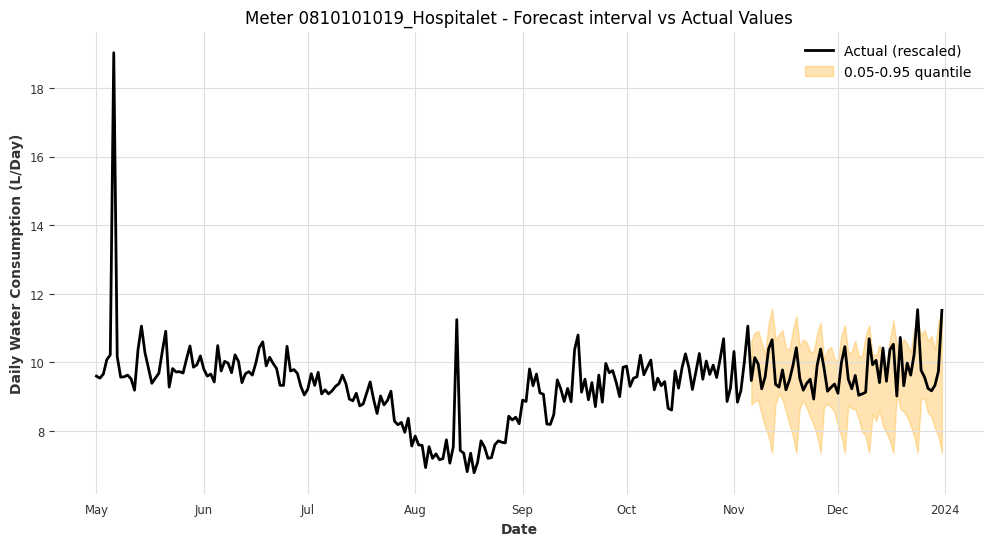

Meter 0810101019_Hospitalet - Coverage: 0.9107, Width: 2.3670



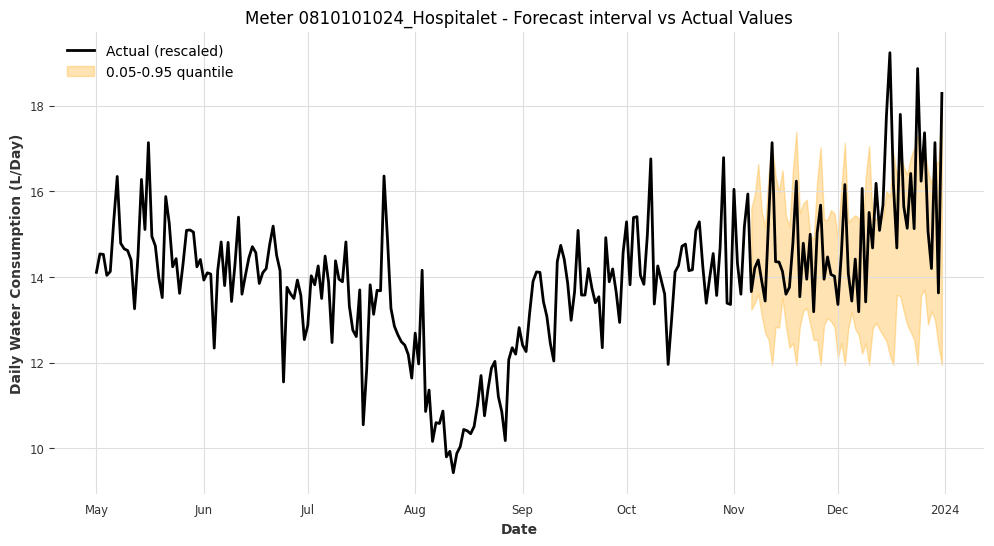

Meter 0810101024_Hospitalet - Coverage: 0.7857, Width: 3.3379



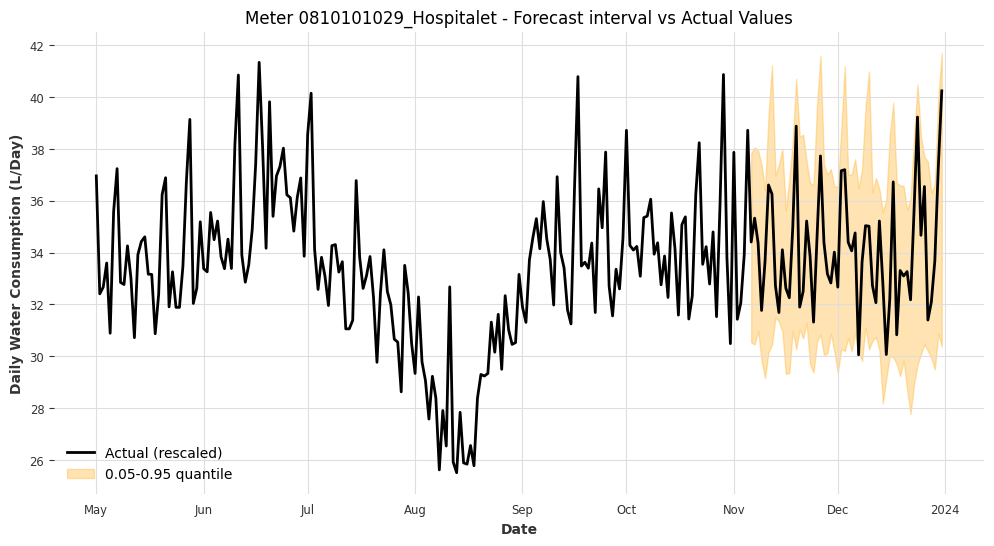

Meter 0810101029_Hospitalet - Coverage: 0.9821, Width: 7.7323



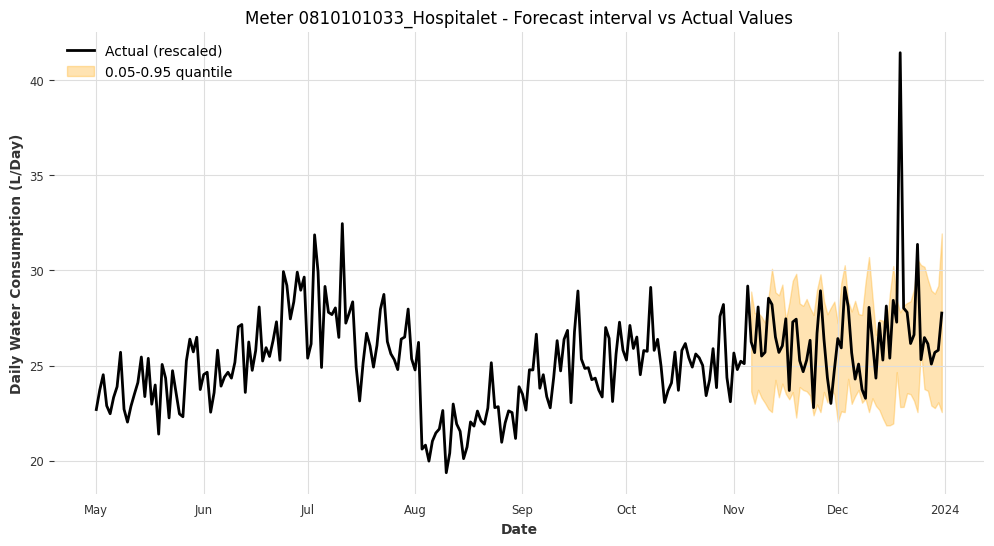

Meter 0810101033_Hospitalet - Coverage: 0.8750, Width: 5.4668



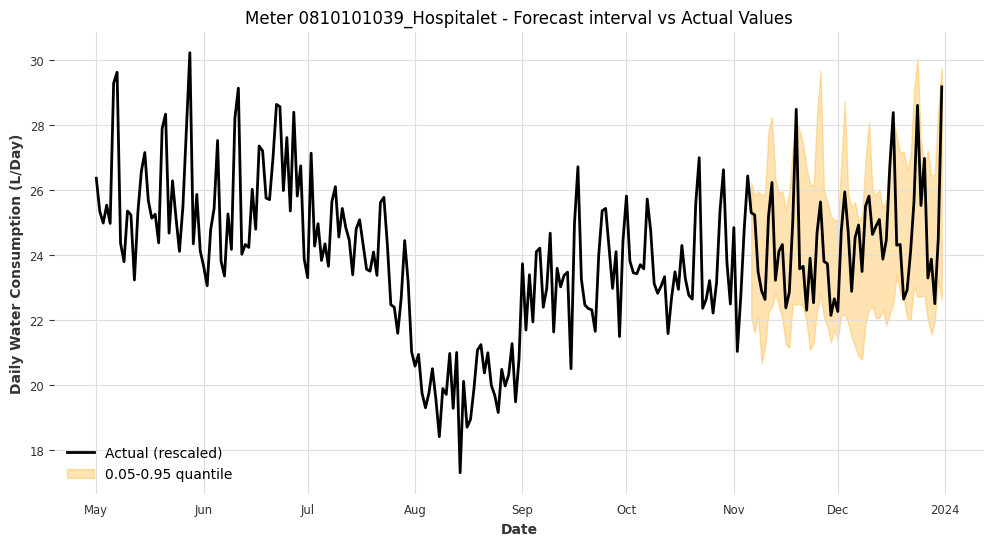

Meter 0810101039_Hospitalet - Coverage: 0.9286, Width: 4.7251



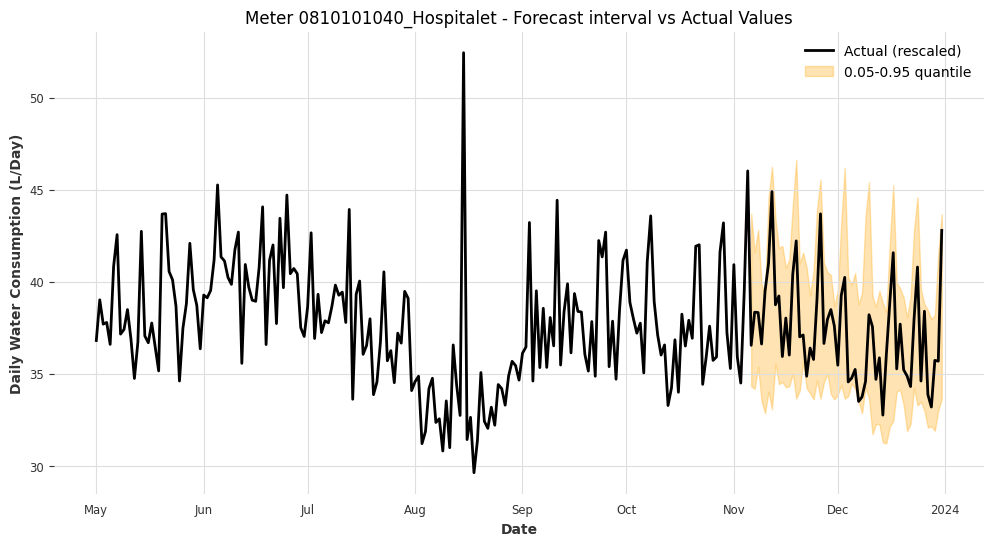

Meter 0810101040_Hospitalet - Coverage: 0.9821, Width: 7.6938



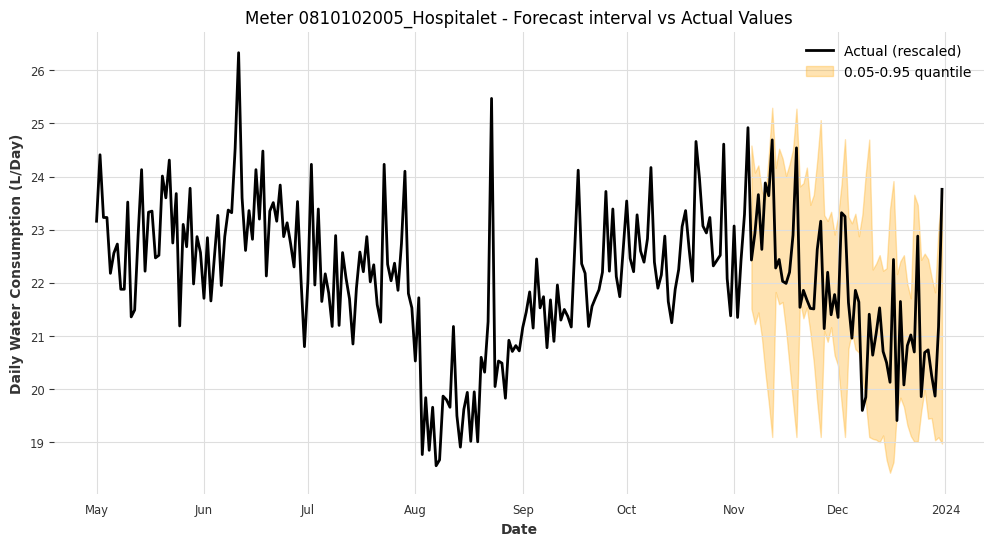

Meter 0810102005_Hospitalet - Coverage: 0.8929, Width: 3.3916



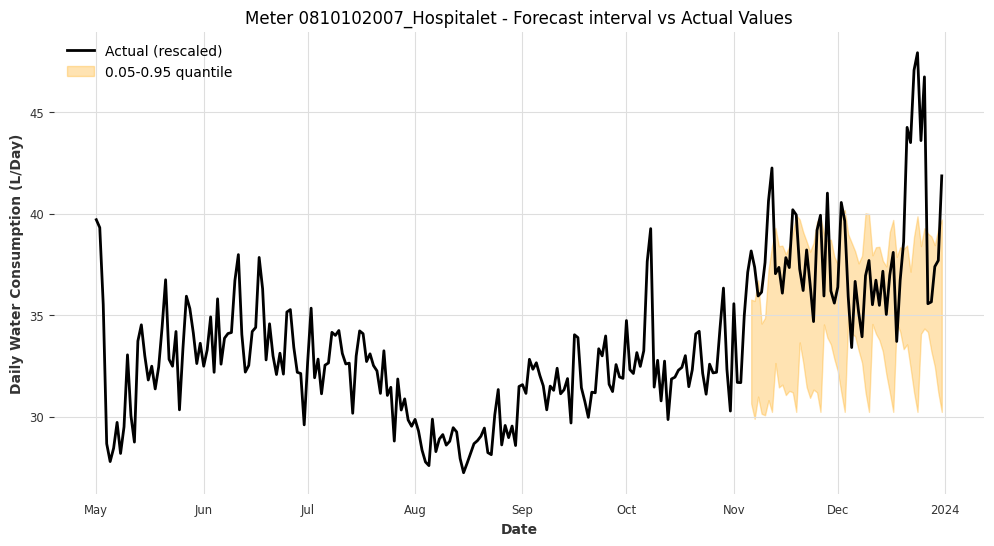

Meter 0810102007_Hospitalet - Coverage: 0.6250, Width: 6.2705



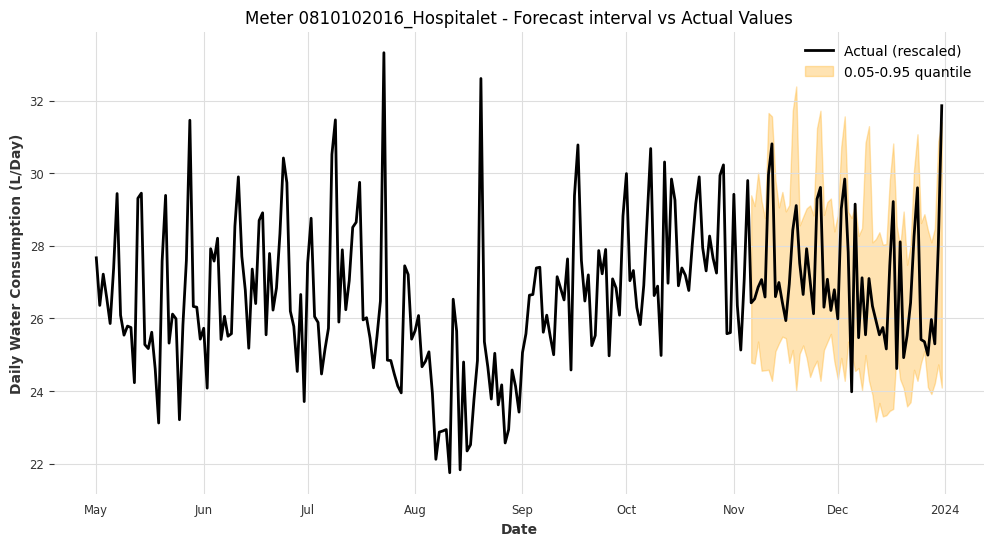

Meter 0810102016_Hospitalet - Coverage: 0.9107, Width: 4.9077



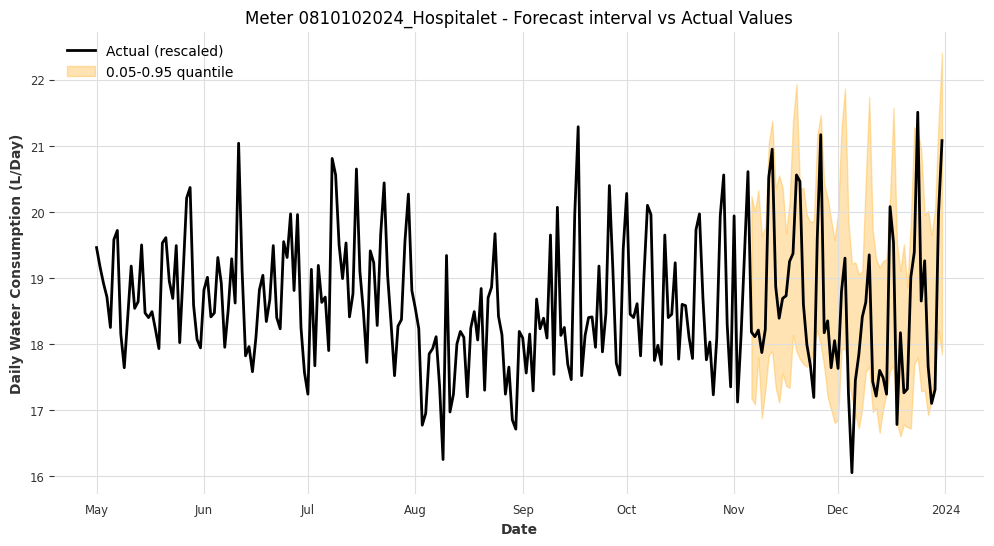

Meter 0810102024_Hospitalet - Coverage: 0.8214, Width: 2.8717



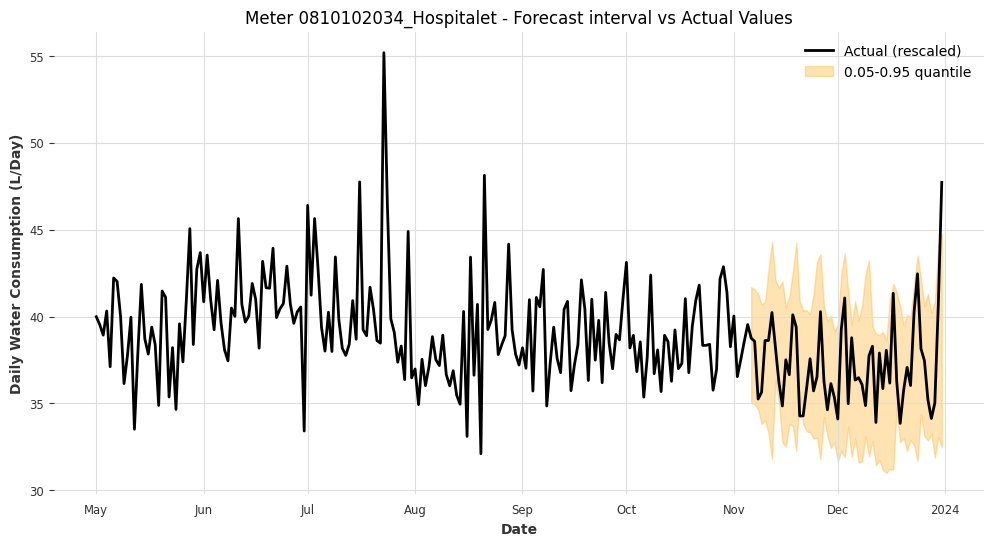

Meter 0810102034_Hospitalet - Coverage: 0.9643, Width: 8.2922



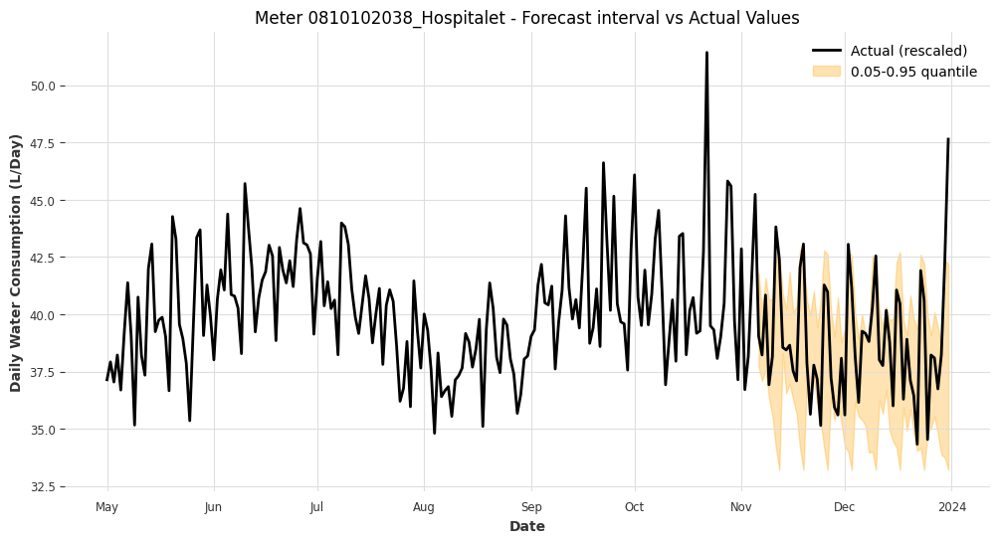

Meter 0810102038_Hospitalet - Coverage: 0.8214, Width: 5.5606



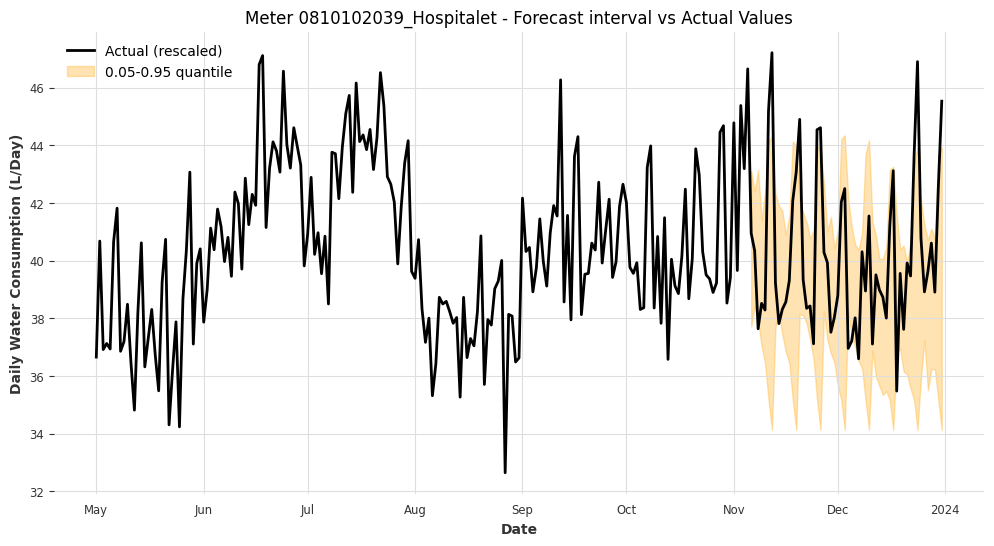

Meter 0810102039_Hospitalet - Coverage: 0.7500, Width: 5.8078



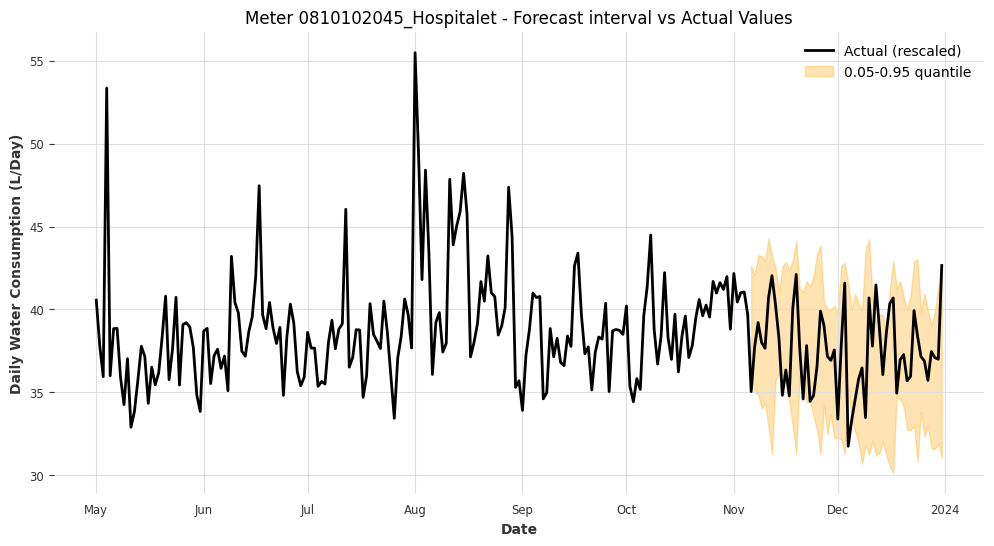

Meter 0810102045_Hospitalet - Coverage: 0.8393, Width: 8.4920



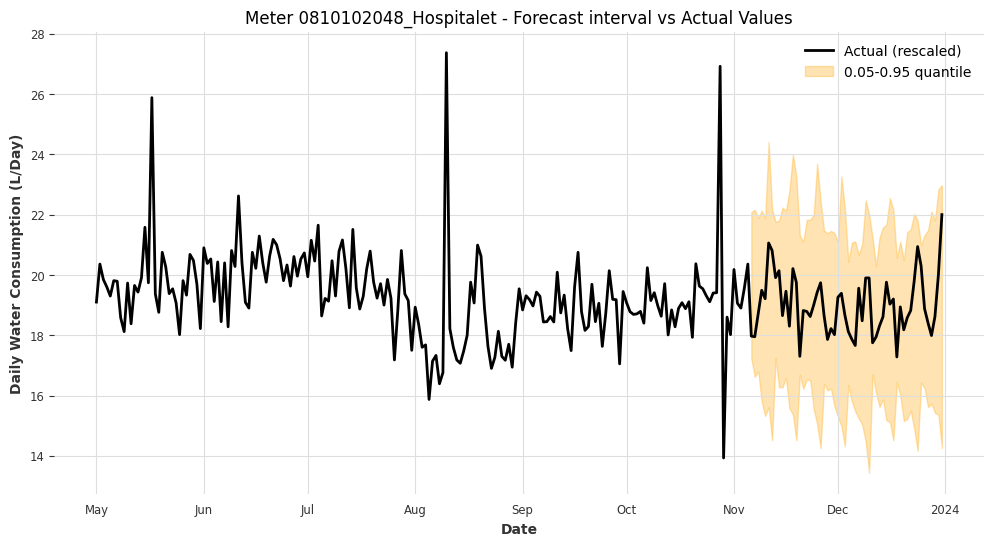

Meter 0810102048_Hospitalet - Coverage: 1.0000, Width: 6.2178



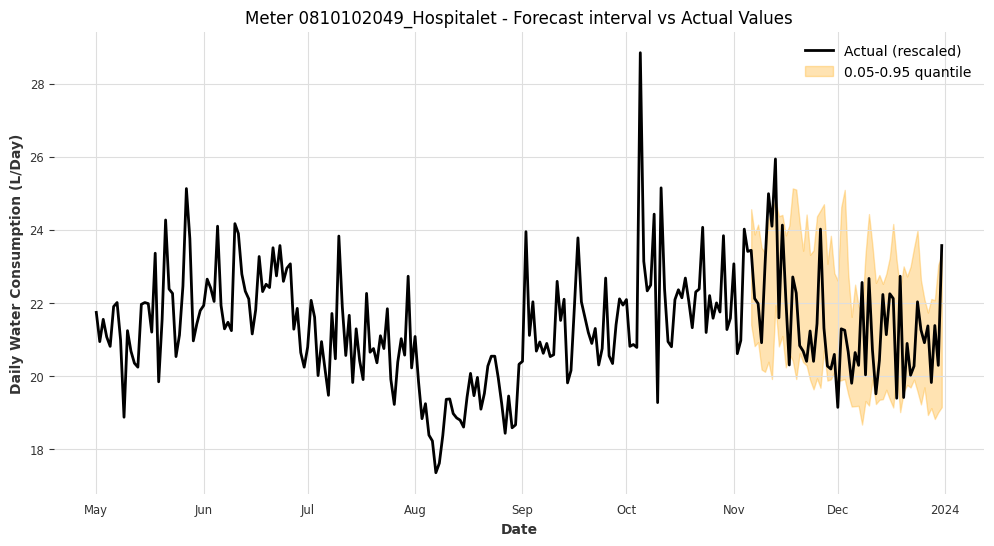

Meter 0810102049_Hospitalet - Coverage: 0.8393, Width: 3.6088



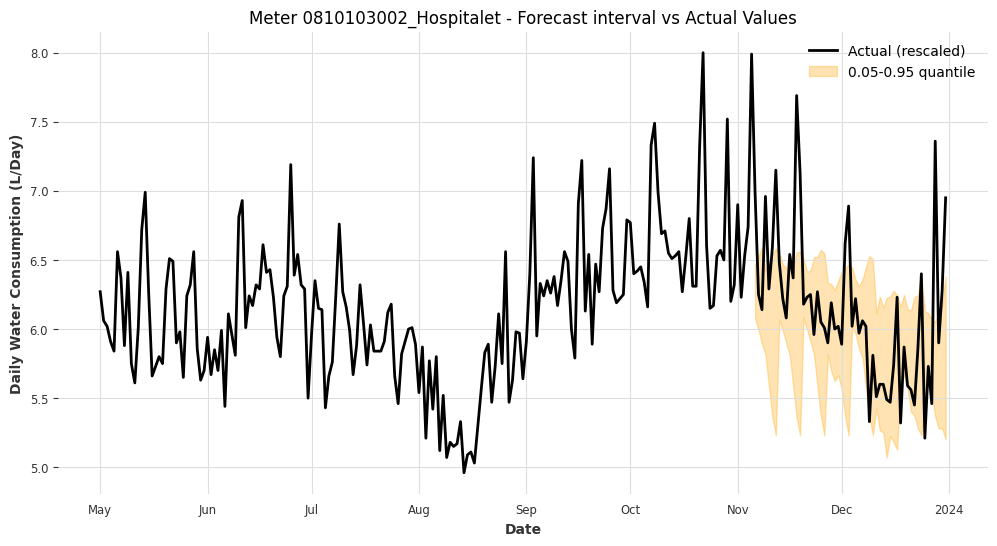

Meter 0810103002_Hospitalet - Coverage: 0.7143, Width: 0.8074



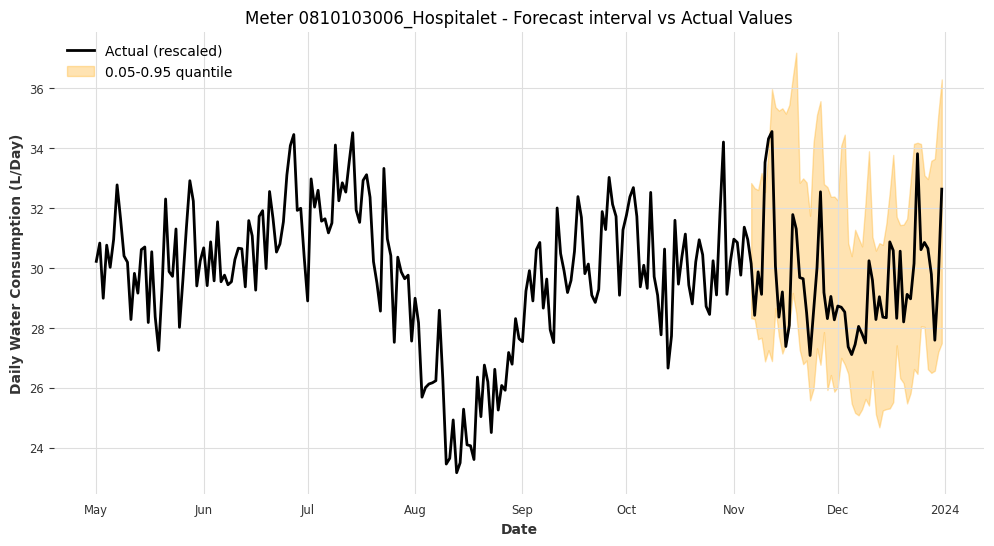

Meter 0810103006_Hospitalet - Coverage: 0.9464, Width: 6.5037



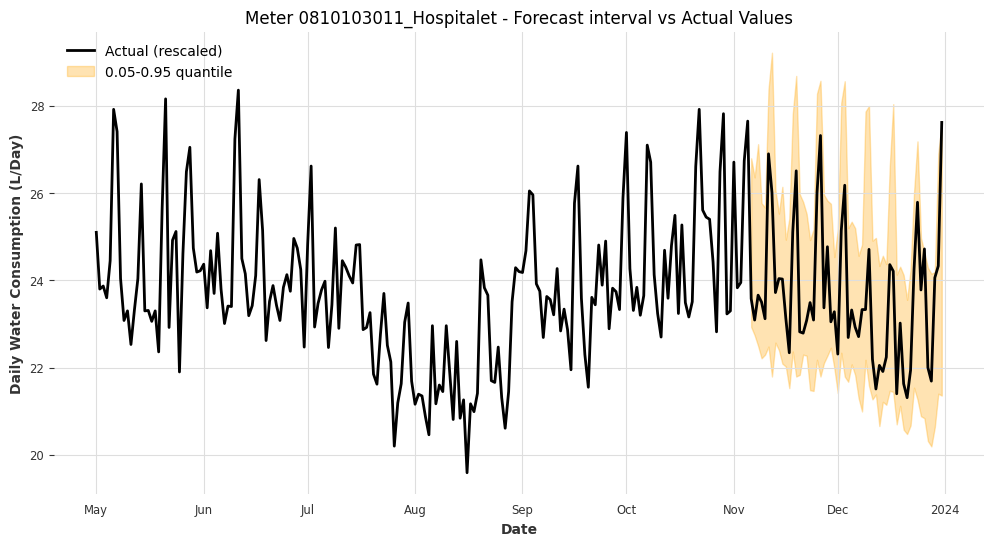

Meter 0810103011_Hospitalet - Coverage: 0.9643, Width: 4.2760



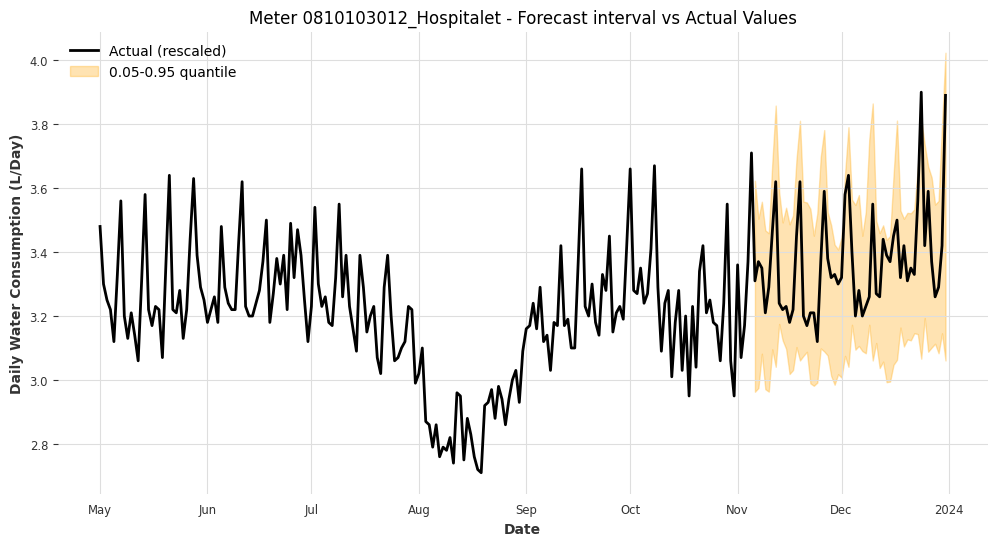

Meter 0810103012_Hospitalet - Coverage: 0.9821, Width: 0.5216



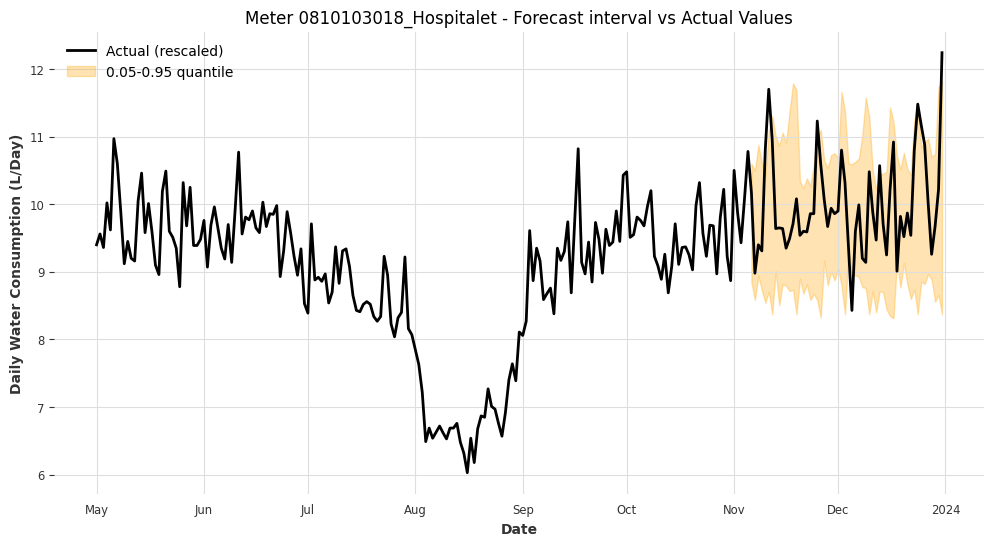

Meter 0810103018_Hospitalet - Coverage: 0.8571, Width: 2.1483



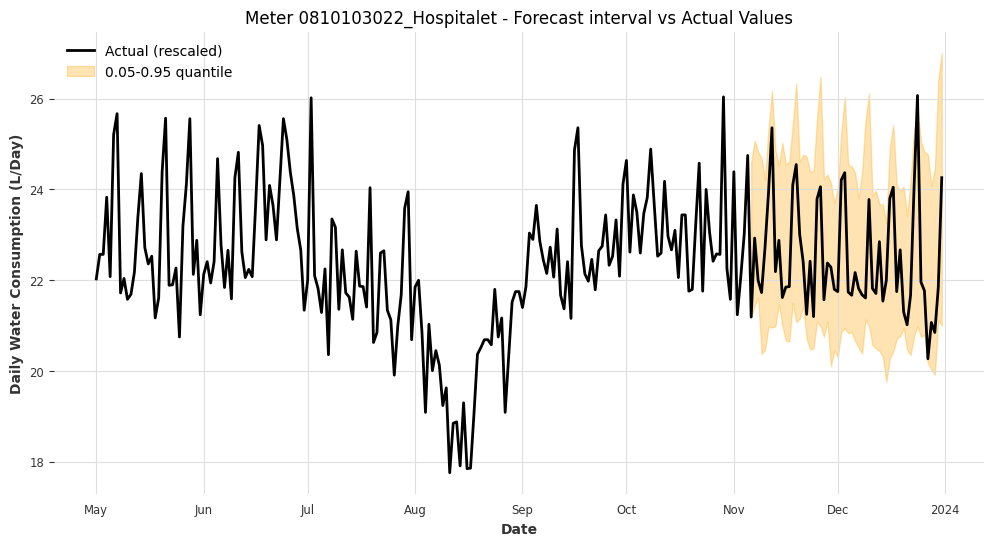

Meter 0810103022_Hospitalet - Coverage: 0.9821, Width: 4.0120



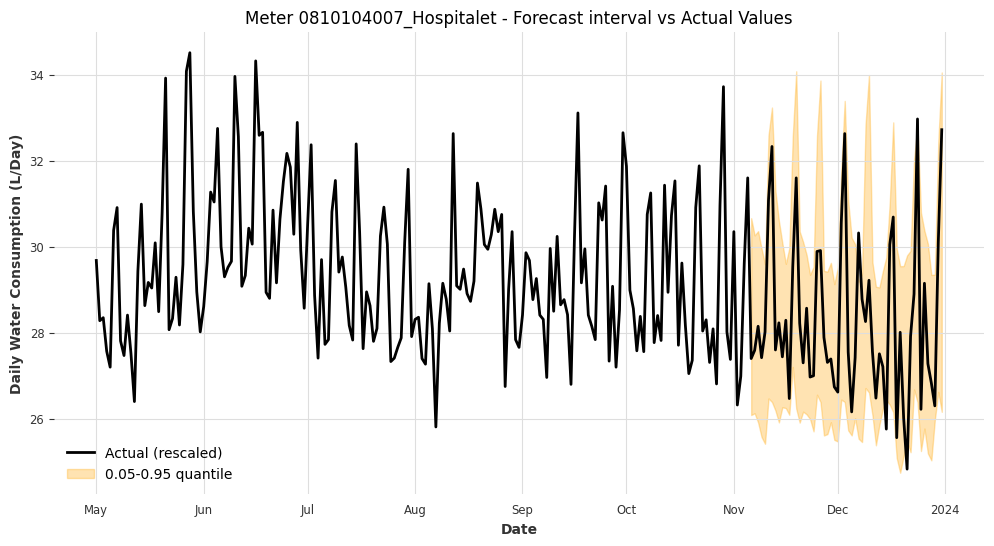

Meter 0810104007_Hospitalet - Coverage: 0.9286, Width: 4.7760



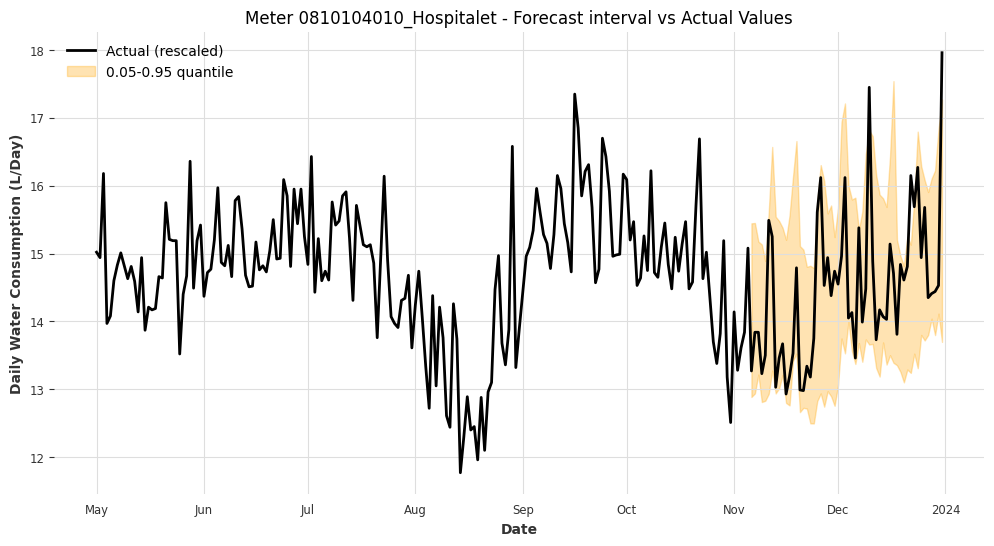

Meter 0810104010_Hospitalet - Coverage: 0.9286, Width: 2.5606



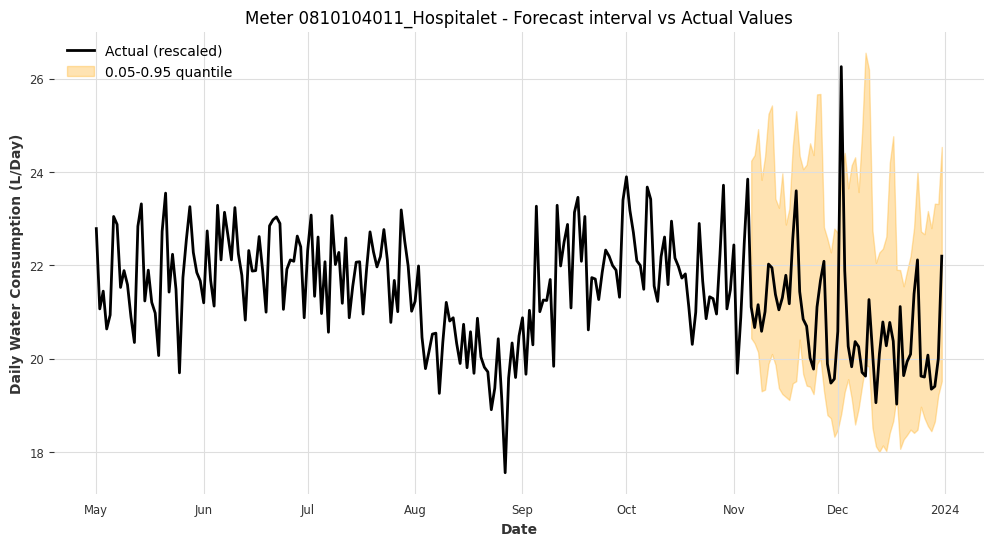

Meter 0810104011_Hospitalet - Coverage: 0.9464, Width: 4.5829



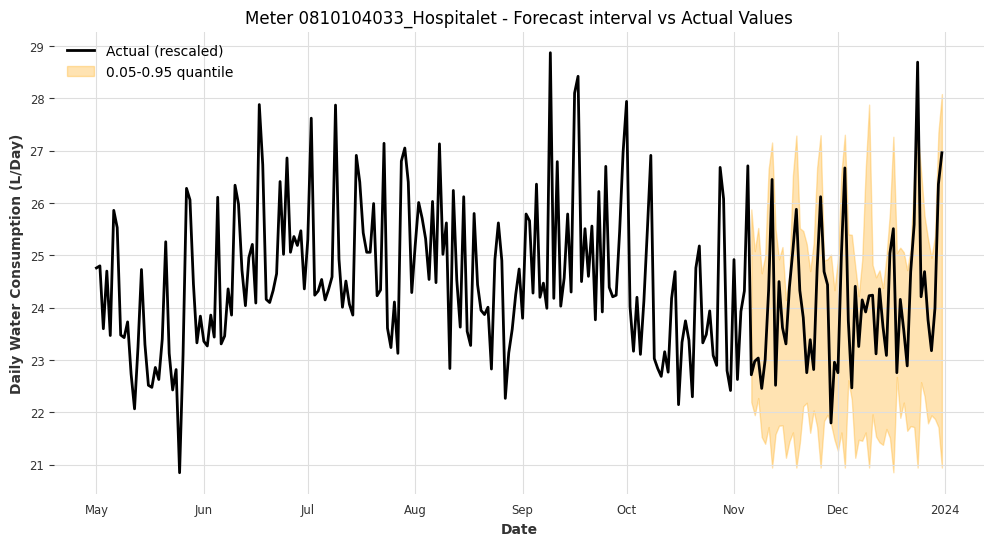

Meter 0810104033_Hospitalet - Coverage: 0.9821, Width: 3.9509



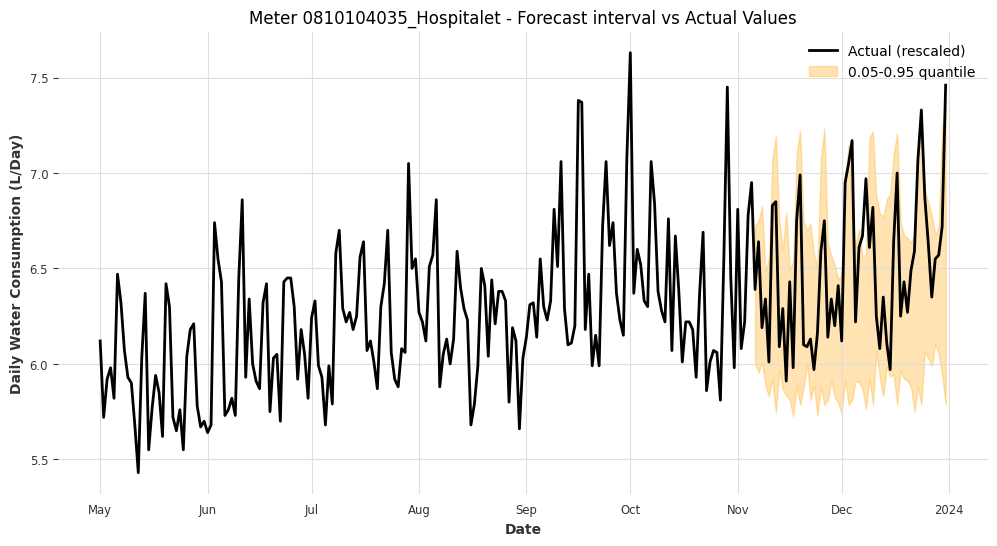

Meter 0810104035_Hospitalet - Coverage: 0.8929, Width: 0.9343



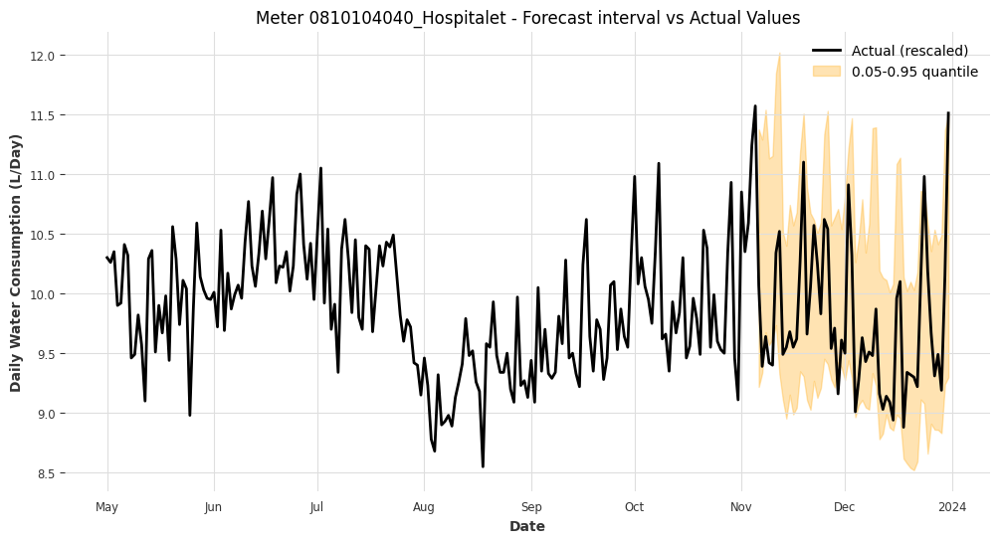

Meter 0810104040_Hospitalet - Coverage: 0.8929, Width: 1.6676



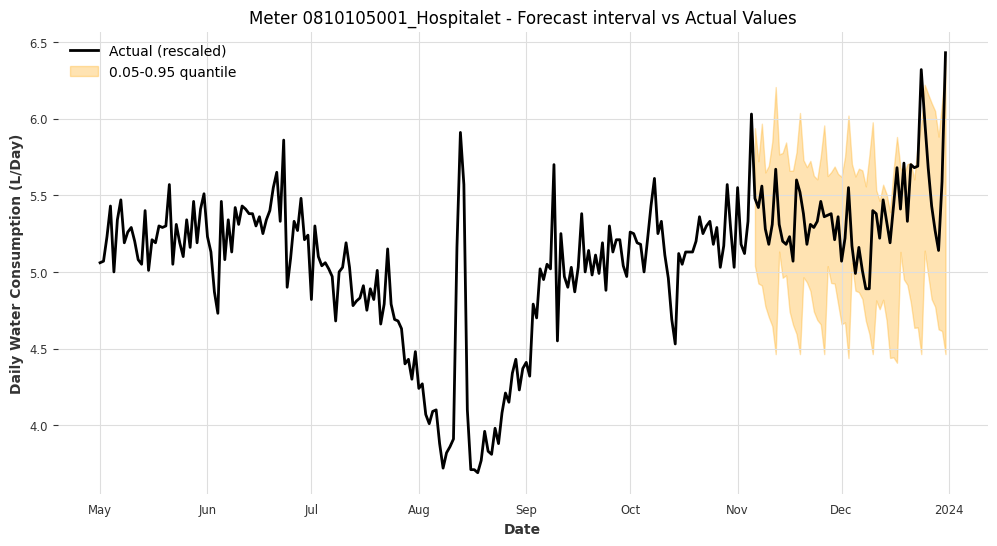

Meter 0810105001_Hospitalet - Coverage: 0.9286, Width: 1.0208



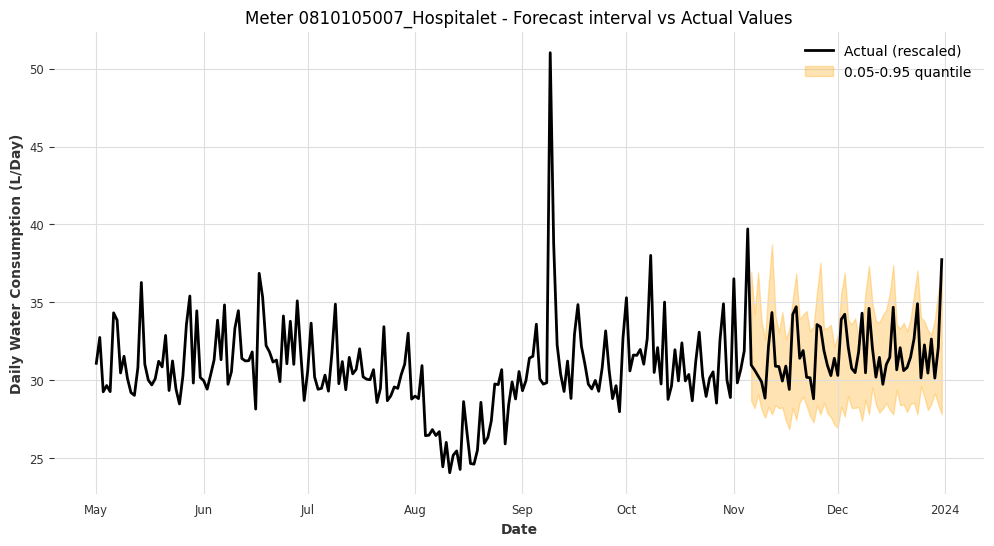

Meter 0810105007_Hospitalet - Coverage: 0.9643, Width: 6.3333



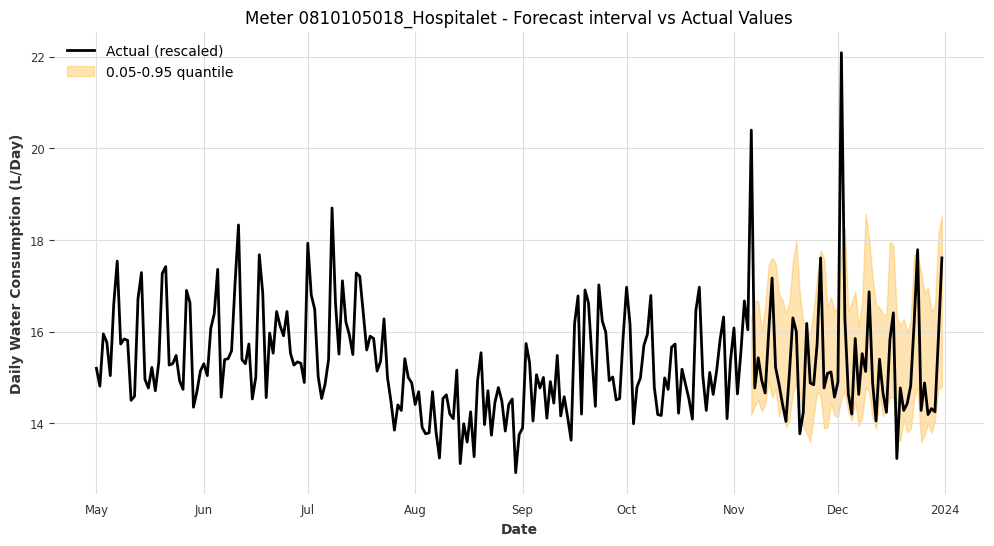

Meter 0810105018_Hospitalet - Coverage: 0.8571, Width: 2.6716



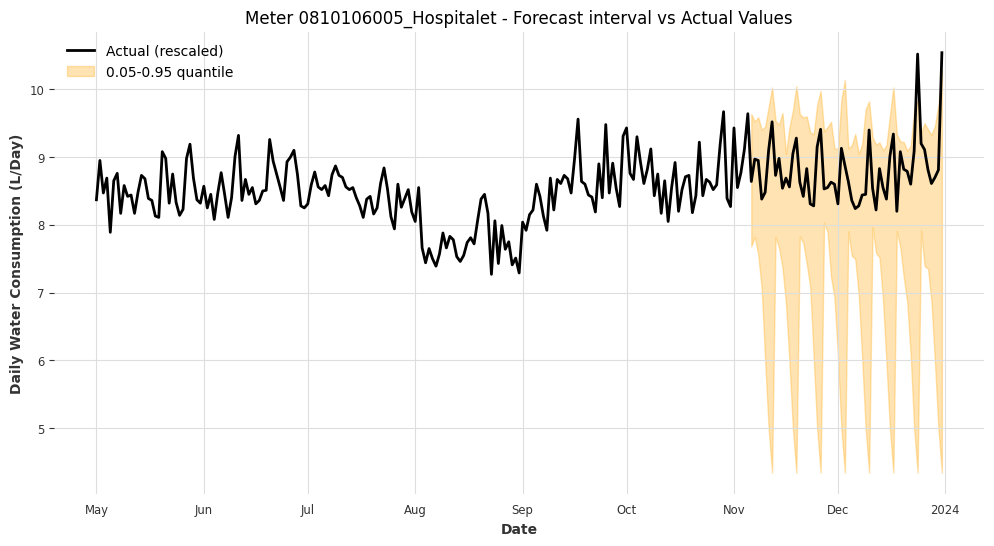

Meter 0810106005_Hospitalet - Coverage: 0.9643, Width: 3.0340



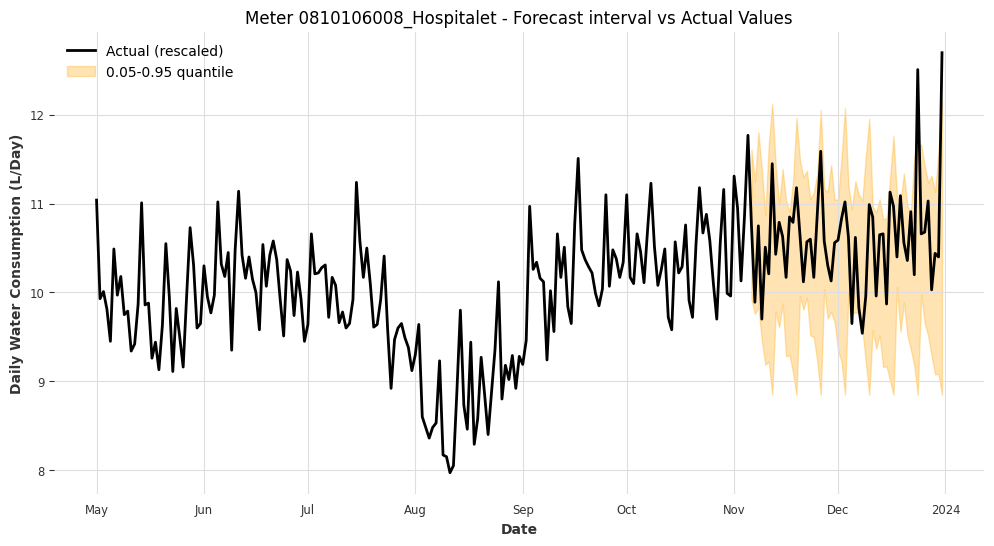

Meter 0810106008_Hospitalet - Coverage: 0.8929, Width: 1.8863



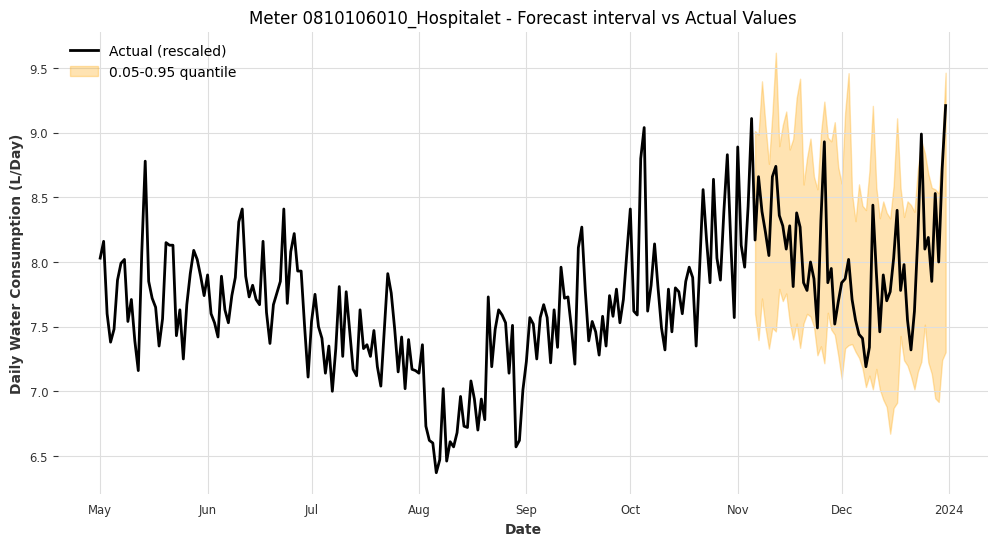

Meter 0810106010_Hospitalet - Coverage: 0.9821, Width: 1.5217



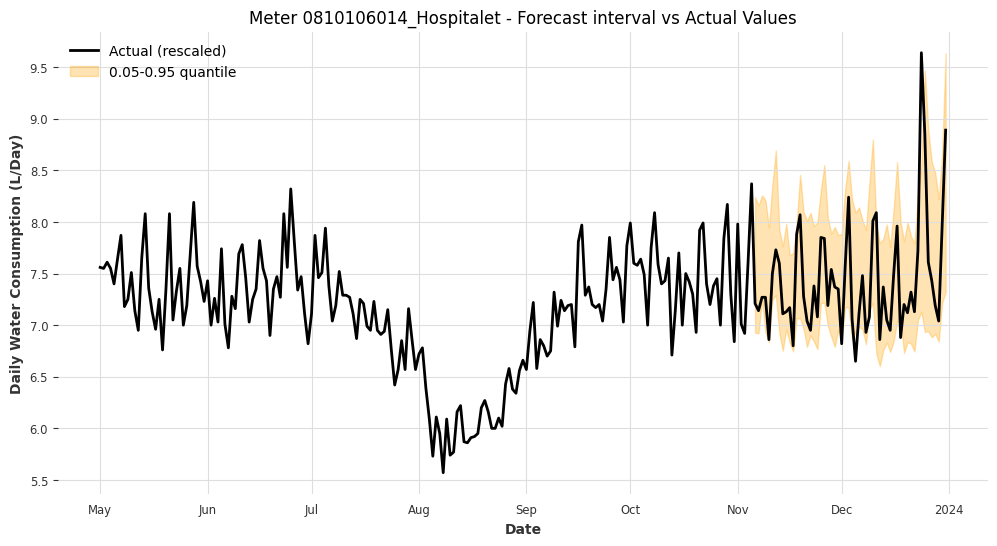

Meter 0810106014_Hospitalet - Coverage: 0.8929, Width: 1.2422



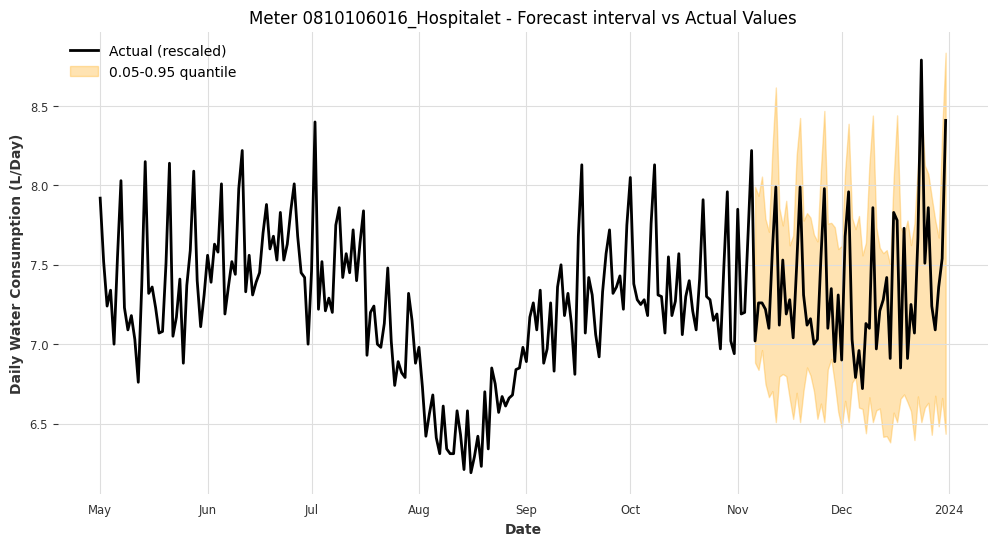

Meter 0810106016_Hospitalet - Coverage: 0.9464, Width: 1.2888



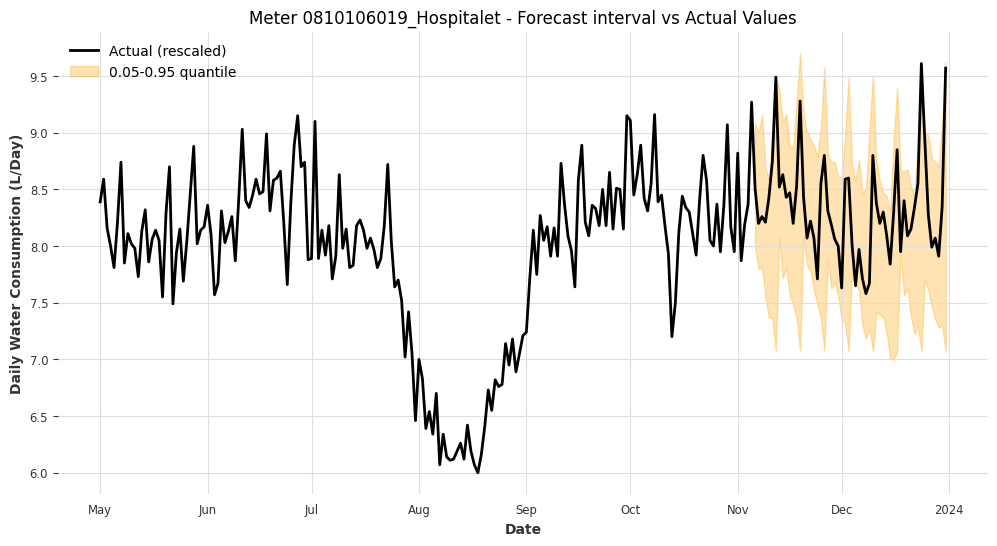

Meter 0810106019_Hospitalet - Coverage: 0.9643, Width: 1.4543



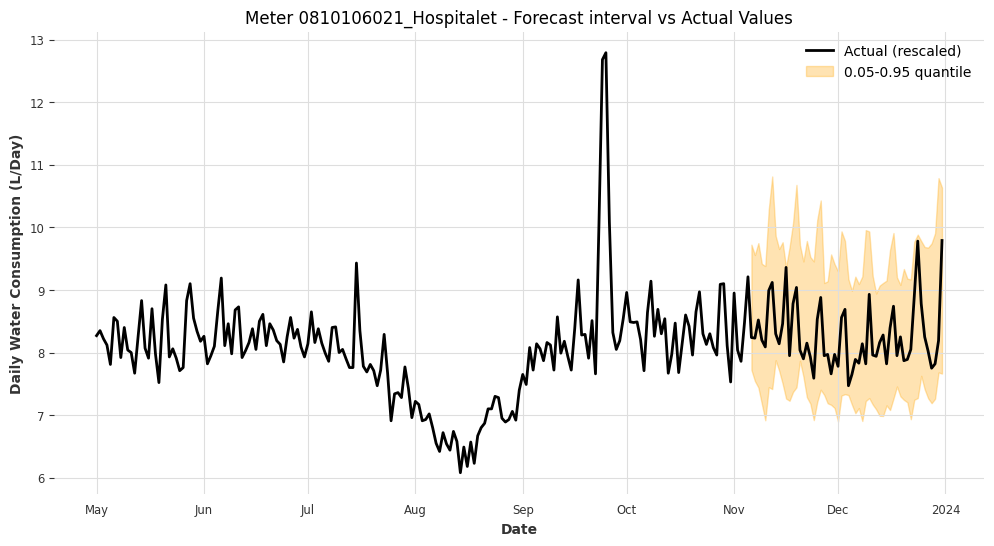

Meter 0810106021_Hospitalet - Coverage: 1.0000, Width: 2.3343



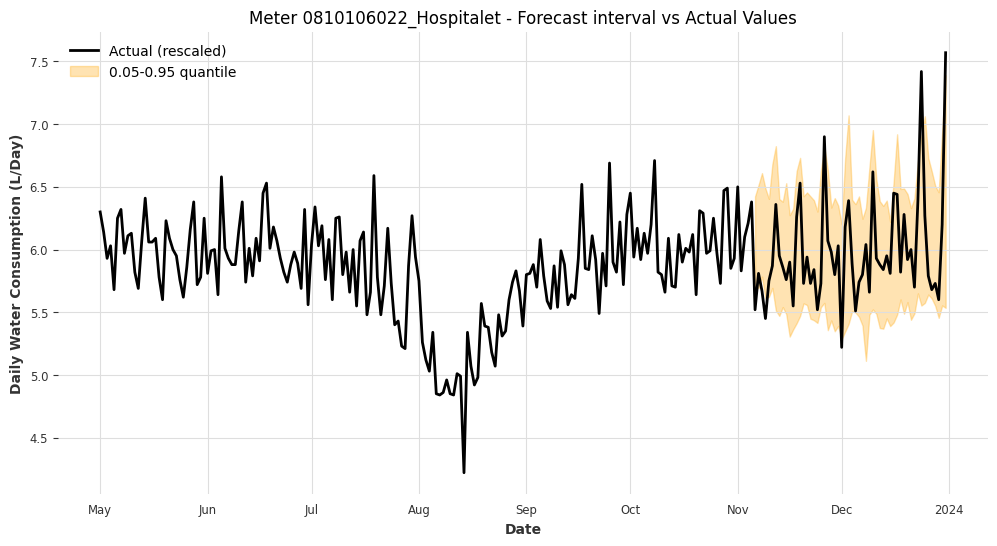

Meter 0810106022_Hospitalet - Coverage: 0.8750, Width: 1.0560



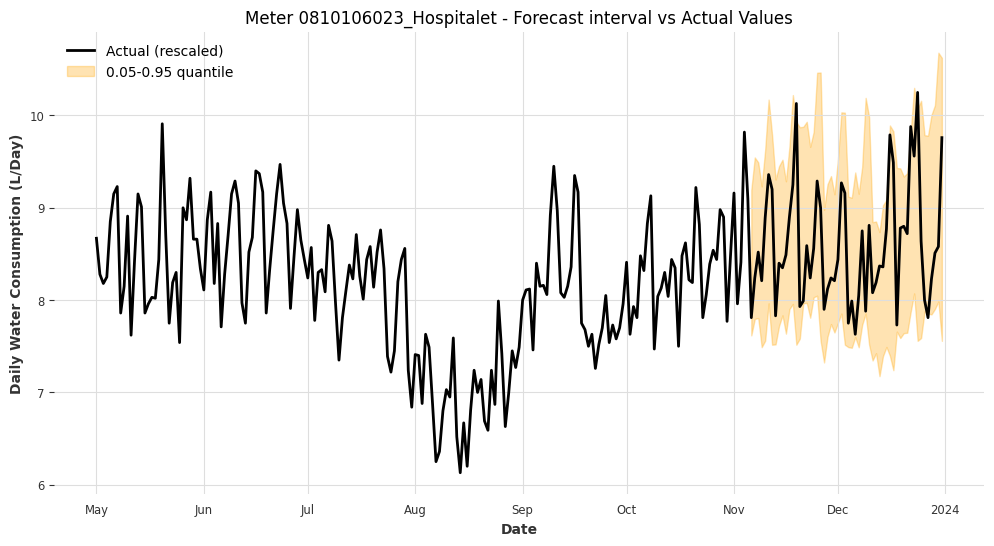

Meter 0810106023_Hospitalet - Coverage: 0.9286, Width: 1.9795



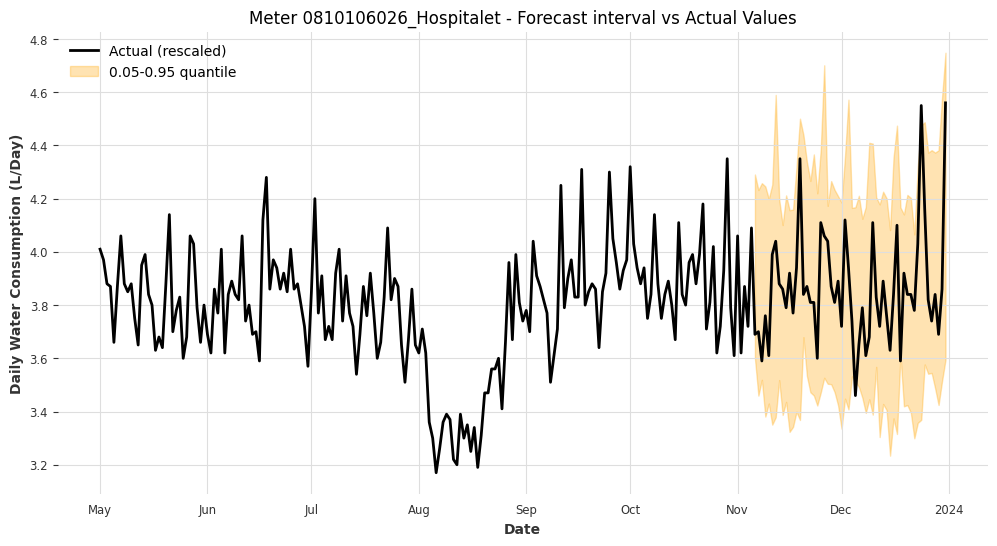

Meter 0810106026_Hospitalet - Coverage: 0.9464, Width: 0.8527



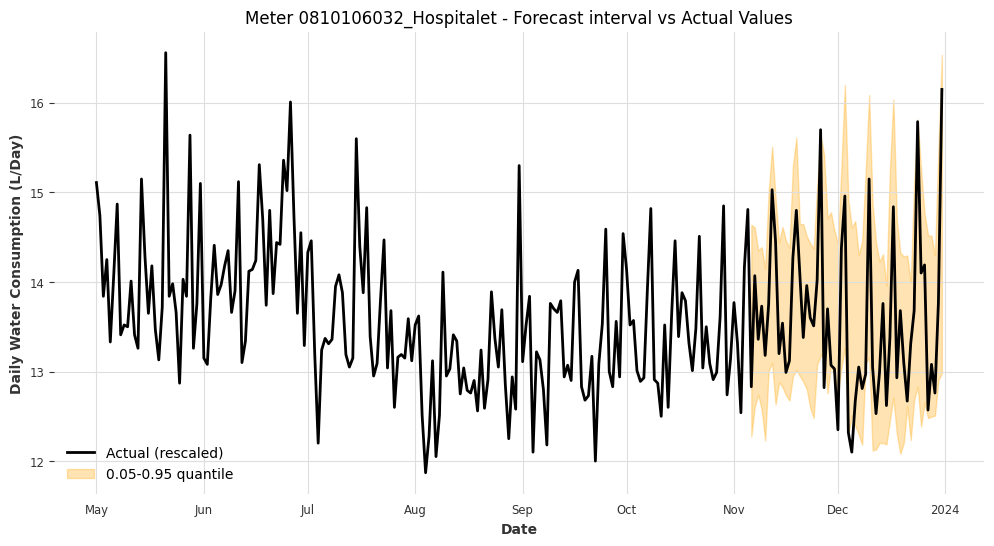

Meter 0810106032_Hospitalet - Coverage: 0.9107, Width: 2.1748



In [ ]:
import matplotlib.pyplot as plt
from darts import concatenate  # Darts utility to merge TimeSeries

for meter_id, hfcs in all_hfcs.items():
    # Get the actual time series
    ts = scaled_calib_test_series[meter_id]

    # Get scaler and results
    scaler = scalers_test[meter_id]
    df_result = all_bt_results[meter_id]
    coverage = df_result["Coverage"].iloc[0]
    width = df_result["Width rescaled"].iloc[0]

    # Start a new plot
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot actuals (rescaled)
    ts_orig = scaler.inverse_transform(ts)
    ts_orig.plot(ax=ax, label='Actual (rescaled)', lw=2)

    full_lower = []
    full_upper = []

    # Collect lower and upper quantiles from each forecast window
    for forecast in hfcs:
        if ('Consumption per meter_q0.05' in forecast.components
            and 'Consumption per meter_q0.95' in forecast.components):

            lower = forecast['Consumption per meter_q0.05']
            upper = forecast['Consumption per meter_q0.95']
            lower_orig = scaler.inverse_transform(lower)
            upper_orig = scaler.inverse_transform(upper)
            full_lower.append(lower_orig)
            full_upper.append(upper_orig)


    if full_lower and full_upper:
        # Concatenate all the TimeSeries pieces into full series
        combined_lower = concatenate(full_lower)
        combined_upper = concatenate(full_upper)

        # Plot the quantile area as a filled region
        ax.fill_between(
            combined_lower.time_index,
            combined_lower.values().flatten(),
            combined_upper.values().flatten(),
            color='orange',
            alpha=0.3,
            label='0.05-0.95 quantile'
        )

    ax.set_title(f"Meter {meter_id} - Forecast interval vs Actual Values")
    ax.set_ylabel("Daily Water Consumption (L/Day)")  # <-- Add this line

    ax.legend()
    plt.show()

    # Print the metrics below each plot
    print(f"Meter {meter_id} - Coverage: {coverage:.4f}, Width: {width:.4f}\n")